# **Inference of Cardiac Category from Biomedical Data**

## **Conclusions:**
- **E_A_ratio is the only parameter necessary to predict Cardiac Category**
    - E_A_ratio has the highest feature importance by far
    - 3 Classifiers had 100% Cross-Validation (CV) score for predicting Cardiac Category when E_A_ratio is present 
- **Removing E_A_ratio worsens model performance significantly, little to no predictive power remains.**
    - RandomForestClassifier has the best performance in this case, with CV score of 62% and MeanSquaredError of 61.64%. (Not great at all)
- **Physical functional parameters, and all other parameters, have little to no power in predicting E_A_ratio**
    - Correlation index of PhysFuncParams to E_A_ratio is low.
    - Even with ALL parameters present, scores for predicting E_A_ratio using regression is still negative for all reg models.
    - Even with hyperparameter tuning for RandomForestRegressor to predict E_A_ratio using PhysFuncParams, accuracy is still low


In [1]:
# Cell 1
"""
Ideas for a one-size-fits-all pipeline:

Check if target column is categorical or continuous
Apply from dict of classification or regression models based on above
Check if each column is categorical or continous
perform one-hot encoding for categorical columns
Apply appropriate data visualisations to each
Apply correlations Matrix
Apply scaling and PCA if too many features (>20?)

IMPORTANT: Modify pipeline such that imputation of NA values are done using median of train
set AFTER the split. Save this median for use in test set

Next steps: 
- Remove white columns (look at original excel sheet)  (Done)
- Group features by colors according to excel sheet (Done)
- Check for level of correlation (correlation matrix) (Done)
- Visualise correlation matrix (Done)
- Apply scaling (standard/minmax) (Done)
- Use PCA to reduce dimension (Skipped) https://www.datacamp.com/community/tutorials/principal-component-analysis-in-python
- Apply classification algos for each color (Done)
- Apply above for everything combined (Done)
- Implement hyperparameter tuning (Optional)
- Additional data visualisation for each parameter (Split into categorical and continous)(Optional)
- Apply unsupervised learning to check for clustering
- Cleanup
- Write clear comments for future reference
- Write and present data nicely
"""
import math
import warnings
import pandas as pd
import numpy as np
import sklearn 
import seaborn as sn
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from pathlib import Path
import os
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, cross_val_score, RepeatedStratifiedKFold, KFold, StratifiedKFold
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report,roc_curve, roc_auc_score,plot_roc_curve
from sklearn.feature_selection import RFECV
from sklearn.pipeline import Pipeline
from sklearn.svm import SVR, SVC
from sklearn.cross_decomposition import PLSRegression
from sklearn.model_selection import ShuffleSplit, GridSearchCV
from sklearn.pipeline import make_pipeline, make_union
from sklearn.linear_model import LinearRegression,LogisticRegression,SGDClassifier
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import BaggingRegressor, ExtraTreesClassifier
from sklearn.neighbors import KNeighborsRegressor,KNeighborsClassifier
from sklearn.tree import DecisionTreeRegressor,DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingRegressor,GradientBoostingClassifier, ExtraTreesClassifier
from tpot.builtins import StackingEstimator
from tpot.export_utils import set_param_recursive

import itertools
from xgboost import XGBRegressor, XGBClassifier
from sklearn.ensemble import RandomForestRegressor,RandomForestClassifier
from lightgbm import LGBMRegressor,LGBMClassifier

import seaborn as sns
import warnings
from scipy import stats
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)


data = pd.read_csv("kohsm1.csv",encoding='latin1')

#Removal of irrelevant white columns
data.drop('IDshort', axis=1, inplace=True)
data.drop('SERNO', axis=1, inplace=True)

#Full Data containing only each category as targets
data_full = data.drop('Cardiac_Category EE (0=good; 1=poor)', axis=1)
# dataEE_full = data.drop('Cardiac_Category (0=good; 1=poor)', axis=1)

#List of columns according to color category
#Blue
clinParamsCols=["IDshort","Age","Weightkg","Heightcm","Pulse","WaistCircumferencecm","SERNO","Gender","SBP","DBP","Hips_Circumference__cm","Hypertension__Yes_1_No_0","Dyslipidemia__Yes_1_No_0","Diabetes_mellitus__Yes_1_No_0","Smoking__Never_0_Current_1_Past","DiabetesmellitusDietcontrol","AlcoholNever0Current1Past"]

#Teal
exerciseCols=["PhysicalactivityfrequencyIna","IntensityTakeiteasy1Heavy","Duration15min116to30min","VO2Max"]

#Violet
echoCols=["BSA__m2","IVSD__cm","IVSS__cm","LVIDD_cm","LVIDS_cm","LVPWD_cm","LVPWS_cm","LVOT__cm","AO_cm","LA_cm","LVEF","LVFS","LVmass_echo","LVmass_index_echo","Left_atrial_volume","Left_atrial_volume_index","MV_E_peak__m_s","MV_A_peak__m_s","E_A_ratio","MV_DT__ms","PASP__mmHg","PVS__cm_s","PVD__cm_s","PVA__cm_s","PVADur","MVADur","septalS","Septal_E","Septal_A","Lateral_S","lateralE","lateralA","sinuscm","sinus_tubular_junctioncm","ave_Eprime","E_Eprime_ratio"]

#Grey
cmrCols=["LV_Mass_on_mri__g","LV_EDV","EDV067","LV_ESV","LV_SV","LVEF_A","Ss","Se","Sa","SRs","SRe","SRa","SRe_SRaratio","LVGLS","LVGCS","LVGRS","RVGLS","LAGlobalGLS","LAGlobalGCS","LAvolumeminml","LAvolumemaxml","LAEFTotal","LVMassg","LVEDVImlm2","LVESVImlm2","LVSVImlm2"]

#Beige
bloodBioCols=["MCP1pgmL","MMP9ngmL","BNP","HSTNI","GALECTIN3","sUPAR","qTL","extra_urea","extra_creatinine","extra_total_cholesterol","extra_triglycerides","extra_HDL","extra_LDL","extra_tc_HDL_ratio","extra_albumin","extra_hsCRP","HbA1c"]

#Green
physFuncParamsCols=["Gripmax","G1L","G2L","G1R","G2R","SMM","BFM","PBF","WHR","Fitness_score","BMR","Lean_LA","Lean_RA","Lean_LL","Lean_RL","Lean_T","ALM"]

#Orange
curMetaCols=["TC","FC","C2","C3","C4","C51","C5","C4OH","C6","C5OHC3DC","C4DCC6OH","C81","C8","C5DC","C81OHC61DC","C8OHC6DC","C103","C102","C101","C10","C7DC","C81DC","C8DC","C122","C121","C12","C122OHC102DC","C121OH","C12OHC10DC","C143","C142","C141","C14","C143OHC123DC","C142OH","C141OH","C14OHC12DC","C163","C162","C161","C16","C163OHC143DC","C162OH","C161OHC141DC","C16OH","C183","C182","C181","C18","C183OHC163DC","C182OHC162DC","C181OHC161DC","C18OHC16DC","C204","C203","C202","C201","C20","C203OHC183DC","C202OHC182DC","C201OHC181DC","C20OHC18DC","C225","C224","C223","C222","C221","C22","C24","C26","C28","Gly1","Ala1","Ser1","Pro1","Val1","Leu1","IleLeu1","Orn1","Met1","His1","Phe1","Arg1","Cit1","Tyr1","Asp1","Glu1","Trp1"]

#Yellow
histMetaCols=["HistoC2","HistoC3","HistoC4","HistoC51","HistoC5","HistoC4NDOH","HistoC6","HistoC5NDOHC3NDDC","HistoC4NDDCC6NDOH","HistoC81","HistoC8","HistoC5NDDC","HistoC81NDOHC61NDDC","HistoC8NDOHC6NDDC","HistoC103","HistoC102","HistoC101","HistoC10","HistoC7NDDC","HistoC81NDDC","HistoC8NDDC","HistoC122","HistoC121","HistoC12","HistoC122NDOHC102NDDC","HistoC121NDOH","HistoC12NDOHC10NDDC","HistoC143","HistoC142","HistoC141","HistoC14","HistoC143NDOHC123NDDC","HistoC142NDOH","HistoC141NDOH","HistoC14NDOHC12NDDC","HistoC163","HistoC162","HistoC161","HistoC16","HistoC163NDOHC143NDDC","HistoC162NDOH","HistoC161NDOHC141NDDC","HistoC16NDOH","HistoC183","HistoC182","HistoC181","HistoC18","HistoC183NDOHC163NDDC","HistoC182NDOHC162NDDC","HistoC181NDOHC161NDDC","HistoC18NDOHC16NDDC","HistoC204","HistoC203","HistoC202","HistoC201","HistoC20","HistoC203NDOHC183NDDC","HistoC202NDOHC182NDDC","HistoC201NDOHC181NDDC","HistoC20NDOHC18NDDC","HistoC225","HistoC224","HistoC223","HistoC222","HistoC221","HistoC22","HistoC24","HistoC26","HistoC28","HistoCode","HistoGly1_ConcµM","HistoAla1_ConcµM","HistoSer1_ConcµM","HistoPro1_ConcµM","HistoVal1_ConcµM","HistoLeu1_ConcµM","HistoIle1_ConcµM","HistoOrn1_ConcµM","HistoMet1_ConcµM","HistoHis1_ConcµM","HistoPhe1_ConcµM","HistoCit1_ConcµM","HistoTyr1_ConcµM","HistoAsp1_ConcµM","HistoGlu1_ConcµM","HistoTrp1_ConcµM"]

targets=["Cardiac_Category (0=good; 1=poor)","Cardiac_Category EE (0=good; 1=poor)"]

# List comprising of params and Cardiac Category
clinParamsColsCC = clinParamsCols + [targets[0]] 
exerciseColsCC = exerciseCols + [targets[0]]
echoColsCC = echoCols + [targets[0]]
cmrColsCC = cmrCols + [targets[0]]
bloodBioColsCC = bloodBioCols + [targets[0]]
physFuncParamsColsCC = physFuncParamsCols + [targets[0]]
curMetaColsCC = curMetaCols + [targets[0]]
histMetaColsCC = histMetaCols + [targets[0]]

# List comprising of params and Cardiac Category_EE
"""
clinParamsColsCCEE = clinParamsCols + [targets[1]] 
histMetaColsCCEE = histMetaCols + [targets[1]]
exerciseColsCCEE = exerciseCols + [targets[1]]
echoColsCCEE = echoCols + [targets[1]]
cmrColsCCEE = cmrCols + [targets[1]]
bloodBioColsCCEE = bloodBioCols + [targets[1]]
physFuncParamsColsCCEE = physFuncParamsCols + [targets[1]]
curMetaColsCCEE = curMetaCols + [targets[1]]
"""
# https://stackoverflow.com/questions/48198021/filter-pandas-dataframe-with-specific-column-names-in-python

#Dataframe containing parameters and Cardiac Category
clinParamsColsCC_df=data.loc[:, data.columns.isin(clinParamsColsCC)]
exerciseColsCC_df=data.loc[:, data.columns.isin(exerciseColsCC)]
echoColsCC_df=data.loc[:, data.columns.isin(echoColsCC)]
cmrColsCC_df=data.loc[:, data.columns.isin(cmrColsCC)]
bloodBioColsCC_df=data.loc[:, data.columns.isin(bloodBioColsCC)]
physFuncParamsColsCC_df=data.loc[:, data.columns.isin(physFuncParamsColsCC)]
curMetaColsCC_df=data.loc[:, data.columns.isin(curMetaColsCC)]
histMetaColsCC_df=data.loc[:, data.columns.isin(histMetaColsCC)]

#Dataframe containing parameters and Cardiac CategoryEE
""" 
clinParamsColsCCEE_df=data.loc[:, data.columns.isin(clinParamsColsCCEE)] 
exerciseColsCCEE_df=data.loc[:, data.columns.isin(exerciseColsCCEE)]
echoColsCCEE_df=data.loc[:, data.columns.isin(echoColsCCEE)]
cmrColsCCEE_df=data.loc[:, data.columns.isin(cmrColsCCEE)]
bloodBioColsCCEE_df=data.loc[:, data.columns.isin(bloodBioColsCCEE)]
physFuncParamsColsCCEE_df=data.loc[:, data.columns.isin(physFuncParamsColsCCEE)]
curMetaColsCCEE_df=data.loc[:, data.columns.isin(curMetaColsCCEE)]
histMetaColsCCEE_df=data.loc[:, data.columns.isin(histMetaColsCCEE)]
 """
#Dict of dataframes of each color cateogry for cardiac category
cc_dfDict = {
    "clinParams":clinParamsColsCC_df,
    "exercise":exerciseColsCC_df,
    "echo":echoColsCC_df,
    "cmr":cmrColsCC_df,
    "bloodBio":bloodBioColsCC_df,
    "physFuncParams":physFuncParamsColsCC_df,
    "curMeta":curMetaColsCC_df,
    "histMeta":histMetaColsCC_df
}

#Dict of dataframes of each color cateogry for cardiac category EE
""" 
ccee_dfDict = {
    "clinParams":clinParamsColsCCEE_df,
    "exercise":exerciseColsCCEE_df,
    "echo":echoColsCCEE_df,
    "cmr":cmrColsCCEE_df,
    "bloodBio":bloodBioColsCCEE_df,
    "physFuncParams":physFuncParamsColsCCEE_df,
    "curMeta":curMetaColsCCEE_df,
    "histMeta":histMetaColsCCEE_df
}
"""

for key in cc_dfDict:
    print(f"Shape of {key}: {cc_dfDict[key].shape}")

""" 
for key in ccee_dfDict:
    print(f"Shape of {key+'(EE)'}: {cc_dfDict[key].shape}") 
"""

Shape of clinParams: (86, 16)
Shape of exercise: (86, 5)
Shape of echo: (86, 37)
Shape of cmr: (86, 27)
Shape of bloodBio: (86, 18)
Shape of physFuncParams: (86, 18)
Shape of curMeta: (86, 89)
Shape of histMeta: (86, 87)


' \nfor key in ccee_dfDict:\n    print(f"Shape of {key+\'(EE)\'}: {cc_dfDict[key].shape}") \n'

In [2]:
# Cell 2
#https://stackoverflow.com/questions/45515031/how-to-remove-columns-with-too-many-missing-values-in-python
"""

def missing(dff):
    print (round((dff.isnull().sum() * 100/ len(dff)),2).sort_values(ascending=False))
"""

# Helper function
def rmissingvaluecol(df, threshold,verbose=False):
    # If threshold is 80 it means we are going to drop columns having more than 80% of missing values
    l = []
    l = list(df.drop(df.loc[:,list((100*(df.isnull().sum()/len(df.index)) >= threshold))].columns, 1).columns.values)
    if verbose:
        print("Number of columns having more than %s percent missing values: "%threshold, (df.shape[1] - len(l)))
        print("These columns are:\n", list(set(list((df.columns.values))) - set(l)))
    # Returns columns that are missing less than threshold % of data
    return l
    
def preprocessDf(df,threshold=15,verbose=False):
    if verbose:
        print("Preprocessing dataframe...")
    originalShape = df.shape
    newDf = df.copy()
    
    for col in newDf:
        #Checks for categorical columns that only have 2 values, and converts them to binary
        uniqueVals = pd.unique(newDf[col])
        if len(uniqueVals) == 2:
            if not(np.int64(0) in uniqueVals and np.int64(1) in uniqueVals):
                if verbose:
                    print(f"{col} column contains only 2 values. Converting to binary")
                    print(uniqueVals[0])
                newDf[col] = np.where(newDf[col] == uniqueVals[0],np.int64(0),newDf[col])
                newDf[col] = np.where(newDf[col] == uniqueVals[1],np.int64(1),newDf[col])
                #Renames column with labels for binary values
                newDf.rename(columns={col:col + f"_{uniqueVals[0]}_0_{uniqueVals[1]}_1"}, inplace=True)
    
    # Converting values that are non-numeric to NA
    newDf = newDf.apply(pd.to_numeric,errors='coerce')
    if verbose:
        print("Converting values that are non-numeric AND non-binary to NaN...")
    newCols = rmissingvaluecol(newDf,threshold,verbose=verbose) #Removes columns with more than threshold of missing data
    if verbose:
        print("Columns with missing values (%):")
    newDf_missing = newDf.isna().sum()
    newDf_missing = newDf_missing[newDf_missing > 0].dropna().sort_values(ascending=False)
    newDf_missing = newDf_missing.apply(lambda x: np.round((x/originalShape[0])*100,2))
    if verbose:
        print(newDf_missing)
    newDf = newDf[newCols]

    if verbose:
        print(f"Original Shape:{df.shape}")
        print(f"Final Shape:{newDf.shape}")
        print("______________________________")
    return newDf

#https://stackoverflow.com/questions/17778394/list-highest-correlation-pairs-from-a-large-correlation-matrix-in-pandas
# Helper function for get_top_abs_correlations. returns list of redundant pairs to be dropped
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

# Function that returns a table of correlation indexes in descending order
def get_top_abs_correlations(df, threshold=0.6):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[au_corr>=threshold]


# Because of mixed data type (Binary and Non-binary), it would probably be 
# more correct to use Factor analysis of mixed data (FAMD) instead of simple PCA. 
# https://github.com/MaxHalford/prince#factor-analysis-of-mixed-data-famd

# Function currently not being used
def scaleAndPca(df,target,explainabilityThreshold = 0.85):
    #print(df)
    # Removes target column
    newDf = df.drop([target], axis=1)
    
    featuresLength = newDf.shape[1]
    
    """
    nonBinary = newDf.columns[~newDf.isin([0,1]).all()]
    binary = newDf.columns[newDf.isin([0,1]).all()]
    """
    scaler = StandardScaler()
    scaler.fit(newDf)
    
    newDf = scaler.transform(newDf)
    # https://towardsdatascience.com/one-hot-encoding-standardization-pca-data-preparation-steps-for-segmentation-in-python-24d07671cf0b
    # Loop Function to identify number of principal components that explain at least threshold% of the variance
    for comp in range(1, featuresLength):
        pca = PCA(n_components= comp, random_state=1)
        pca.fit(newDf)
        comp_check = pca.explained_variance_ratio_
        final_comp = comp
        if comp_check.sum() > explainabilityThreshold:
            break 
    Final_PCA = PCA(n_components= final_comp,random_state=1)
    Final_PCA.fit(newDf)
    cluster_newDf = Final_PCA.transform(newDf)
    cluster_newDf = pd.DataFrame(cluster_newDf) 
    combinedDf = pd.concat([cluster_newDf, df[target]], axis=1)
    num_comps = comp_check.shape[0]
    print(f"Reducing {featuresLength} features to {final_comp} components, we can explain {comp_check.sum()}% of the variability in the original data.")
    return combinedDf

#scaleAndPca(cc_dfDictNew["clinParams"],"Cardiac_Category (0=good; 1=poor)")


In [3]:
# Cell 3
# Display correlation data above given threshold
def outputCorrData(df,threshold=0.6,filename="Output",generateFiles=False):
    df = preprocessDf(df)
    df = df.fillna(df.median())
    # Creates correlation matrix
    corrDf = df.corr()
    # Creates corr matrix, showing correlations above given threshold
    filteredDf = corrDf[((corrDf >= threshold) | (corrDf <= -threshold)) & (corrDf !=1.000)]
    plt.figure(figsize=(20,17))
    sn.heatmap(filteredDf, annot=True, cmap="Reds")
    plt.title(f"{filename} Correlation Heatmap (Threshold: >= abs{threshold})",fontsize=20)
    # Returns a table of correlation indexes in descending order
    
    cmrCorrTable = get_top_abs_correlations(df, threshold).to_frame()
    cmrCorrTable.columns =['Abs Corr Idx']
    plt.show

    # Generates excel and png files of output in your system for future reference
    if generateFiles:
        if not os.path.exists('Outputs/Plots'):
            os.makedirs('Outputs/Plots')
        if not os.path.exists('Outputs/Tables'):
            os.makedirs('Outputs/Tables')
        plt.savefig(f'Outputs/Plots/corr_{filename}_heatmap.png')
        cmrCorrTable.to_excel(f'Outputs/Tables/corr_{filename}_table.xlsx') 
    return corrDf

def plot_feature_importance(importance,names,title,saveFile=False):
    # Adapted from https://www.analyseup.com/learn-python-for-data-science/python-random-forest-feature-importance-plot.html
    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)

    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)

    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)

    #Define size of bar plot
    plt.figure(figsize=(10,8))
    #Plot Searborn bar chart
    sn.barplot(x=fi_df['feature_importance'][:20], y=fi_df['feature_names'][:20])
    
    #Add chart labels
    plt.title(title)
    plt.xlabel('Feature Importance')
    plt.ylabel('Feature Names')
    print(f"Top 10 features: {list(fi_df['feature_names'][:10])}")
    if saveFile:
        plt.savefig(f'Outputs/FeatureImportanceFigures/{title}.png')
    plt.show()
    return fi_df # returns full feature importance dataframe

#https://analyticsindiamag.com/how-to-implement-ml-models-with-small-datasets/

# https://stats.stackexchange.com/questions/416553/can-k-fold-cross-validation-cause-overfitting#:~:text=2%20Answers&text=K%2Dfold%20cross%20validation%20is,fold%20cross%2Dvalidation%20removes%20overfitting.

# Adapted from https://www.kaggle.com/brsdincer/heart-attack-prediction-detailed-explanation

# k-fold CV is used to DETECT overfitting, since it trains the model from scratch each time 


def compareClasModelVer2(df,target,test_size=0.25,title="Dataset",showImportance=False,confusionMatrix=False,key="",saveFile=False):
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df,verbose=True)
    # Note here that imputation in this manner would lead to some data leakages into the test set
    # during the cross validation process. Data for imputation should ideally be confined to
    # the train set within each fold. 
    # However, for sake of expediency, I am just going to impute using the whole data
    imputedX = x.fillna(x.median())
    print("Initialising models...")
    #xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=1)
    #xTrain = xTrain.fillna(xTrain.median())
    #xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

    lr = LogisticRegression()
    gnb = GaussianNB()
    knnc = KNeighborsClassifier()
    dtc = DecisionTreeClassifier(random_state=1)
    rfc = RandomForestClassifier(random_state=1,verbose=False)
    gbmc = GradientBoostingClassifier(verbose=False)
    xgbc = XGBClassifier(eval_metric="auc")
    lgbmc = LGBMClassifier()
    sv = SVC()

    models = [lr,gnb,knnc,dtc,rfc,gbmc,xgbc,lgbmc,sv]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        #model = model.fit(imputedX,y)
        #yPred = model.predict(xTest)

        #accuracy = accuracy_score(yTest,yPred)

        #confusionMatrixArray = confusion_matrix(yTest, predict)
        #plt.figure()
        #plot_roc_curve(model, xTest, yTest)  
        #plt.show()
        
        #imputedX = x.fillna(x.median())
        cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)

        cvAccuracyScore = cross_val_score(model,imputedX,y,cv=cv,scoring='accuracy').mean()
        cvRocAucScore = cross_val_score(model,imputedX,y,cv=cv,scoring='roc_auc').mean()
        cvRecallScore = cross_val_score(model,imputedX,y,cv=cv,scoring='recall').mean()
        cvPrecisionScore = cross_val_score(model,imputedX,y,cv=cv,scoring='precision').mean()
        cvF1Score = cross_val_score(model,imputedX,y,cv=cv,scoring='f1').mean()
        """
        cvAccuracyScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='accuracy').mean()
        cvRocAucScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='roc_auc').mean()
        cvRecallScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='recall').mean()
        cvPrecisionScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='precision').mean()
        cvF1Score = cross_val_score(model,xTest,yTest,cv=cv,scoring='f1').mean()
        """
        #error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=cv,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,cvAccuracyScore,cvRocAucScore,cvRecallScore,cvPrecisionScore,cvF1Score]],columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
        comparison = comparison.append(result)
        
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name + f" Top 20 Feature Importance ({key})",saveFile=True)
            except AttributeError:
                continue
    
    print(comparison)

    comparisonMelted = pd.melt(comparison,id_vars=['Model'])
    plt.figure(figsize=(12,8))

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Percentage Score')
    plt.xlim(0, 1)
    if saveFile:
        plt.savefig(f'Outputs/ModelComparisonsFigures/{title}.png',bbox_inches='tight')
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    if saveFile:
        comparison.to_csv(f"Outputs/ModelComparisonsTables/{title}.csv")
    return comparison


In [4]:
preprocessDf(data_full,verbose=True)

Preprocessing dataframe...
Gender column contains only 2 values. Converting to binary
Male
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  4
These columns are:
 ['LV_Mass_on_mri__g', 'HistoCode', 'LVEF_A', 'EDV067']
Columns with missing values (%):
HistoCode                   100.00
EDV067                       65.12
LVEF_A                       65.12
LV_Mass_on_mri__g            43.02
Leu1                         13.95
C28                          13.95
C26                          13.95
C24                          13.95
PASP__mmHg                    8.14
C102                          6.98
Fitness_score                 6.98
Lean_RA                       5.81
WHR                           5.81
BMR                           5.81
Lean_LA                       5.81
Lean_RL                       5.81
Lean_LL                       5.81
BFM                           5.81
Lean_T                        5.81
ALM    

,Age,Weightkg,Heightcm,Pulse,WaistCircumferencecm,Gender_Male_0_Female_1,SBP,DBP,Hips_Circumference__cm,Hypertension__Yes_1_No_0,...,HistoOrn1_ConcµM,HistoMet1_ConcµM,HistoHis1_ConcµM,HistoPhe1_ConcµM,HistoCit1_ConcµM,HistoTyr1_ConcµM,HistoAsp1_ConcµM,HistoGlu1_ConcµM,HistoTrp1_ConcµM,Cardiac_Category (0=good; 1=poor)
0,70.895890,46.9,170.0,67,61,0,142,84,83,0,...,135.845,26.955,79.630,92.649,54.894,68.572,41.307,164.441,48.569,1
1,77.021918,60.5,166.0,79,85,1,159,81,87,0,...,104.811,25.899,80.430,82.109,41.011,55.418,48.776,162.697,52.311,1
2,73.569863,69.6,173.0,76,86,0,144,81,94,0,...,160.519,33.076,95.910,110.981,41.111,78.514,57.670,236.373,59.202,1
3,72.830137,46.3,157.0,72,69,0,124,77,84,1,...,138.930,27.969,98.776,100.840,60.188,108.949,62.261,206.027,68.857,0
4,60.978082,65.6,165.5,80,86,0,145,87,93,0,...,124.396,29.495,111.171,101.923,28.703,75.935,55.413,161.059,86.801,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,78.950685,52.0,154.0,60,83,1,155,69,98,1,...,79.259,24.852,76.002,72.347,64.980,64.051,24.958,97.543,56.868,1
82,75.024658,46.5,149.0,78,73,1,155,60,83,0,...,200.325,29.458,112.302,131.818,42.276,111.331,48.724,160.331,91.410,0
83,78.290411,57.3,157.0,62,81,0,140,54,93,1,...,117.516,26.758,86.189,88.724,54.603,91.395,34.787,122.720,77.955,0
84,69.698630,57.4,145.0,76,79,1,137,67,90,0,...,121.164,26.682,85.765,102.258,37.102,89.874,49.399,184.963,65.468,1


In [5]:
key = "clinParams"
#mainDf = preprocessDf(cc_dfDict[key],verbose=False)
mainDf = preprocessDf(data_full,verbose=False)

healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]

describeDf = pd.DataFrame()
for cols in mainDf:
    describeDf[cols + " (Healthy)"] = healthyDf[cols].describe()
    describeDf[cols + " (Unhealthy)"] = unhealthyDf[cols].describe()
describeDf.to_csv("Outputs/DescriptionTable.csv")
describeDf

,Age (Healthy),Age (Unhealthy),Weightkg (Healthy),Weightkg (Unhealthy),Heightcm (Healthy),Heightcm (Unhealthy),Pulse (Healthy),Pulse (Unhealthy),WaistCircumferencecm (Healthy),WaistCircumferencecm (Unhealthy),...,HistoTyr1_ConcµM (Healthy),HistoTyr1_ConcµM (Unhealthy),HistoAsp1_ConcµM (Healthy),HistoAsp1_ConcµM (Unhealthy),HistoGlu1_ConcµM (Healthy),HistoGlu1_ConcµM (Unhealthy),HistoTrp1_ConcµM (Healthy),HistoTrp1_ConcµM (Unhealthy),Cardiac_Category (0=good; 1=poor) (Healthy),Cardiac_Category (0=good; 1=poor) (Unhealthy)
count,42.000000,44.000000,42.000000,44.000000,42.000000,44.000000,42.000000,44.000000,42.000000,44.000000,...,42.000000,44.000000,42.000000,44.000000,42.000000,44.000000,42.000000,44.000000,42.0,44.0
mean,72.015460,71.499066,57.183333,61.929545,158.309524,159.318182,70.380952,77.113636,78.214286,82.500000,...,83.892833,80.388182,50.494524,50.261818,170.316571,173.449614,67.337905,66.221455,0.0,1.0
std,4.345915,4.103426,10.138141,10.884052,7.431765,7.944642,12.223433,13.008434,9.756888,10.079913,...,20.045996,19.584550,12.343215,11.430453,41.046119,41.407794,13.248159,16.099199,0.0,0.0
min,61.054795,60.978082,38.200000,45.800000,144.000000,142.000000,43.000000,55.000000,58.000000,61.000000,...,54.871000,44.982000,24.784000,21.394000,94.274000,87.040000,45.125000,33.682000,0.0,1.0
25%,68.743836,67.832192,49.725000,55.525000,152.250000,154.000000,61.000000,67.000000,70.500000,76.750000,...,65.435750,67.798250,43.130750,42.008250,136.004250,152.246000,60.355500,56.689500,0.0,1.0
50%,73.352055,72.835616,56.550000,60.600000,157.000000,158.000000,71.000000,76.000000,78.000000,83.000000,...,81.712000,76.927000,48.910500,50.960000,165.953500,167.481000,65.724500,65.263000,0.0,1.0
75%,75.067808,74.138356,64.025000,67.725000,164.750000,165.625000,78.000000,84.250000,83.000000,89.000000,...,93.038000,88.909000,56.848250,57.768750,194.328250,199.393500,74.226500,76.402750,0.0,1.0
max,78.290411,79.419178,79.000000,92.700000,172.000000,178.500000,102.000000,109.000000,101.000000,110.000000,...,140.300000,140.561000,83.546000,78.546000,297.375000,257.363000,96.002000,119.887000,0.0,1.0


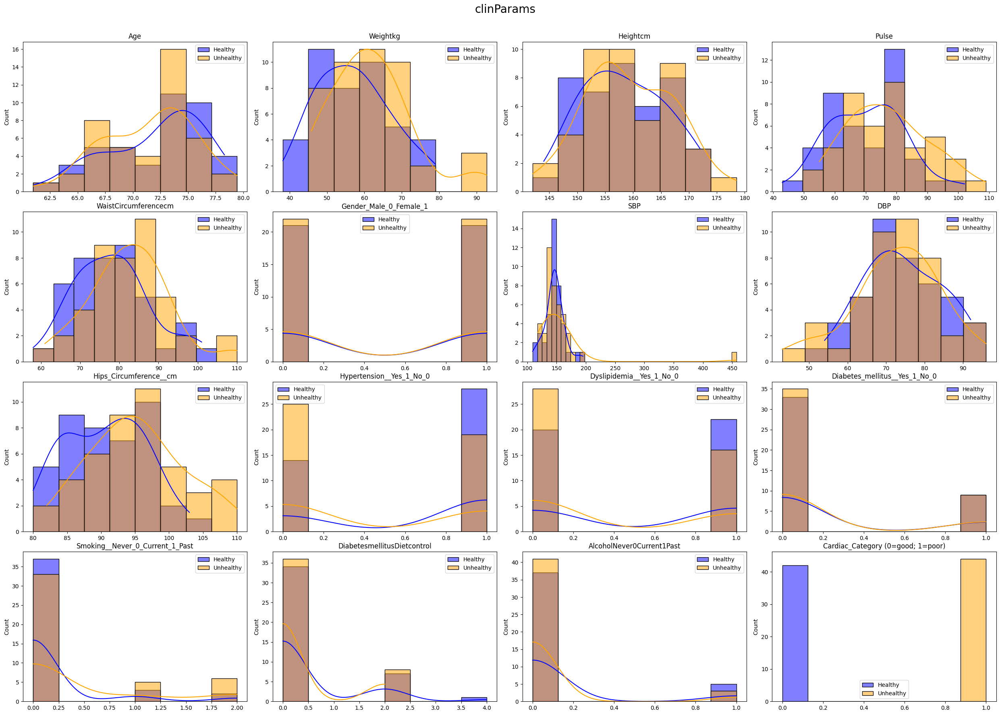

In [24]:
key = "clinParams"
mainDf = preprocessDf(cc_dfDict[key],verbose=False)
healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
numberOfCols = len(mainDf.columns)
PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))
plt.style.use('default')

#bins = np.histogram_bin_edges(healthyDf, bins='auto')
width = max(mainDf.shape[1]*1.5,14)
height = max(mainDf.shape[1],7)
fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
#fig.subplots_adjust(top=width)

for idx,column in enumerate(mainDf.columns):
    #plt.figure()    
    # use bins of mainDf, dropping na values in the process         
    bins = np.histogram_bin_edges(mainDf[column].dropna().values, bins='auto')       
    sns.histplot(healthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Healthy",kde=True,color="blue",bins=bins).set(xlabel=None,title=column)
    sns.histplot(unhealthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Unhealthy",kde=True,color="orange",bins=bins).set(xlabel=None,title=column)
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].legend()
    #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
#plt.tight_layout()
fig.suptitle(key,fontsize=20, ha='center', va ='center')
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')
plt.show()
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')

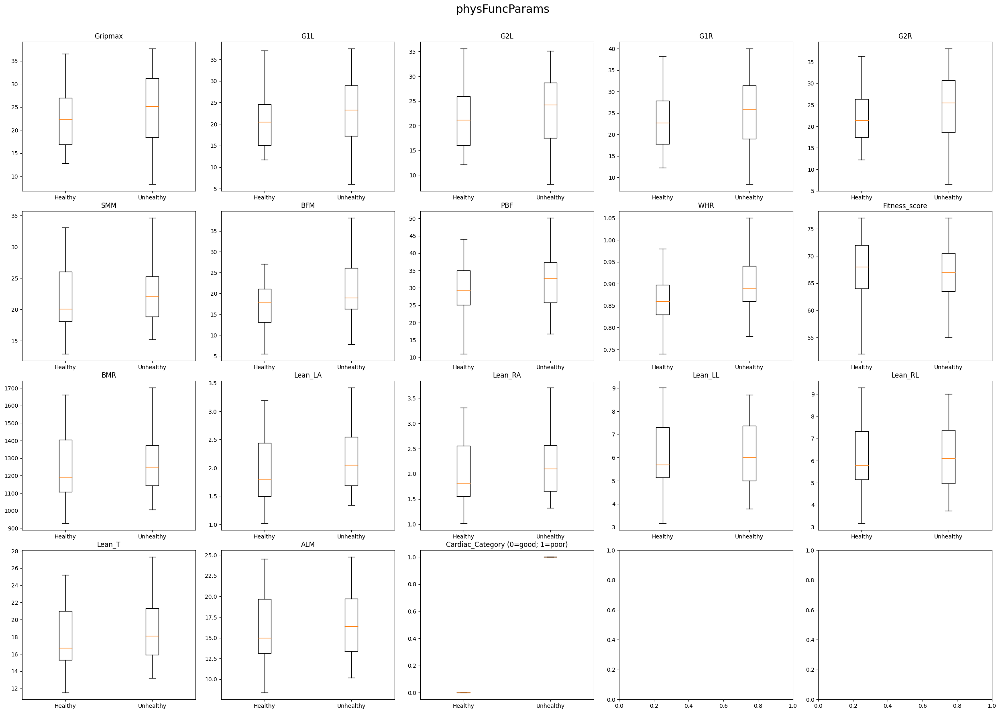

In [25]:
key = "physFuncParams"
mainDf = preprocessDf(cc_dfDict[key],verbose=False)
healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
numberOfCols = len(mainDf.columns)
PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))


#bins = np.histogram_bin_edges(healthyDf, bins='auto')
width = max(mainDf.shape[1]*1.5,14)
height = max(mainDf.shape[1],7)
fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
#fig.subplots_adjust(top=width)
for idx,column in enumerate(mainDf.columns):
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].boxplot([healthyDf[column][~np.isnan(healthyDf[column])],unhealthyDf[column][~np.isnan(unhealthyDf[column])]],sym='')
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].set_xticklabels(["Healthy", "Unhealthy"])
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].set_title(column)

#plt.tight_layout()
fig.suptitle(key,fontsize=20, ha='center', va ='center')
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')
plt.show()
#fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')

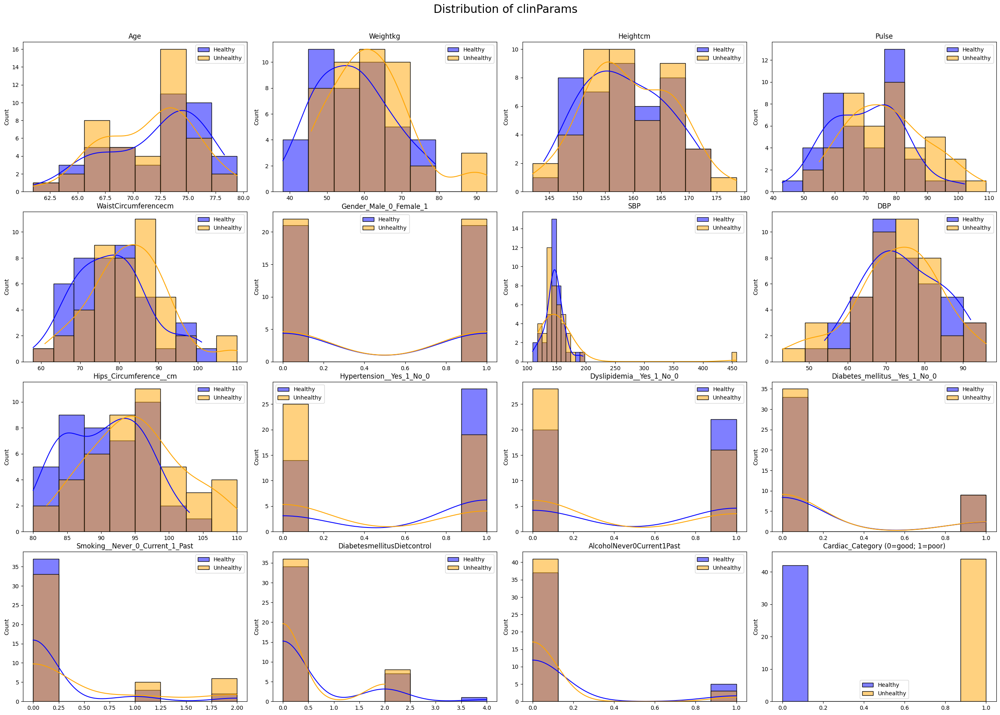

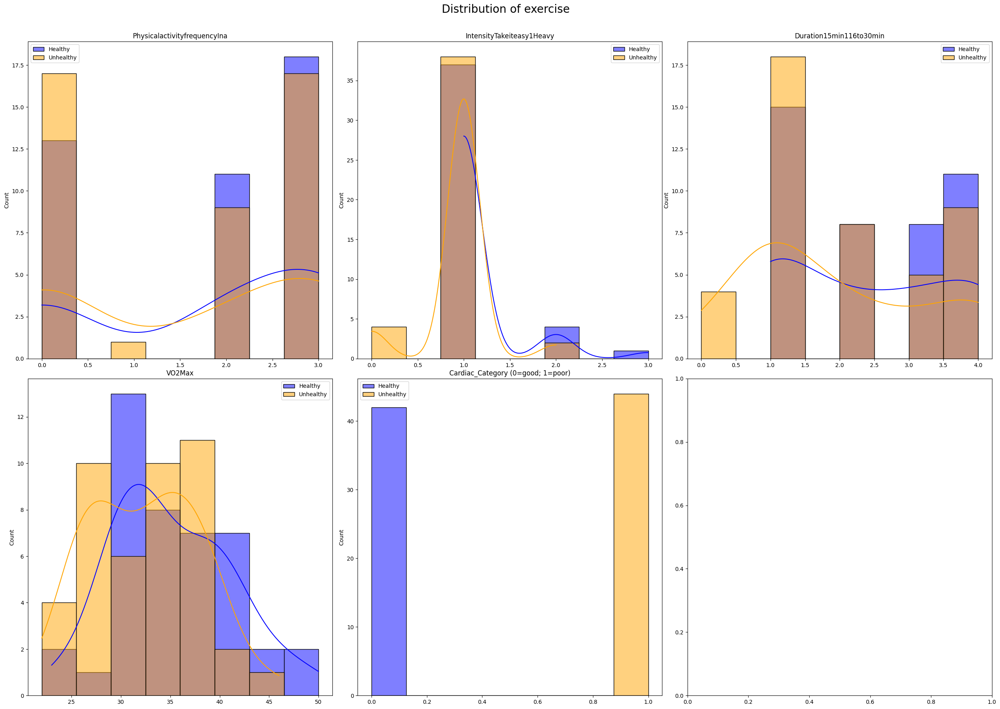

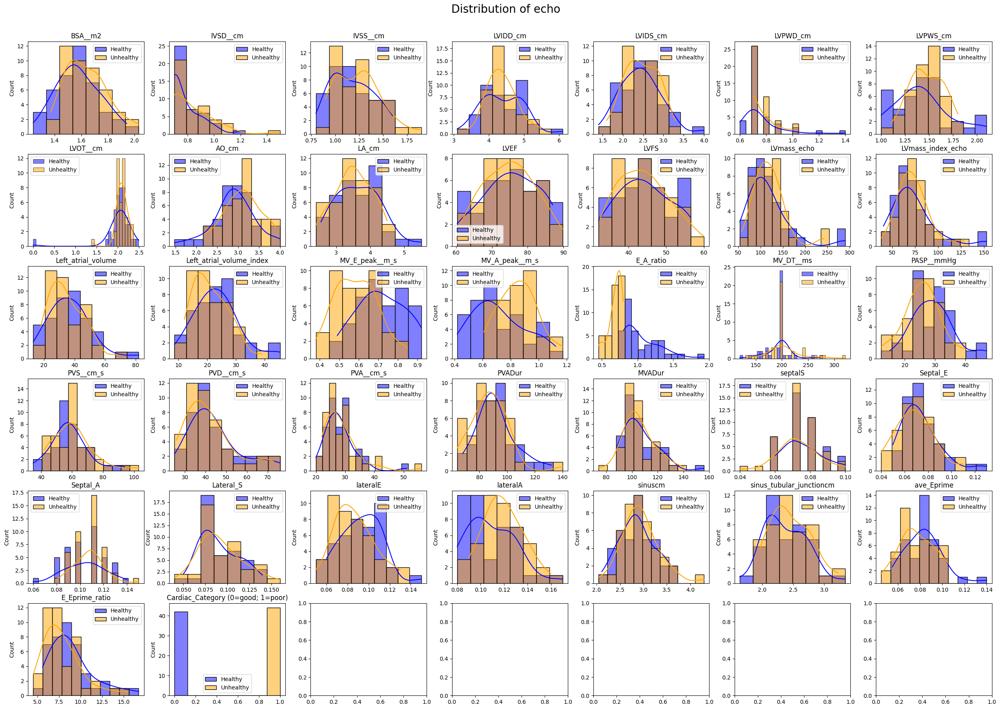

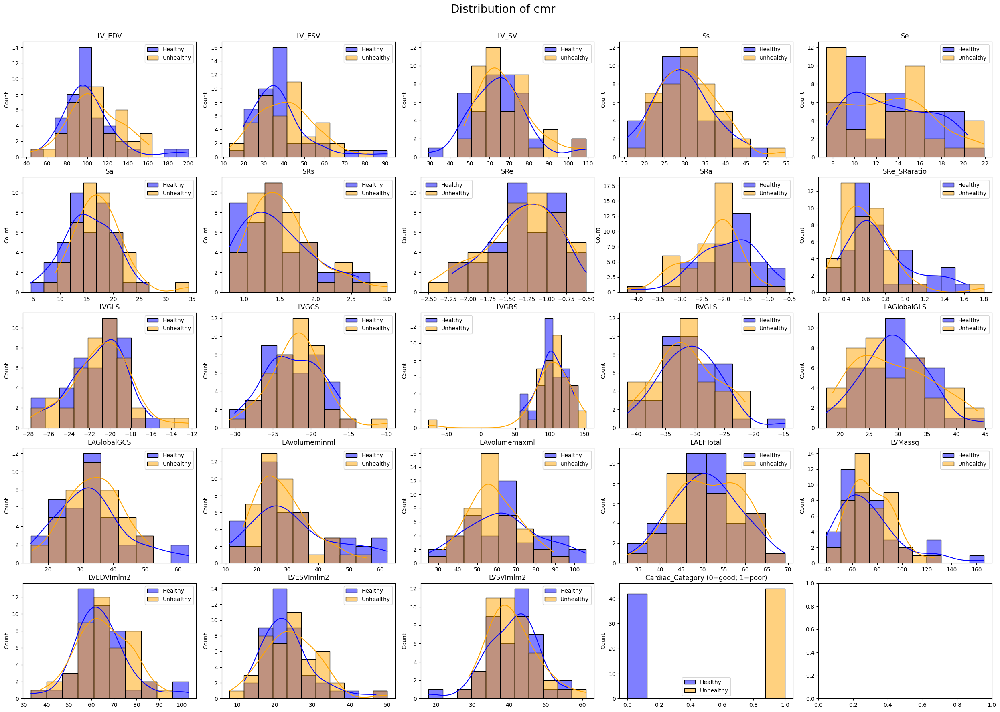

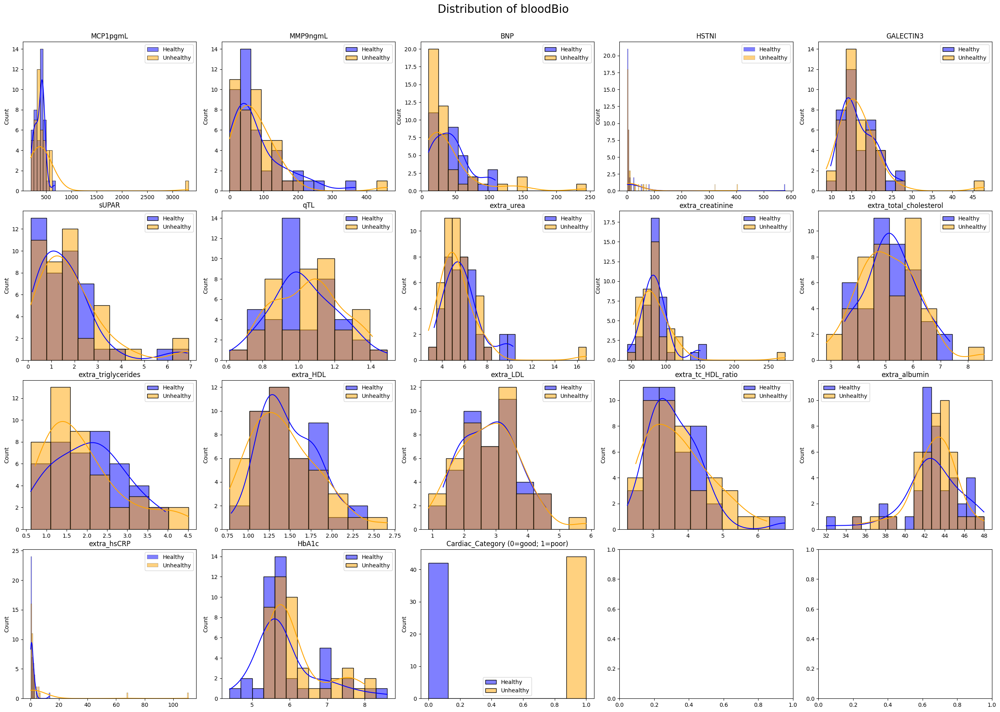

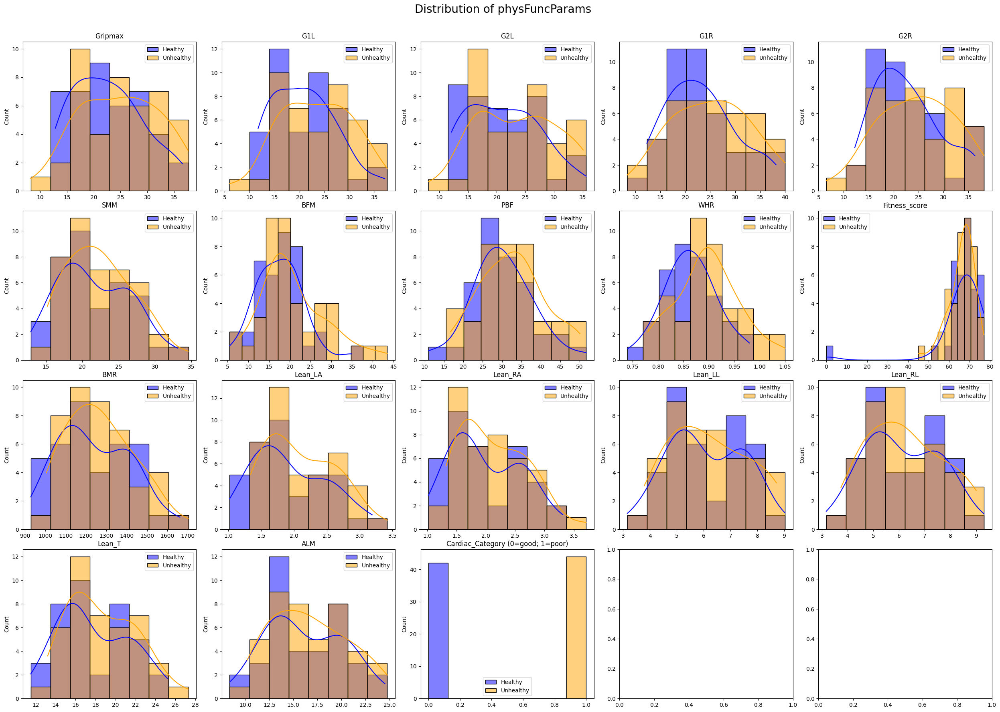

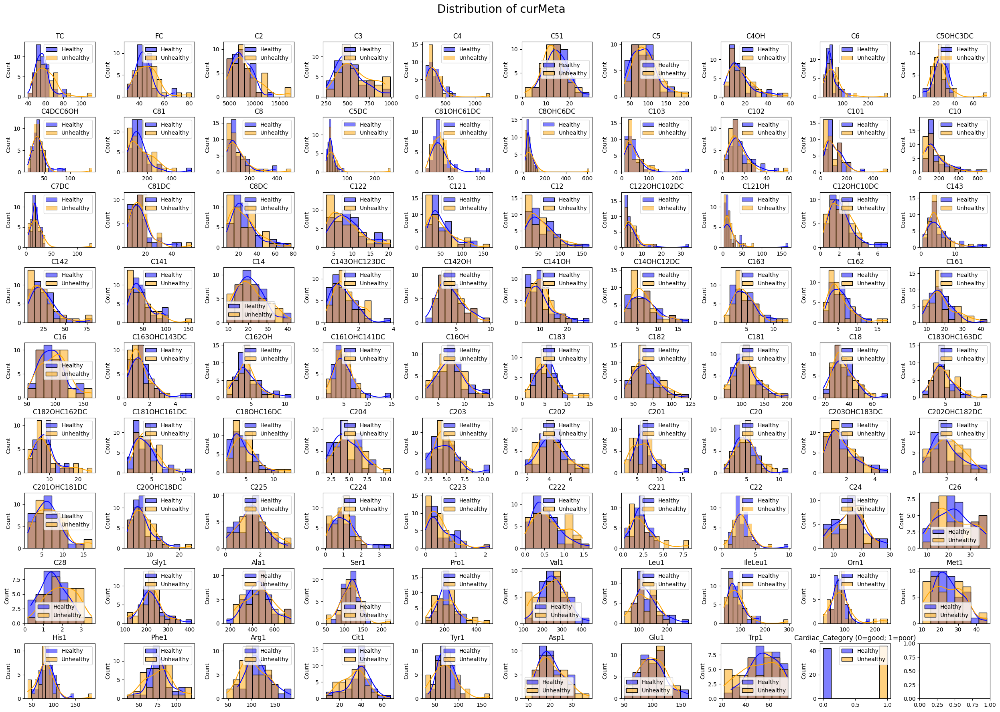

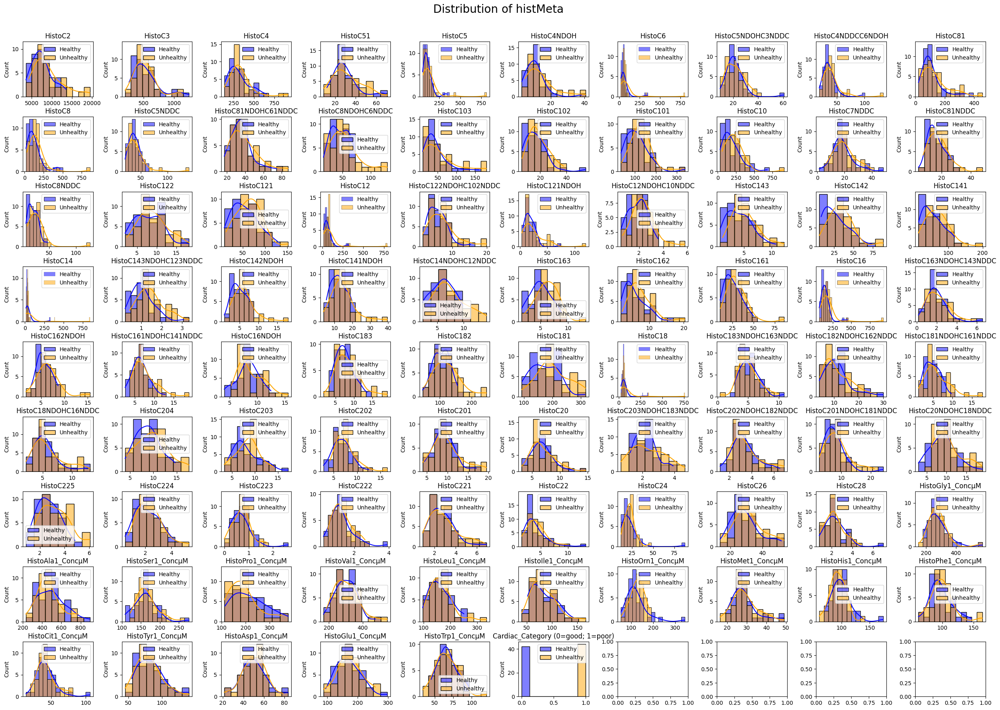

In [26]:
#print(15//6 + 1)
for key in cc_dfDict:

    mainDf = preprocessDf(cc_dfDict[key],verbose=False)
    healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
    unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
    numberOfCols = len(mainDf.columns)
    PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

    #bins = np.histogram_bin_edges(healthyDf, bins='auto')
    width = max(mainDf.shape[1]*1.5,14)
    height = max(mainDf.shape[1],7)
    fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
    fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
    #fig.subplots_adjust(top=width)

    for idx,column in enumerate(mainDf.columns):
        #plt.figure()    
        # use bins of mainDf, dropping na values in the process         
        bins = np.histogram_bin_edges(mainDf[column].dropna().values, bins='auto')       
        sns.histplot(healthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Healthy",kde=True,color="blue",bins=bins).set(xlabel=None,title=column)
        sns.histplot(unhealthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Unhealthy",kde=True,color="orange",bins=bins).set(xlabel=None,title=column)
        axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].legend()
        #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
    #plt.tight_layout()
    fig.suptitle(f"Distribution of {key}",fontsize=20, ha='center', va ='center')
    fig.savefig(f'Outputs/DistributionPlots/{key}_distribution.png')
    plt.show()
    

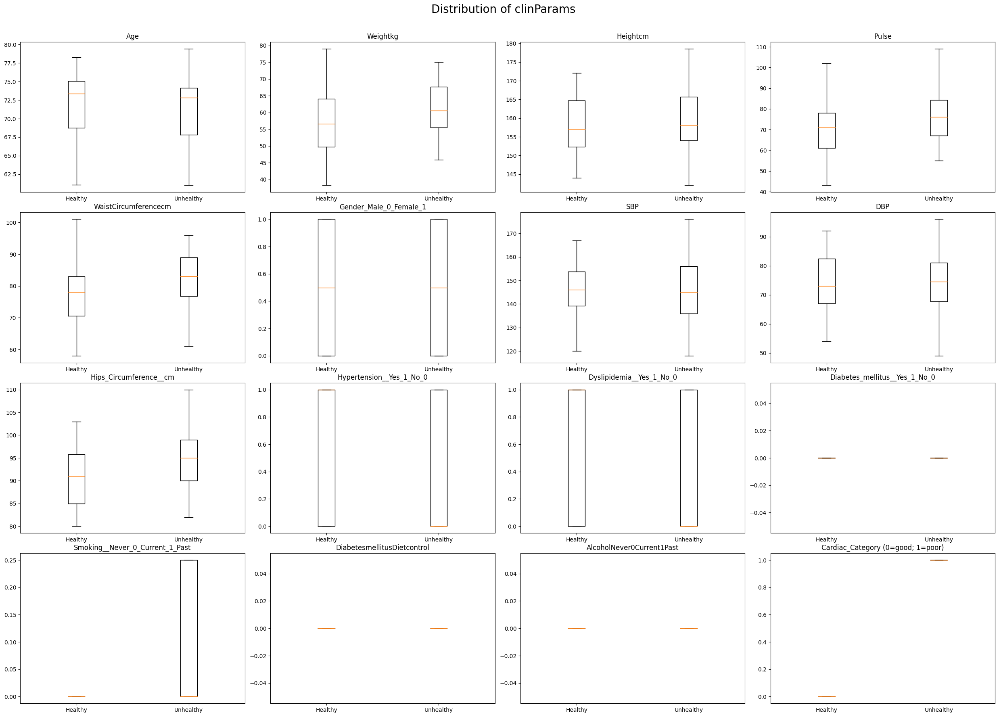

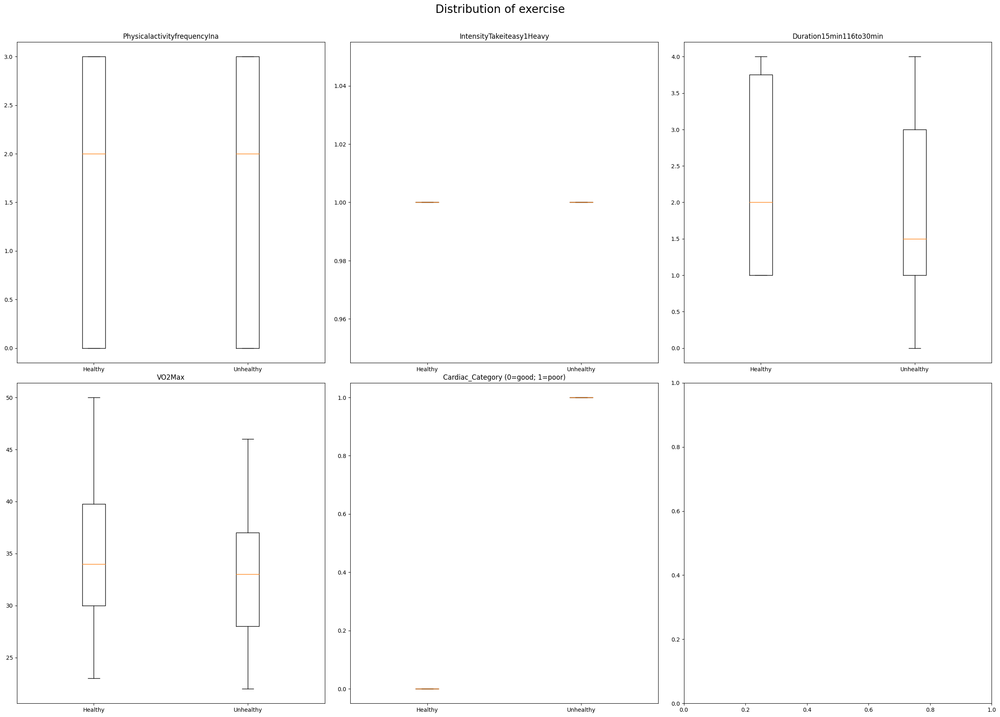

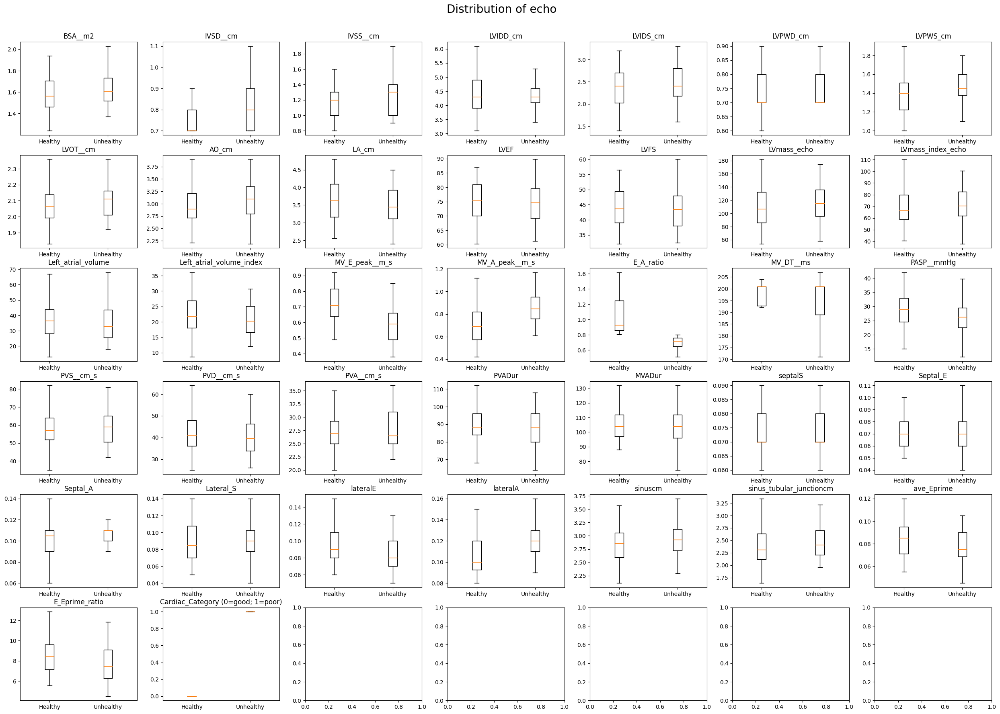

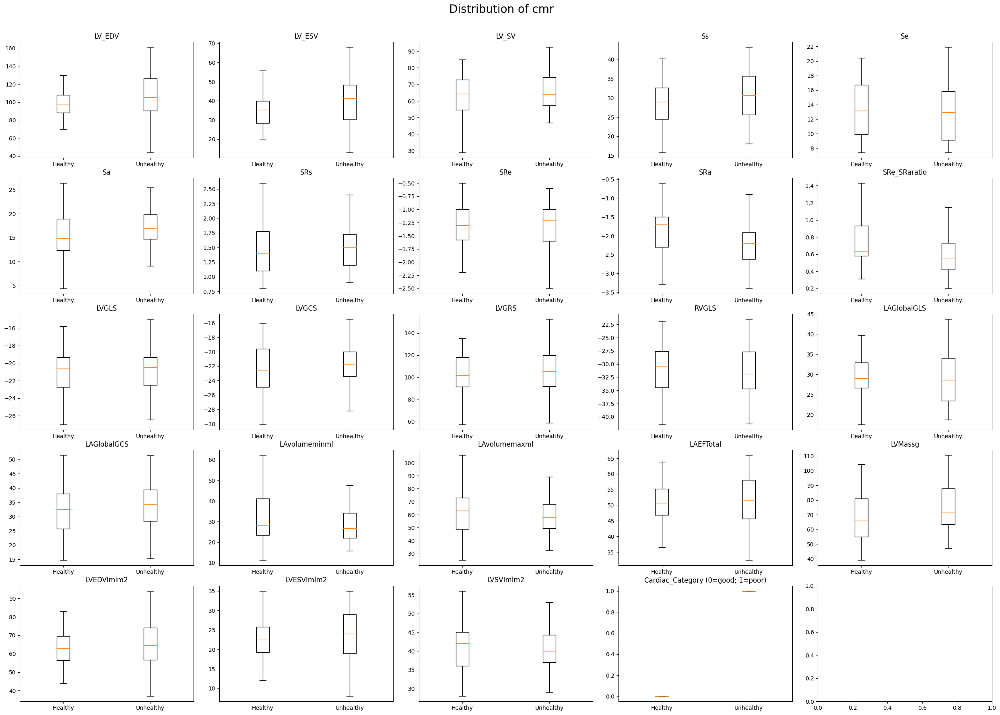

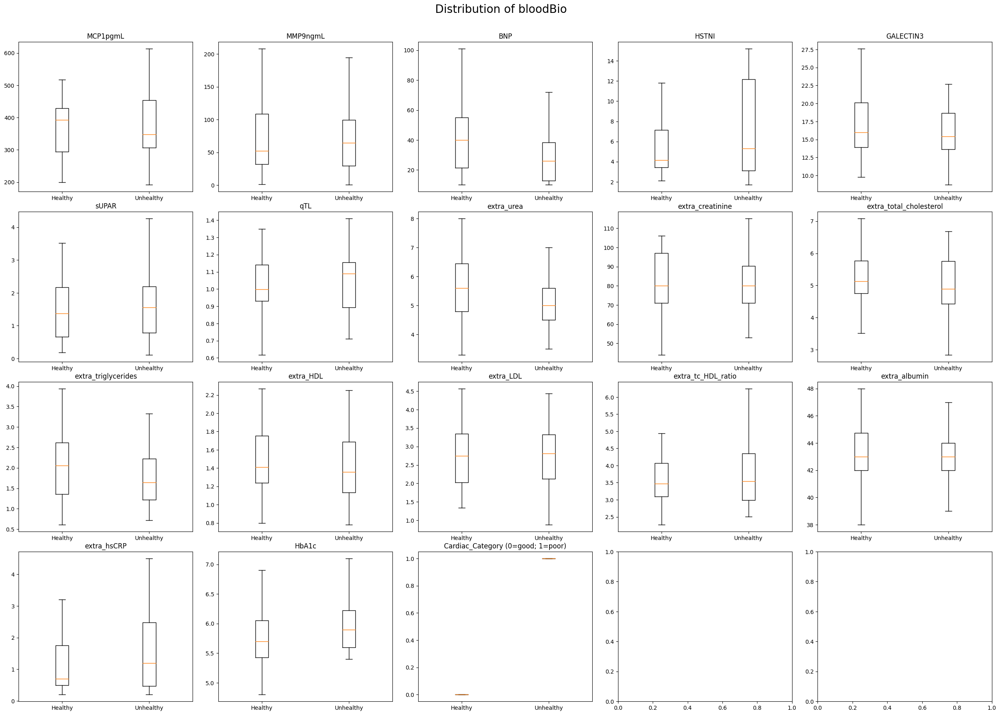

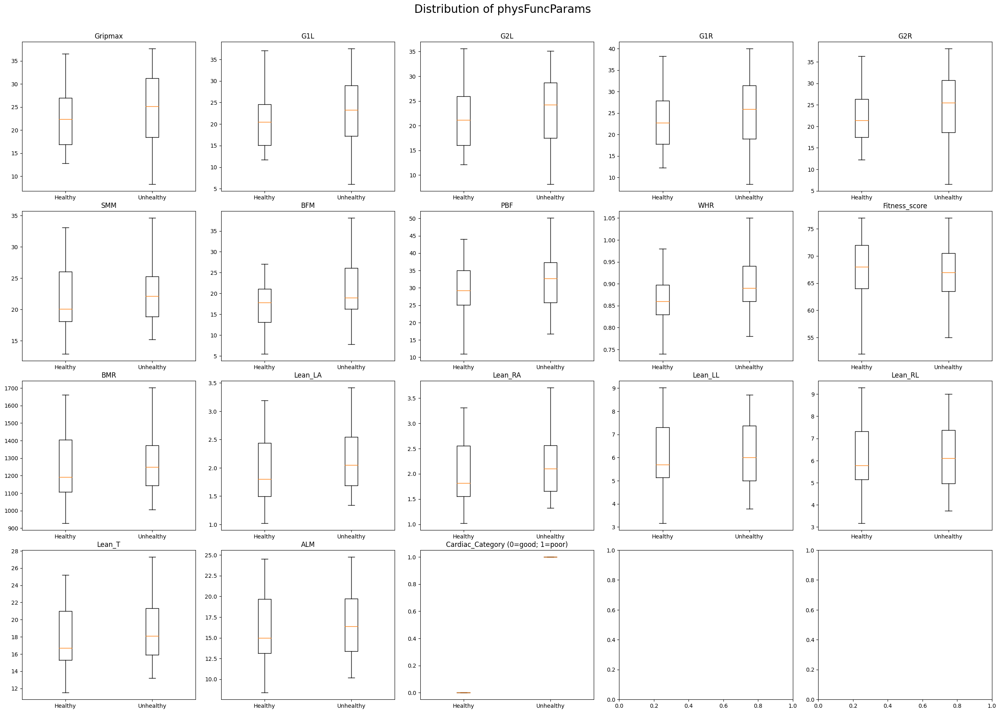

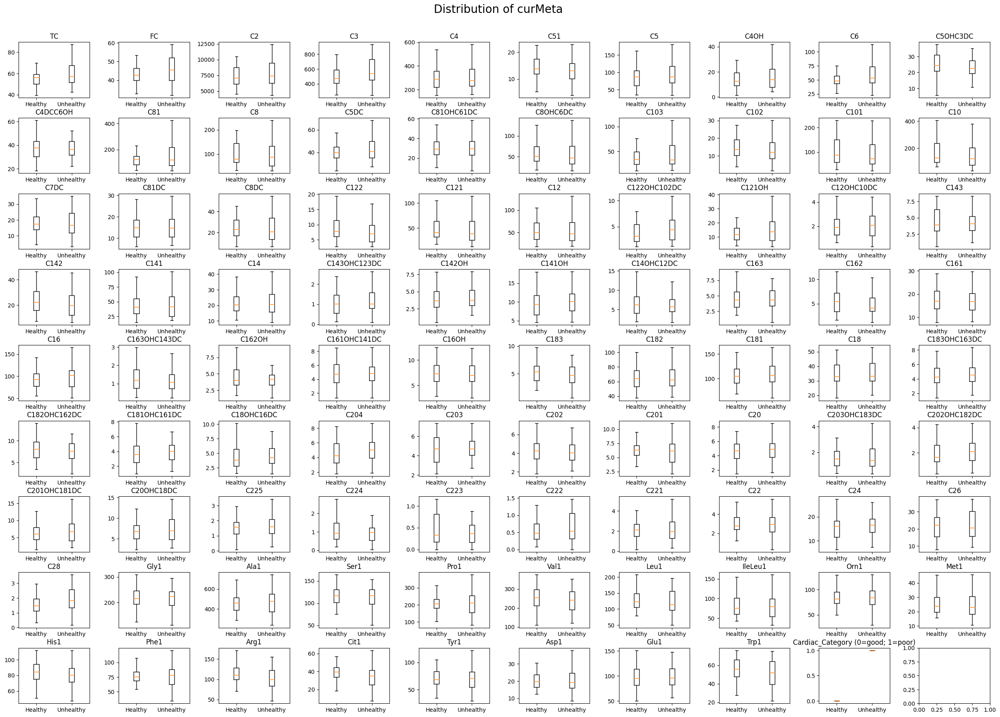

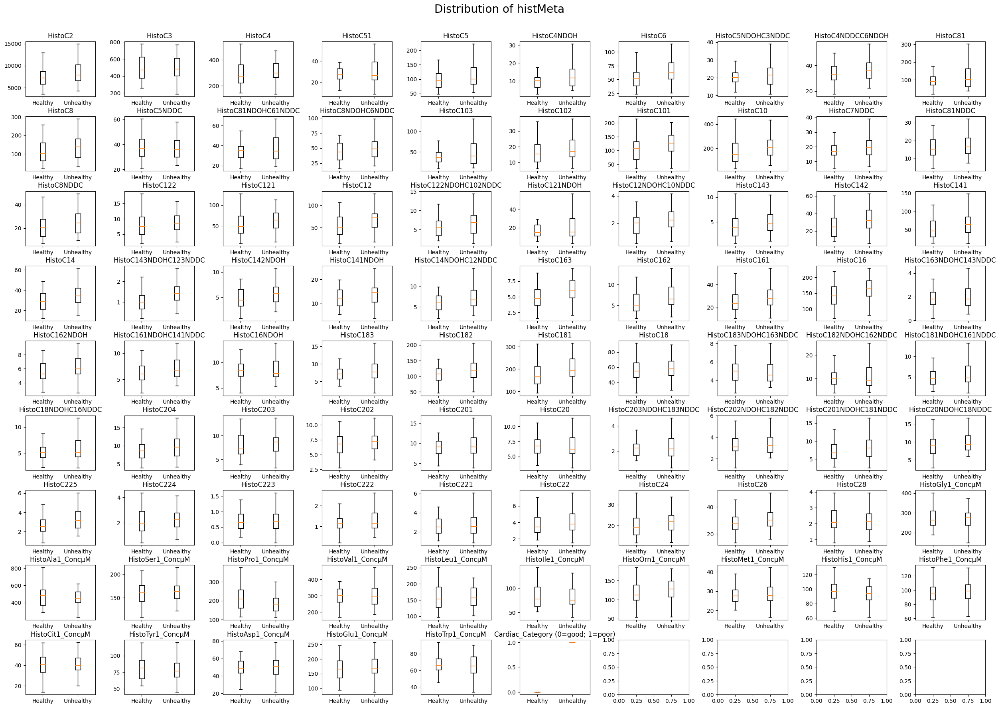

In [27]:
#print(15//6 + 1)
for key in cc_dfDict:

    mainDf = preprocessDf(cc_dfDict[key],verbose=False)
    healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
    unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
    numberOfCols = len(mainDf.columns)
    PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

    #bins = np.histogram_bin_edges(healthyDf, bins='auto')
    width = max(mainDf.shape[1]*1.5,14)
    height = max(mainDf.shape[1],7)
    fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
    fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
    #fig.subplots_adjust(top=width)

    for idx,column in enumerate(mainDf.columns):
        #plt.figure()    
        axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].boxplot([healthyDf[column][~np.isnan(healthyDf[column])],unhealthyDf[column][~np.isnan(unhealthyDf[column])]],sym='')
        axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].set_xticklabels(["Healthy", "Unhealthy"])
        axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].set_title(column)
    #plt.tight_layout()
    fig.suptitle(f"Distribution of {key}",fontsize=20, ha='center', va ='center')
    fig.savefig(f'Outputs/BoxPlots/{key}_boxplot.png')
    plt.show()

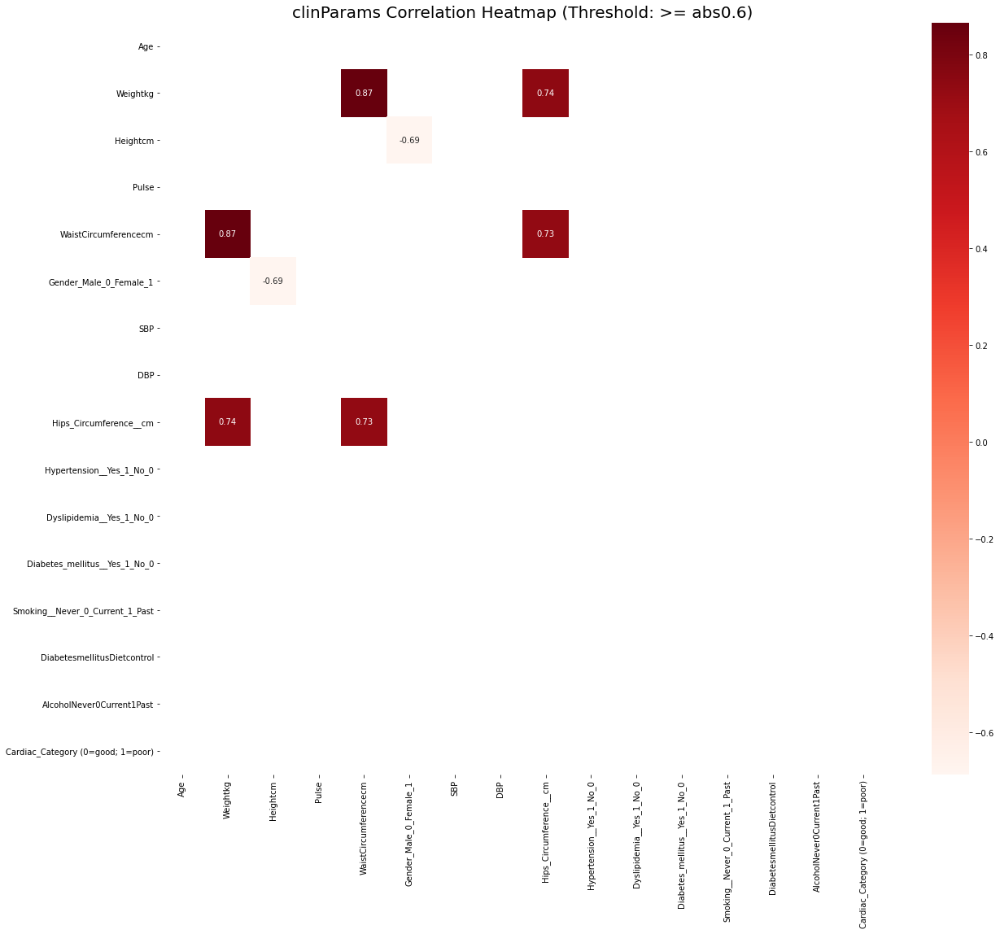

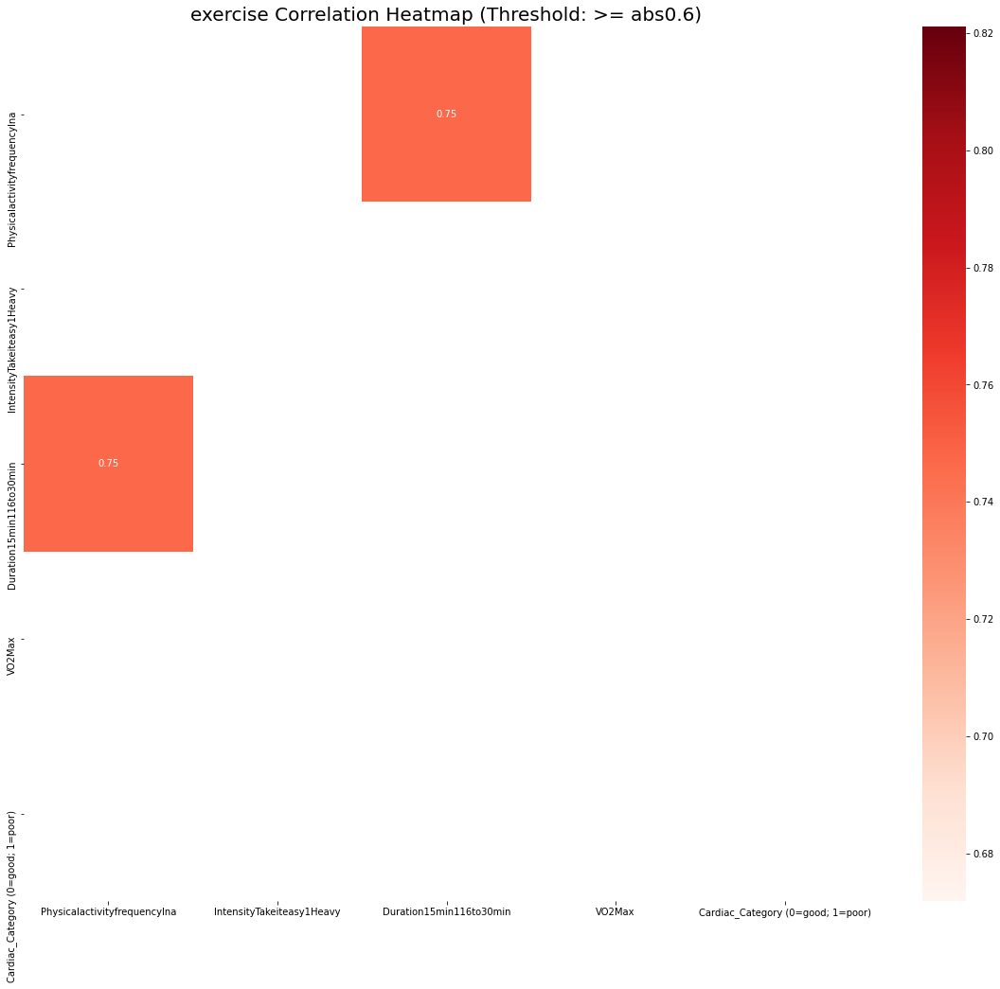

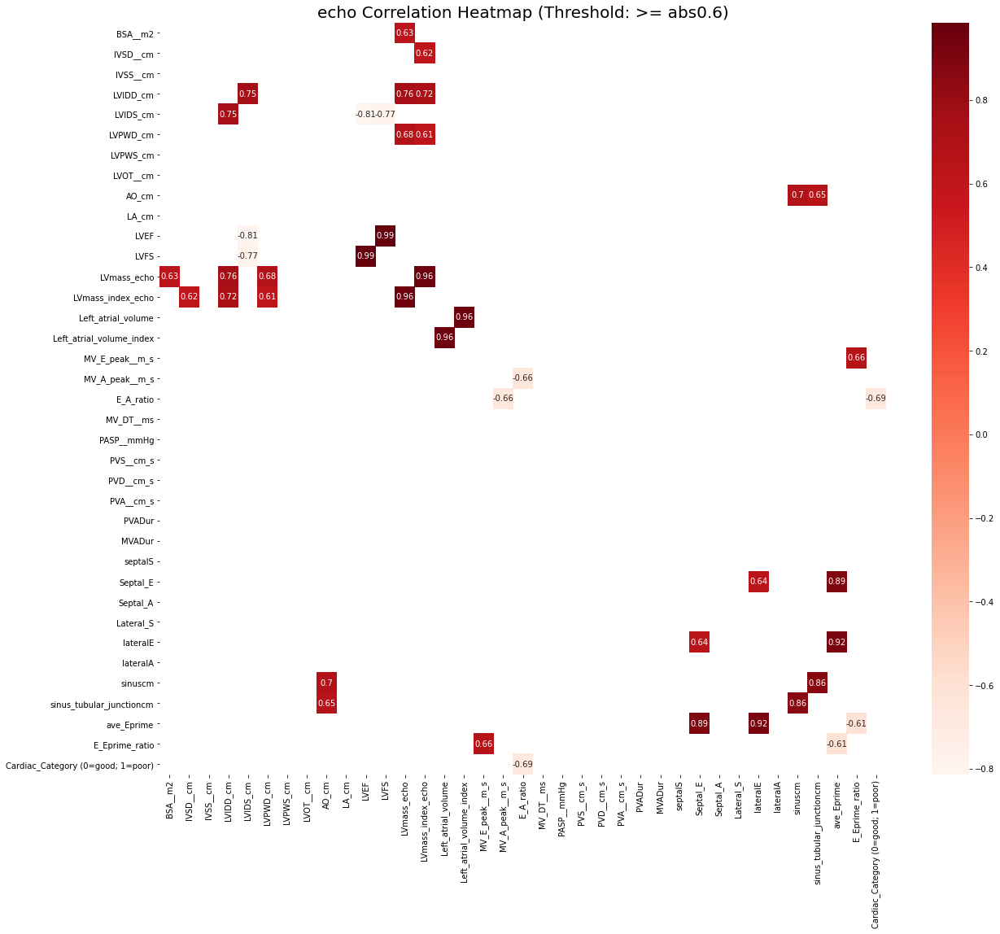

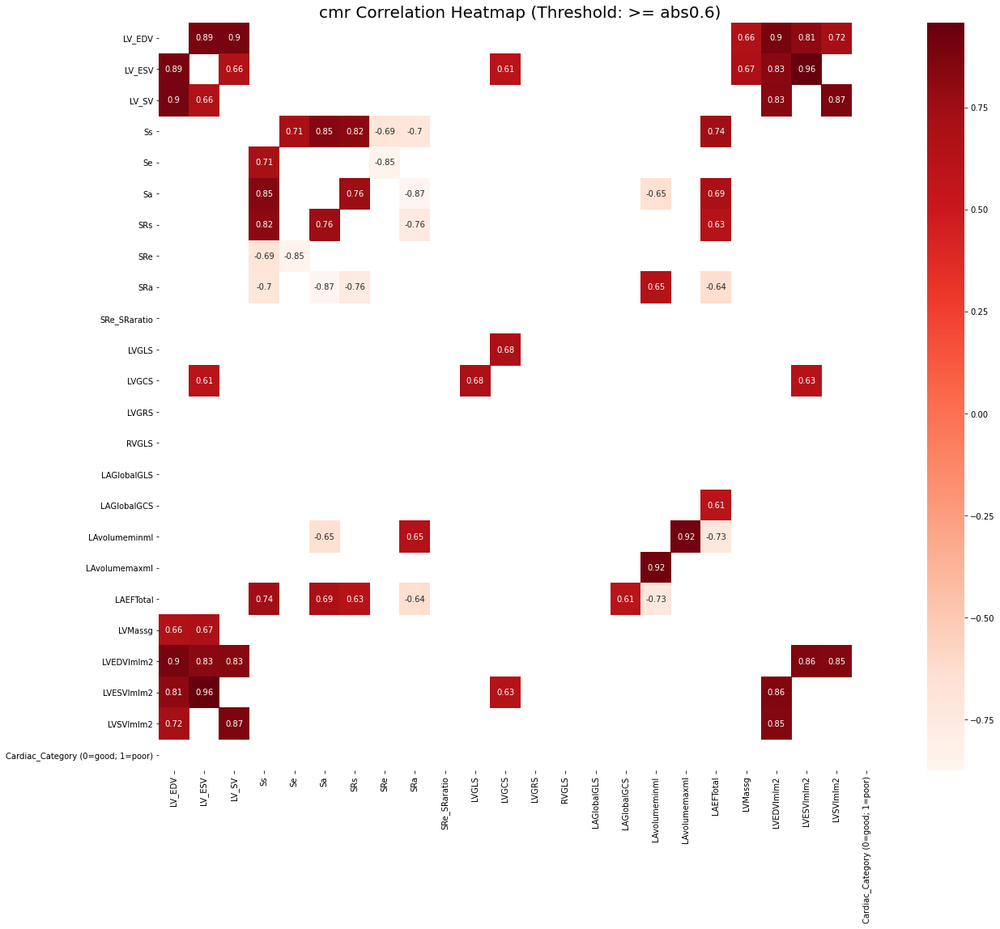

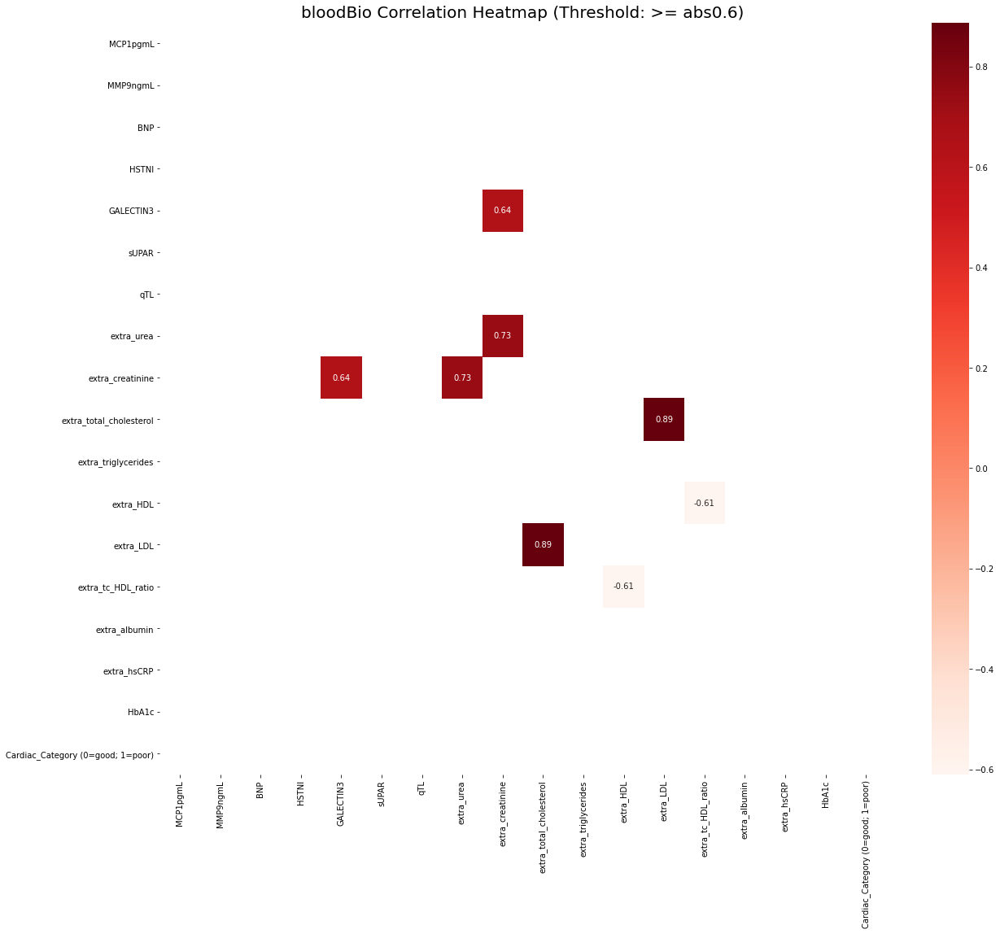

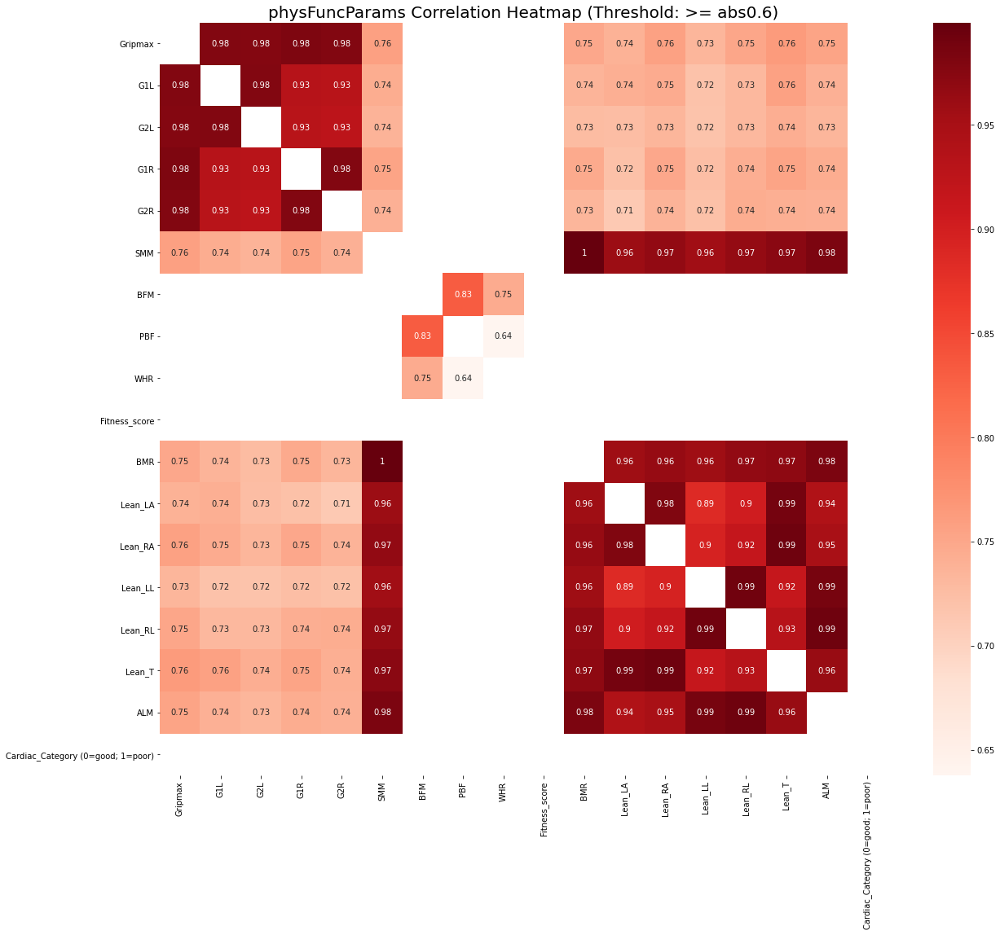

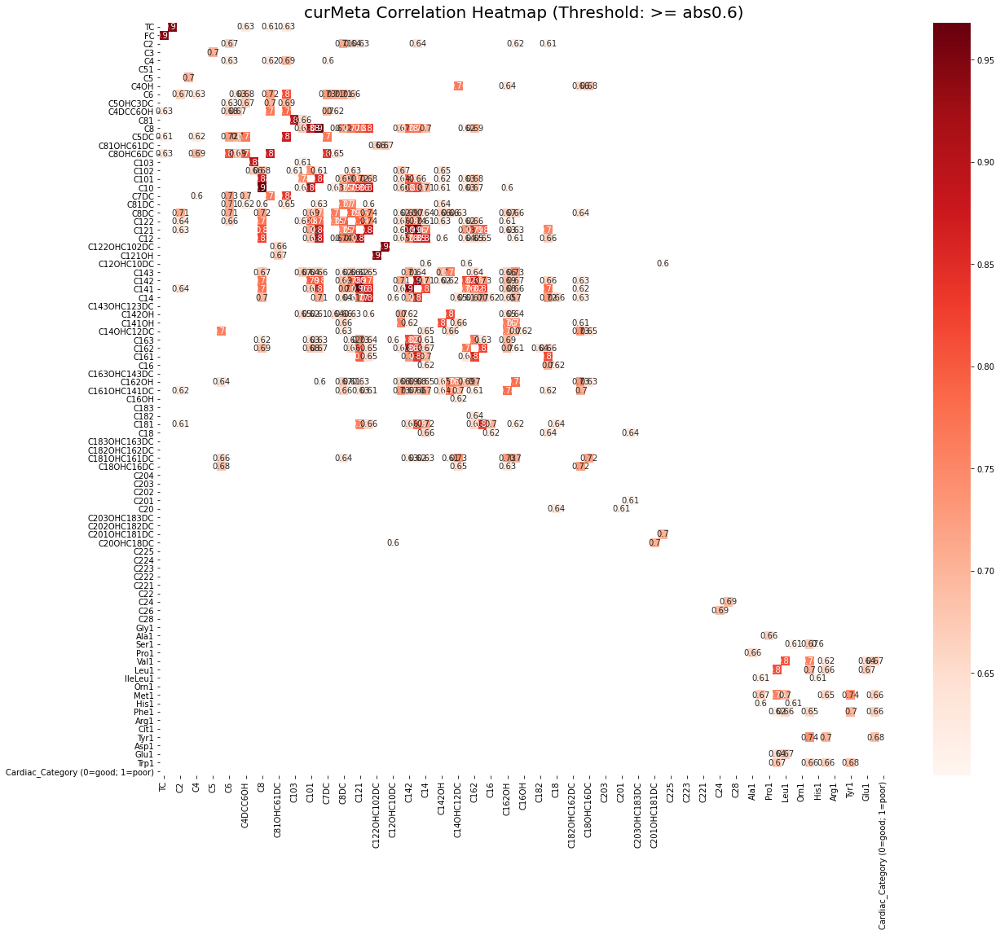

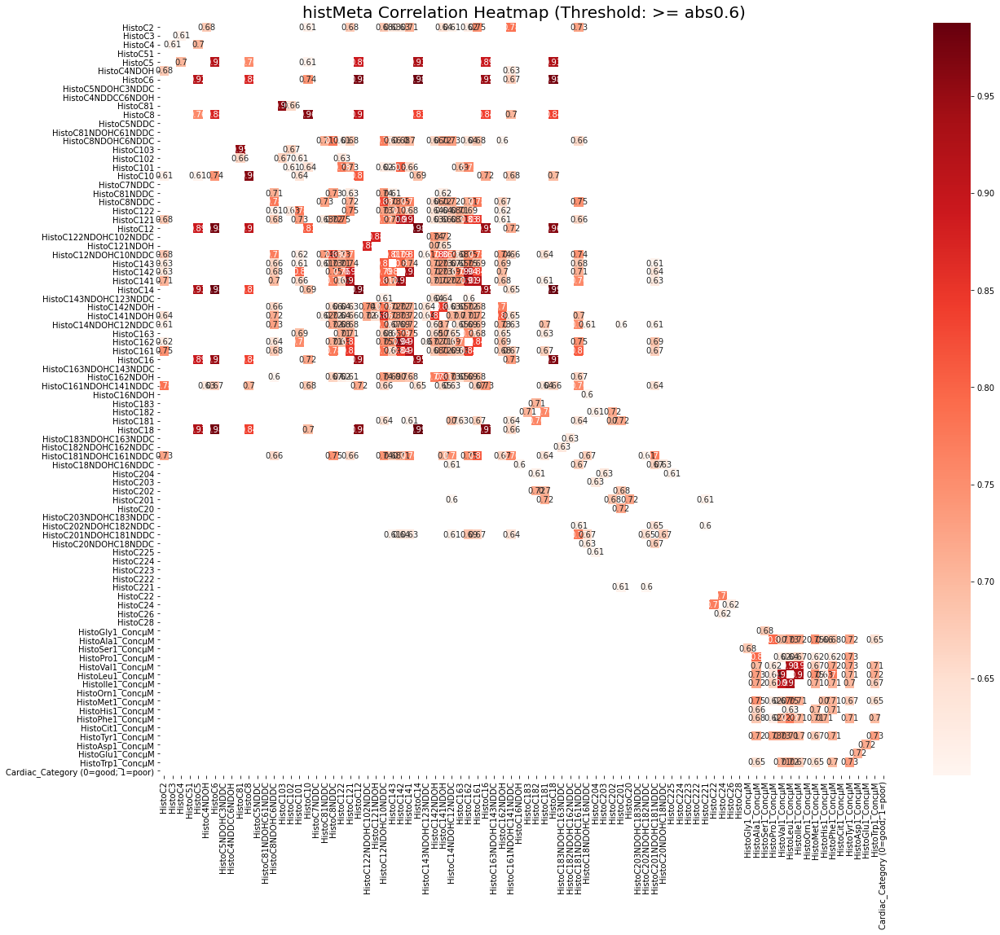

In [23]:
# Cell 5
# Churn out batches of correlation figures and tables
# Might be abit slow

for key in cc_dfDict:
    #print(f"Working on {key}")
    outputCorrData(cc_dfDict[key],filename=key,generateFiles=False)



,Gripmax,G1L,G2L,G1R,G2R,SMM,BFM,PBF,WHR,Fitness_score,BMR,Lean_LA,Lean_RA,Lean_LL,Lean_RL,Lean_T,ALM,LVEF
Gripmax,1.000000,0.978465,0.977215,0.981332,0.978025,0.758203,-0.141253,-0.509535,0.051581,-0.038496,0.750100,0.738887,0.757050,0.734841,0.751589,0.763942,0.753783,-0.153585
G1L,0.978465,1.000000,0.978355,0.933079,0.930976,0.743985,-0.113186,-0.481093,0.080991,-0.038808,0.736220,0.742243,0.745942,0.720873,0.732290,0.756467,0.739838,-0.115122
G2L,0.977215,0.978355,1.000000,0.930490,0.927135,0.738014,-0.119764,-0.488339,0.043897,-0.063748,0.728167,0.726471,0.734105,0.718348,0.731614,0.743138,0.734558,-0.147289
G1R,0.981332,0.933079,0.930490,1.000000,0.979068,0.754292,-0.165590,-0.521632,0.034949,-0.009292,0.746746,0.721659,0.750480,0.724302,0.742608,0.753810,0.743914,-0.156343
G2R,0.978025,0.930976,0.927135,0.979068,1.000000,0.739910,-0.178644,-0.526134,0.018905,-0.032729,0.733937,0.711284,0.737454,0.721981,0.743777,0.741600,0.740325,-0.184609
SMM,0.758203,0.743985,0.738014,0.754292,0.739910,1.000000,0.063827,-0.422470,0.112320,0.062785,0.999153,0.959710,0.967510,0.956647,0.966631,0.972972,0.982642,-0.220597
BFM,-0.141253,-0.113186,-0.119764,-0.165590,-0.178644,0.063827,1.000000,0.832513,0.746244,-0.350894,0.064105,0.210529,0.177713,-0.003803,0.002542,0.181930,0.054491,0.018108
PBF,-0.509535,-0.481093,-0.488339,-0.521632,-0.526134,-0.422470,0.832513,1.000000,0.637839,-0.313045,-0.423988,-0.265828,-0.295713,-0.476999,-0.471055,-0.299855,-0.429255,0.136584
WHR,0.051581,0.080991,0.043897,0.034949,0.018905,0.112320,0.746244,0.637839,1.000000,-0.377443,0.109173,0.323383,0.302505,-0.008852,0.019034,0.306681,0.095808,-0.026643
Fitness_score,-0.038496,-0.038808,-0.063748,-0.009292,-0.032729,0.062785,-0.350894,-0.313045,-0.377443,1.000000,0.059465,-0.070648,-0.053979,0.088441,0.038425,-0.051331,0.030122,0.091600


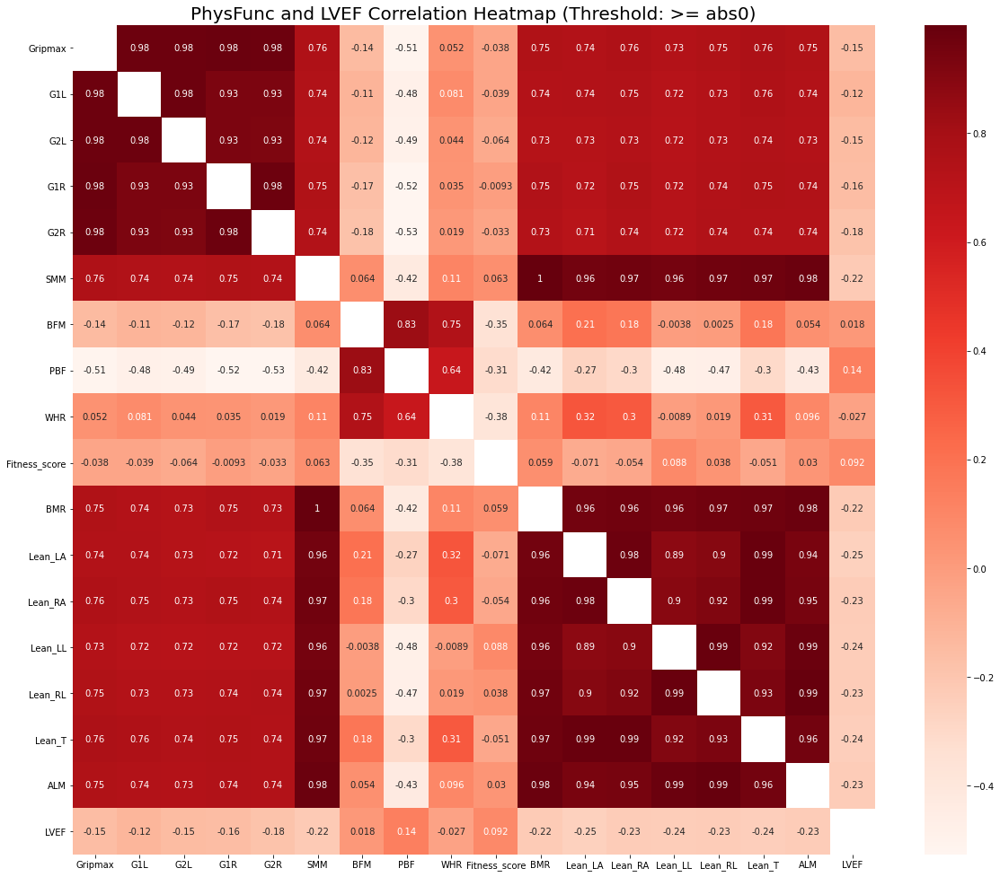

In [24]:
# Cell 6
# Output correlation data between phys func parameters and LVEF
regData1 = data[physFuncParamsCols + ["LVEF"]]
outputCorrData(regData1,threshold=0,filename="PhysFunc and LVEF")

,Gripmax,G1L,G2L,G1R,G2R,SMM,BFM,PBF,WHR,Fitness_score,BMR,Lean_LA,Lean_RA,Lean_LL,Lean_RL,Lean_T,ALM,E_A_ratio
Gripmax,1.000000,0.978465,0.977215,0.981332,0.978025,0.758203,-0.141253,-0.509535,0.051581,-0.038496,0.750100,0.738887,0.757050,0.734841,0.751589,0.763942,0.753783,0.003463
G1L,0.978465,1.000000,0.978355,0.933079,0.930976,0.743985,-0.113186,-0.481093,0.080991,-0.038808,0.736220,0.742243,0.745942,0.720873,0.732290,0.756467,0.739838,-0.030138
G2L,0.977215,0.978355,1.000000,0.930490,0.927135,0.738014,-0.119764,-0.488339,0.043897,-0.063748,0.728167,0.726471,0.734105,0.718348,0.731614,0.743138,0.734558,-0.013362
G1R,0.981332,0.933079,0.930490,1.000000,0.979068,0.754292,-0.165590,-0.521632,0.034949,-0.009292,0.746746,0.721659,0.750480,0.724302,0.742608,0.753810,0.743914,0.026848
G2R,0.978025,0.930976,0.927135,0.979068,1.000000,0.739910,-0.178644,-0.526134,0.018905,-0.032729,0.733937,0.711284,0.737454,0.721981,0.743777,0.741600,0.740325,0.017177
SMM,0.758203,0.743985,0.738014,0.754292,0.739910,1.000000,0.063827,-0.422470,0.112320,0.062785,0.999153,0.959710,0.967510,0.956647,0.966631,0.972972,0.982642,-0.035518
BFM,-0.141253,-0.113186,-0.119764,-0.165590,-0.178644,0.063827,1.000000,0.832513,0.746244,-0.350894,0.064105,0.210529,0.177713,-0.003803,0.002542,0.181930,0.054491,-0.298354
PBF,-0.509535,-0.481093,-0.488339,-0.521632,-0.526134,-0.422470,0.832513,1.000000,0.637839,-0.313045,-0.423988,-0.265828,-0.295713,-0.476999,-0.471055,-0.299855,-0.429255,-0.260349
WHR,0.051581,0.080991,0.043897,0.034949,0.018905,0.112320,0.746244,0.637839,1.000000,-0.377443,0.109173,0.323383,0.302505,-0.008852,0.019034,0.306681,0.095808,-0.377930
Fitness_score,-0.038496,-0.038808,-0.063748,-0.009292,-0.032729,0.062785,-0.350894,-0.313045,-0.377443,1.000000,0.059465,-0.070648,-0.053979,0.088441,0.038425,-0.051331,0.030122,0.108244


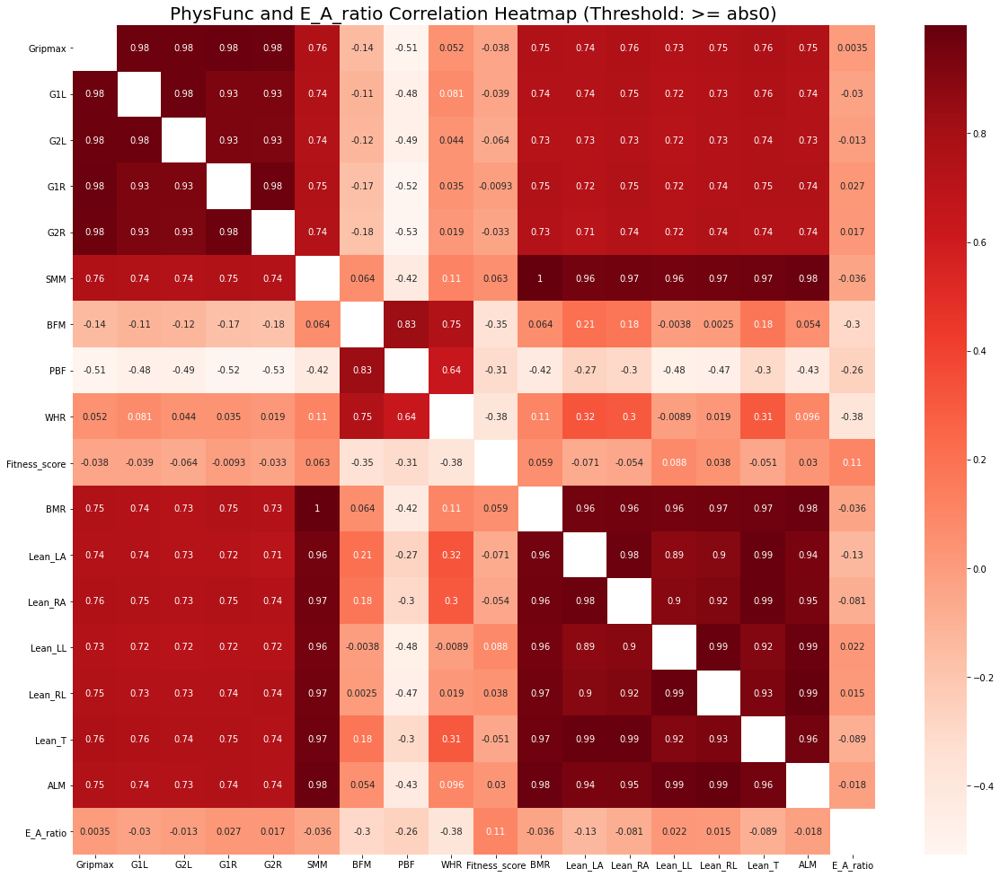

In [25]:
# Cell 7
# Output correlation data between phys func parameters and E_A_Ratio
regData2 = data[physFuncParamsCols + ["E_A_ratio"]]
outputCorrData(regData2,threshold=0,filename="PhysFunc and E_A_ratio")

Comparing models for Model comparison for clinParams, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Gender column contains only 2 values. Converting to binary
Male
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
Series([], dtype: int64)
Original Shape:(86, 15)
Final Shape:(86, 15)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.637255      0.653457   
0                  GaussianNB        0.555948      0.601574   
0        KNeighborsClassifier        0.529935      0.524120   
0      DecisionTreeClassifier        0.482484      0.482361   
0      RandomForestClassifier        0.504118      0.533997   
0  GradientBoostingClassifier        0.501307      0.496358   
0               XGBClassifier        0.507712      0.510957   
0

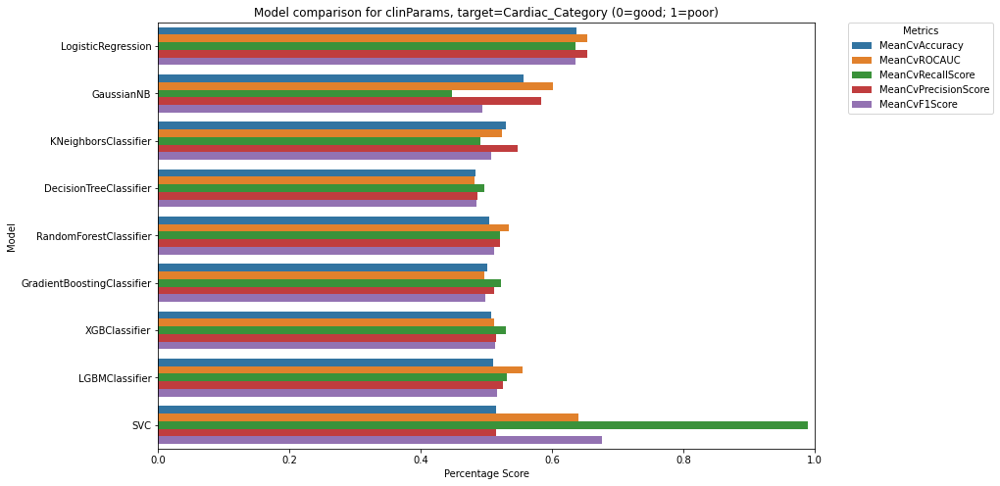

***********************************************
Comparing models for Model comparison for exercise, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
Series([], dtype: int64)
Original Shape:(86, 4)
Final Shape:(86, 4)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.554183      0.601250   
0                  GaussianNB        0.488039      0.546682   
0        KNeighborsClassifier        0.654052      0.631420   
0      DecisionTreeClassifier        0.538235      0.547963   
0      RandomForestClassifier        0.591373      0.626836   
0  GradientBoostingClassifier        0.552026      0.583457   
0               XGBClassifier        0.552288      0.568194   
0              LGBMCl

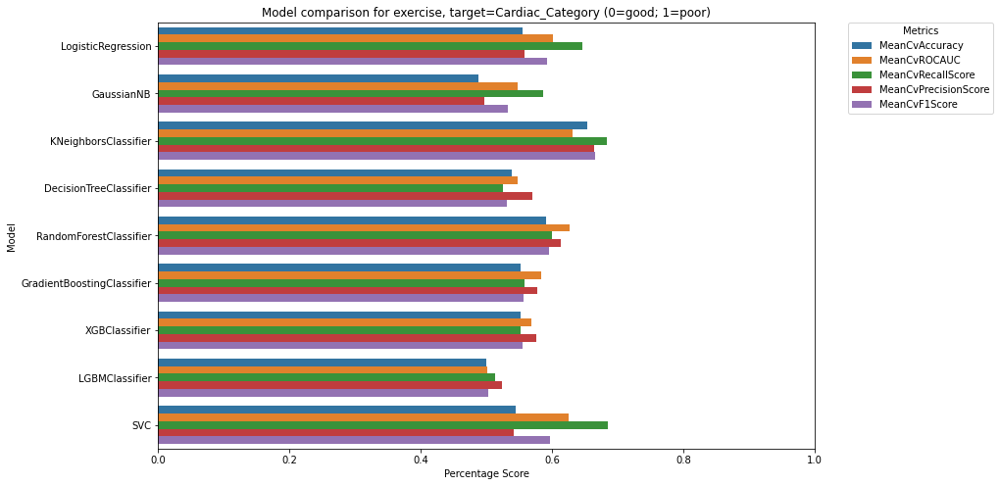

***********************************************
Comparing models for Model comparison for echo, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
PASP__mmHg                  8.14
PVS__cm_s                   2.33
PVD__cm_s                   2.33
PVA__cm_s                   2.33
PVADur                      2.33
sinuscm                     2.33
sinus_tubular_junctioncm    2.33
LVFS                        1.16
Left_atrial_volume          1.16
Left_atrial_volume_index    1.16
MV_DT__ms                   1.16
dtype: float64
Original Shape:(86, 36)
Final Shape:(86, 36)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.581242      0.608025   
0                  GaussianNB        0.772092   

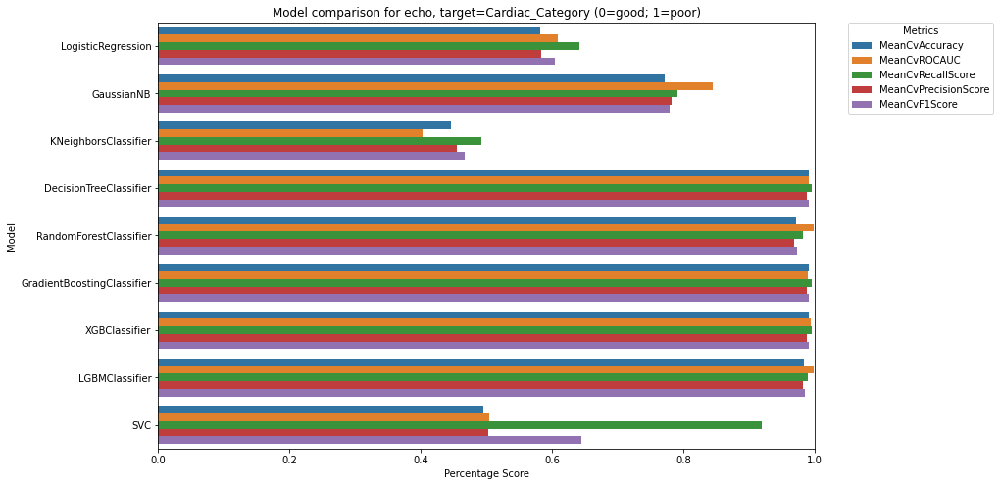

***********************************************
Comparing models for Model comparison for cmr, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  3
These columns are:
 ['LVEF_A', 'LV_Mass_on_mri__g', 'EDV067']
Columns with missing values (%):
EDV067               65.12
LVEF_A               65.12
LV_Mass_on_mri__g    43.02
LAGlobalGLS           4.65
LAGlobalGCS           4.65
LVGCS                 1.16
LVGRS                 1.16
dtype: float64
Original Shape:(86, 26)
Final Shape:(86, 23)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.561242      0.594259   
0                  GaussianNB        0.513399      0.531296   
0        KNeighborsClassifier        0.503595      0.522886   
0      DecisionTreeClassifier        0.517712      0.51819

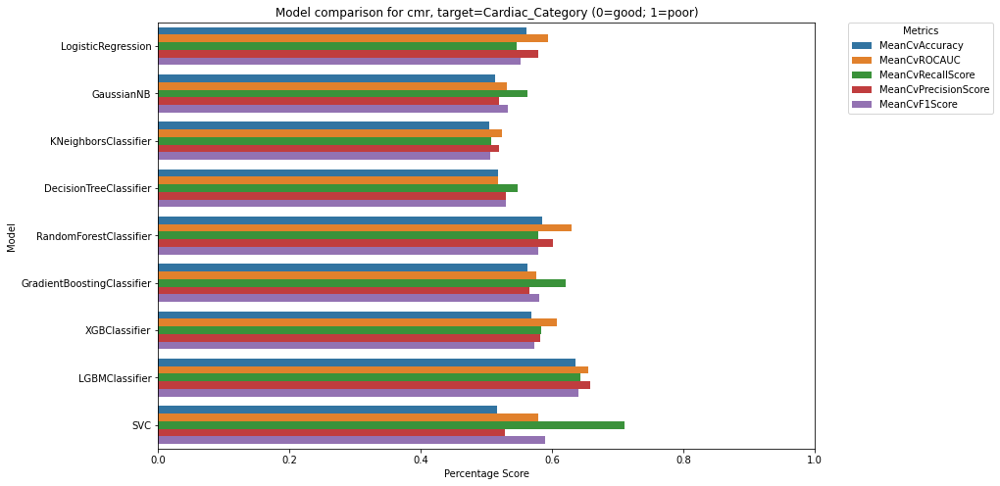

***********************************************
Comparing models for Model comparison for bloodBio, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
BNP          5.81
GALECTIN3    5.81
HSTNI        4.65
MMP9ngmL     2.33
sUPAR        1.16
qTL          1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.532418      0.547438   
0                  GaussianNB        0.456797      0.448148   
0        KNeighborsClassifier        0.536405      0.565571   
0      DecisionTreeClassifier        0.509412      0.509861   
0      RandomForestClassifier        0.535490      0.521775   
0  GradientBoostingClassifier        0.503922  

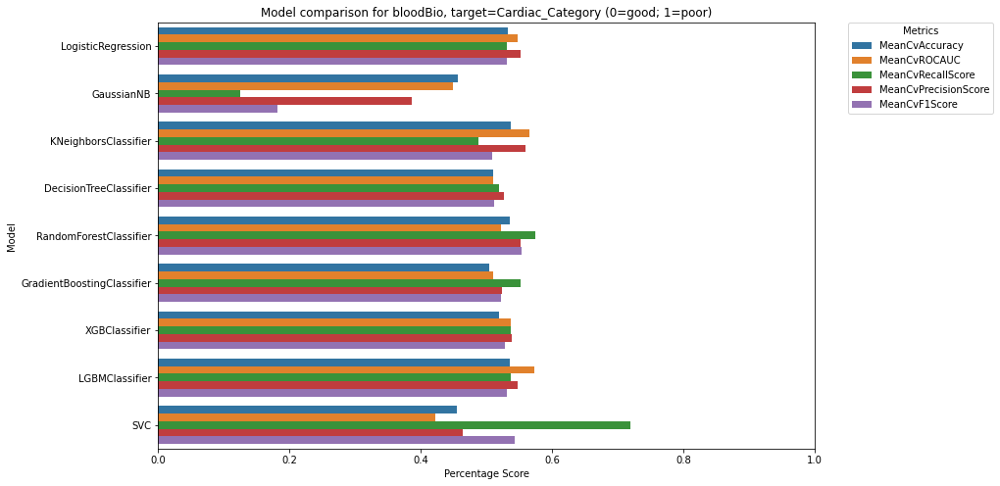

***********************************************
Comparing models for Model comparison for physFuncParams, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
Fitness_score    6.98
WHR              5.81
Lean_T           5.81
Lean_RL          5.81
Lean_LL          5.81
Lean_RA          5.81
Lean_LA          5.81
BMR              5.81
ALM              5.81
PBF              5.81
BFM              5.81
SMM              5.81
G1L              1.16
G2R              1.16
G1R              1.16
G2L              1.16
Gripmax          1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.551242      0.574228   
0                  Gaussian

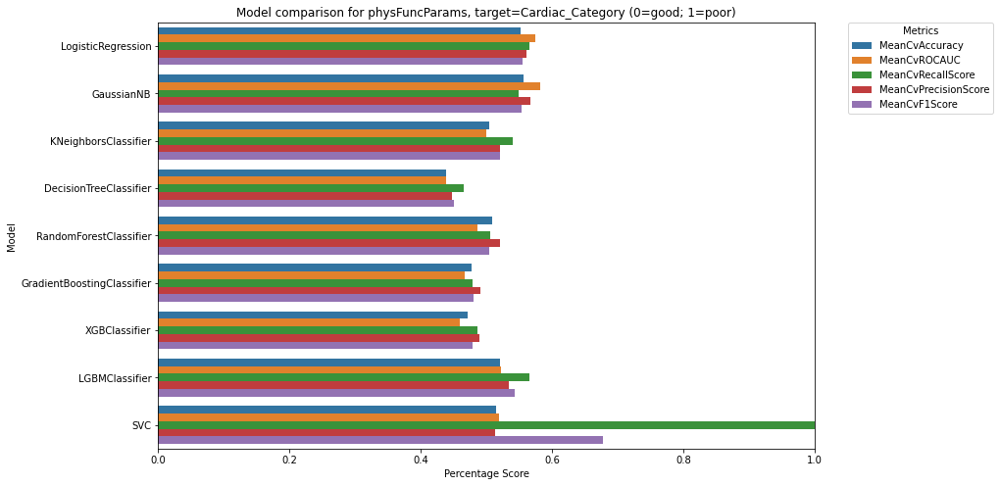

***********************************************
Comparing models for Model comparison for curMeta, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C24             13.95
C26             13.95
C28             13.95
Leu1            13.95
C102             6.98
C203OHC183DC     3.49
C183             2.33
C51              1.16
C101             1.16
C143OHC123DC     1.16
C163OHC143DC     1.16
C202OHC182DC     1.16
C225             1.16
C223             1.16
C222             1.16
dtype: float64
Original Shape:(86, 88)
Final Shape:(86, 88)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.497255      0.488025   
0                  GaussianNB        0.469739      0.454954   
0        KNeigh

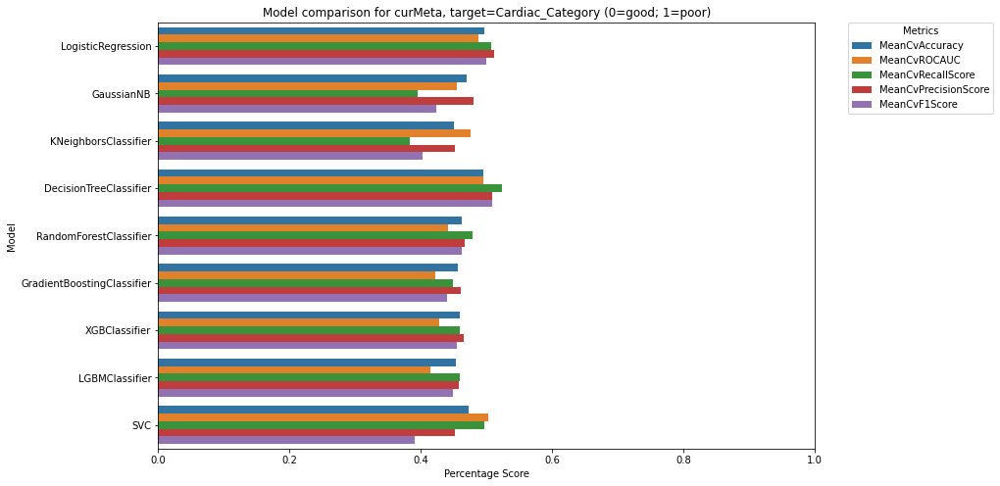

***********************************************
Comparing models for Model comparison for histMeta, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  1
These columns are:
 ['HistoCode']
Columns with missing values (%):
HistoCode    100.00
HistoC51       2.33
HistoC223      1.16
dtype: float64
Original Shape:(86, 86)
Final Shape:(86, 85)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.465229      0.437315   
0                  GaussianNB        0.495229      0.513179   
0        KNeighborsClassifier        0.547582      0.554784   
0      DecisionTreeClassifier        0.498431      0.499028   
0      RandomForestClassifier        0.524902      0.538318   
0  GradientBoostingClassifier        0.523856      0.528364   
0               XGBCl

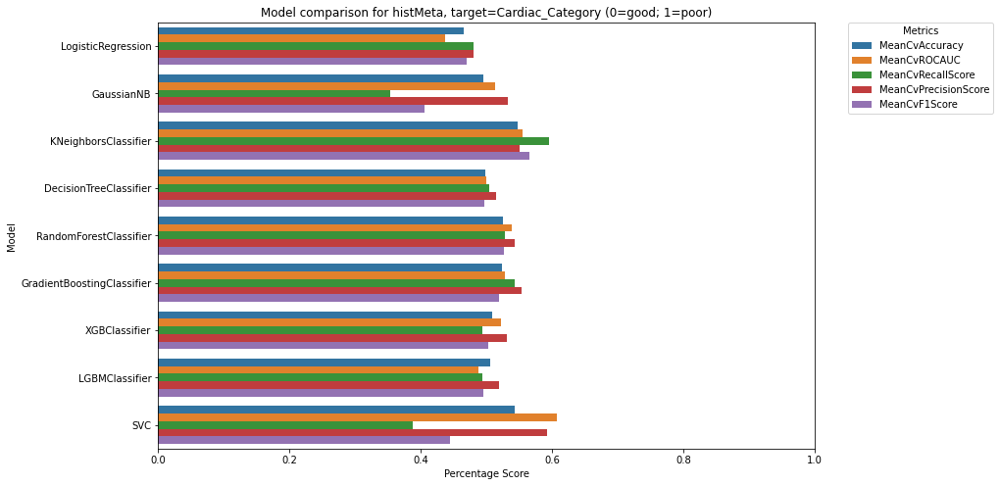

***********************************************


In [15]:
# Cell 9.5
warnings.filterwarnings(action='ignore', category=UserWarning)

# Use of each group of features to classify cardiac category

targetFeat = "Cardiac_Category (0=good; 1=poor)"
for key in cc_dfDict:
    compareClasModelVer2(cc_dfDict[key],targetFeat,title=f"Model comparison for {key}, target={targetFeat}",showImportance = True,key=key,saveFile=True)

(86, 228)
Comparing models for Model comparison for full data except cmr and echo, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Gender column contains only 2 values. Converting to binary
Male
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  1
These columns are:
 ['HistoCode']
Columns with missing values (%):
HistoCode        100.00
Leu1              13.95
C28               13.95
C26               13.95
C24               13.95
Fitness_score      6.98
C102               6.98
ALM                5.81
Lean_T             5.81
BNP                5.81
Lean_LL            5.81
Lean_RA            5.81
Lean_LA            5.81
BMR                5.81
Lean_RL            5.81
WHR                5.81
PBF                5.81
BFM                5.81
SMM                5.81
GALECTIN3          5.81
HSTNI              4.65
C203OHC183DC       3.49
HistoC51           2.33
C183               2.33
MMP9ngmL     

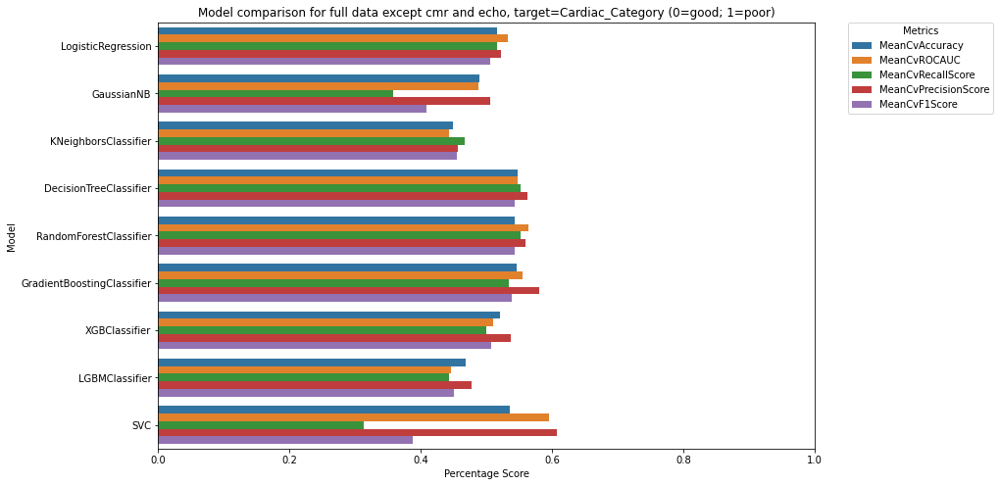

***********************************************


,Model,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.516078,0.531944,0.515556,0.521358,0.505937
0,GaussianNB,0.489346,0.488056,0.357222,0.504885,0.407981
0,KNeighborsClassifier,0.448954,0.443565,0.466389,0.456805,0.455193
0,DecisionTreeClassifier,0.547582,0.546806,0.551389,0.562961,0.542742
0,RandomForestClassifier,0.543333,0.564444,0.551389,0.559069,0.542991
0,GradientBoostingClassifier,0.545817,0.554259,0.534167,0.579866,0.537792
0,XGBClassifier,0.521046,0.510278,0.499167,0.536997,0.506601
0,LGBMClassifier,0.468235,0.445494,0.443056,0.476590,0.450831
0,SVC,0.536144,0.594660,0.312500,0.606552,0.387324


In [16]:
# Cell 14
# Since echo and cmr are already the gold standard for clinical evaluation, we now want to see if there are other features that can be used to predict cardiac category
# Also list down the most important features that we can combine to make a smaller and more curated set of features
# Classification on the whole dataset except for echo and cmr. Poor predictive power

data_trunc = data_full.drop(echoCols+cmrCols, axis=1)
print(data_trunc.shape) 
targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(data_trunc,targetFeat,title=f"Model comparison for full data except cmr and echo, target={targetFeat}",showImportance = True,key="full data except cmr and echo",saveFile=False)

In [17]:
# Cell 15 Ver 2.0: Self made
# Manually combine most important features
"""
selfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
curatedDf = data_full[selfMadeCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(curatedDf,targetFeat,title=f"Model comparison for curated data, target={targetFeat}",showImportance=True)
"""

'\nselfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]\ncuratedDf = data_full[selfMadeCols]\n\n\ntargetFeat = "Cardiac_Category (0=good; 1=poor)"\ncompareClasModelVer2(curatedDf,targetFeat,title=f"Model comparison for curated data, target={targetFeat}",showImportance=True)\n'

In [18]:
# Using random forest top 10 features: ['HistoC162','HistoC143NDOHC123NDDC','HistoHis1_ConcµM','C222','Pulse','Cit1','HistoC10','VO2Max','HistoC203NDOHC183NDDC','HistoC143']
"""
selfMadeCols = ['HistoC162','HistoC143NDOHC123NDDC','HistoHis1_ConcµM','C222','Pulse','Cit1','HistoC10','VO2Max','HistoC203NDOHC183NDDC','HistoC143',"Cardiac_Category (0=good; 1=poor)"]
randomForestTop10 = data_full[selfMadeCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(randomForestTop10,targetFeat,title=f"Model comparison for randomForestTop10, target={targetFeat}",showImportance=True)
"""


'\nselfMadeCols = [\'HistoC162\',\'HistoC143NDOHC123NDDC\',\'HistoHis1_ConcµM\',\'C222\',\'Pulse\',\'Cit1\',\'HistoC10\',\'VO2Max\',\'HistoC203NDOHC183NDDC\',\'HistoC143\',"Cardiac_Category (0=good; 1=poor)"]\nrandomForestTop10 = data_full[selfMadeCols]\n\n\ntargetFeat = "Cardiac_Category (0=good; 1=poor)"\ncompareClasModelVer2(randomForestTop10,targetFeat,title=f"Model comparison for randomForestTop10, target={targetFeat}",showImportance=True)\n'

Comparing models for Model comparison for Important Features Dataset, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28      13.95
C102      6.98
WHR       5.81
HSTNI     4.65
qTL       1.16
C101      1.16
C222      1.16
dtype: float64
Original Shape:(86, 31)
Final Shape:(86, 31)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.585229      0.593364   
0                  GaussianNB        0.566928      0.615293   
0        KNeighborsClassifier        0.506013      0.540463   
0      DecisionTreeClassifier        0.589216      0.588750   
0      RandomForestClassifier        0.716797      0.763349   
0  GradientBoostingClassifier        0.647778      0.718395   
0               X

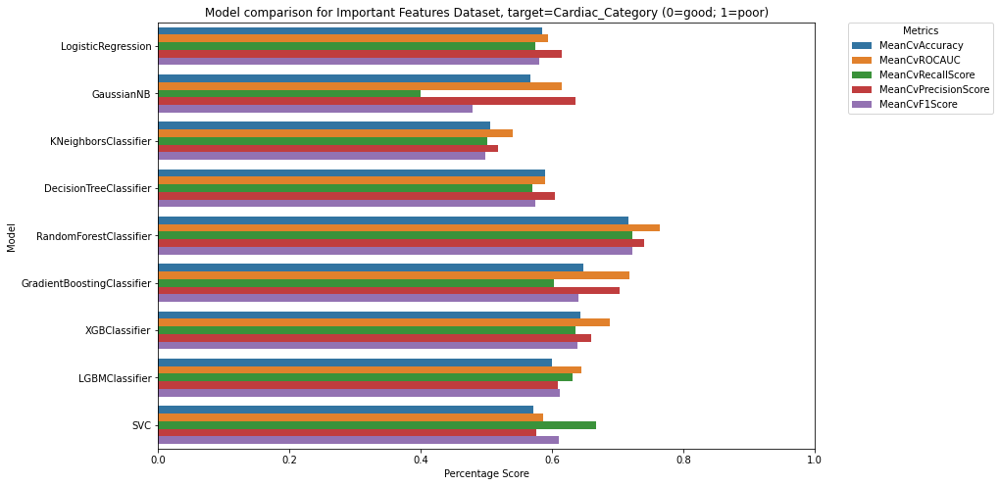

***********************************************


,Model,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.585229,0.593364,0.575000,0.614209,0.580281
0,GaussianNB,0.566928,0.615293,0.399444,0.635716,0.478463
0,KNeighborsClassifier,0.506013,0.540463,0.501111,0.517053,0.498279
0,DecisionTreeClassifier,0.589216,0.588750,0.570556,0.604481,0.574174
0,RandomForestClassifier,0.716797,0.763349,0.722500,0.739538,0.722154
0,GradientBoostingClassifier,0.647778,0.718395,0.601944,0.702744,0.640555
0,XGBClassifier,0.642353,0.688333,0.635556,0.658747,0.638526
0,LGBMClassifier,0.599150,0.644352,0.631389,0.608241,0.610998
0,SVC,0.571307,0.586481,0.667222,0.575174,0.610476


In [19]:
# Combine top 10 features from each model, dropping repeated features
# NO LONGER THE BEST. DONT USE THIS FEATURE SET
selfMadeCols =  ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']
combinedTopFeatImportanceDf = data_full[selfMadeCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(combinedTopFeatImportanceDf,targetFeat,title=f"Model comparison for Important Features Dataset, target={targetFeat}",showImportance=True,key="Important Features Dataset",saveFile=True)

In [7]:
#mylist = ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101','C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C5OHC3DC', 'C102', 'Pulse','HistoC162', 'C5OHC3DC', 'VO2Max', 'Pulse', 'HistoC203NDOHC183NDDC', 'C5DC', 'HistoC121NDOH', 'C28', 'Cit1', 'Tyr1','VO2Max', 'HistoC162', 'C5OHC3DC', 'WHR', 'HistoC163NDOHC143NDDC', 'Pulse', 'C81', 'HistoC162', 'HistoC143NDOHC123NDDC', 'HistoHis1_ConcµM', 'C222', 'Pulse', 'Cit1', 'HistoC10', 'VO2Max', 'HistoC203NDOHC183NDDC', 'HistoC143','HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC',"Cardiac_Category (0=good; 1=poor)"]
mylist = ['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10', 'HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC','HistoC162', 'Hips_Circumference__cm', 'VO2Max', 'HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'C224', 'C5DC', 'HistoC121NDOH', 'WHR','HistoC162', 'Hips_Circumference__cm', 'VO2Max', 'C224', 'Pulse', 'HistoC121NDOH', 'HistoC203NDOHC183NDDC', 'C28', 'HistoC16', 'WHR','VO2Max', 'HistoC162', 'Tyr1', 'Hips_Circumference__cm', 'HistoC121NDOH', 'HistoC143', 'C5DC', 'C102', 'C28', 'C81','HistoC203NDOHC183NDDC', 'HistoC143NDOHC123NDDC', 'WHR', 'HistoC16', 'C222', 'C224', 'Hips_Circumference__cm', 'C101', 'Tyr1', 'HistoC102',"Cardiac_Category (0=good; 1=poor)"]
uniqueFeaturesList = list(dict.fromkeys(mylist))
print(uniqueFeaturesList)
print(len(uniqueFeaturesList))


['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10', 'HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'VO2Max', 'HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'C5DC', 'HistoC121NDOH', 'WHR', 'C102', 'C81', 'C101', 'HistoC102', 'Cardiac_Category (0=good; 1=poor)']
22


Comparing models for Model comparison for Dataset of 21 Important Features , target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
C102     6.98
WHR      5.81
C222     1.16
C101     1.16
dtype: float64
Original Shape:(86, 21)
Final Shape:(86, 21)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.586928      0.611636   
0                  GaussianNB        0.623333      0.681080   
0        KNeighborsClassifier        0.555882      0.611806   
0      DecisionTreeClassifier        0.639477      0.639028   
0      RandomForestClassifier        0.720523      0.774537   
0  GradientBoostingClassifier        0.691895      0.744228   
0               XGBClassifier        0.675033

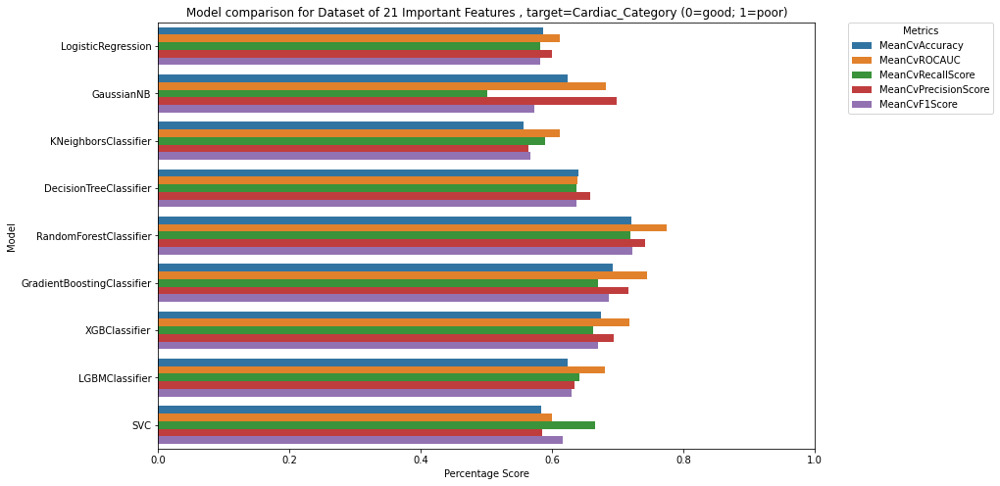

***********************************************


,Model,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.586928,0.611636,0.581944,0.599331,0.581188
0,GaussianNB,0.623333,0.681080,0.501389,0.698952,0.572794
0,KNeighborsClassifier,0.555882,0.611806,0.589444,0.564170,0.566755
0,DecisionTreeClassifier,0.639477,0.639028,0.636389,0.658416,0.636858
0,RandomForestClassifier,0.720523,0.774537,0.719444,0.740882,0.721742
0,GradientBoostingClassifier,0.691895,0.744228,0.669167,0.716107,0.685757
0,XGBClassifier,0.675033,0.717593,0.661667,0.693847,0.670529
0,LGBMClassifier,0.623595,0.680278,0.641389,0.634216,0.629934
0,SVC,0.583987,0.599815,0.664722,0.584892,0.615771


In [5]:
# Combine top 10 features from each model, dropping repeated features. 21 Features
top10FeaturesCombined =  ['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10', 'HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'VO2Max', 'HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'C5DC', 'HistoC121NDOH', 'WHR', 'C102', 'C81', 'C101', 'HistoC102', 'Cardiac_Category (0=good; 1=poor)']
combinedTopFeatImportanceDf = data_full[top10FeaturesCombined]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(combinedTopFeatImportanceDf,targetFeat,title=f"Model comparison for Dataset of 21 Important Features , target={targetFeat}",showImportance=True,key="Dataset of 21 Important Features",saveFile=True)

df.shape: (86, 22)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
C102     6.98
WHR      5.81
C222     1.16
C101     1.16
dtype: float64
Original Shape:(86, 21)
Final Shape:(86, 21)
______________________________
Initialising models...
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estim

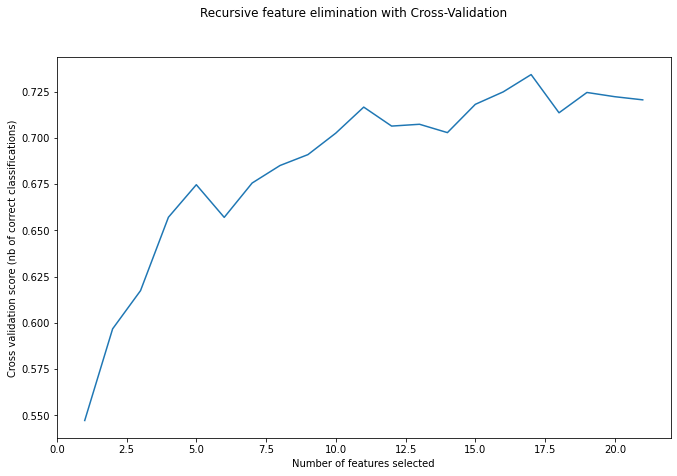

Index(['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10',
       'HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'VO2Max',
       'HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'HistoC121NDOH', 'WHR',
       'C81', 'C101'],
      dtype='object')


In [8]:
#https://scikit-learn.org/stable/auto_examples/feature_selection/plot_rfe_with_cross_validation.html#sphx-glr-auto-examples-feature-selection-plot-rfe-with-cross-validation-py
#topFeatImptCols =  ['Cit1', 'HistoC143NDOHC123NDDC', 'HistoC16', 'qTL', 'WHR', 'Pulse', 'HistoC18NDOHC16NDDC', 'C224', 'C5OHC3DC', 'C101', 'C5DC', 'HistoC162', 'C4OH', 'VO2Max', 'Hips_Circumference__cm', 'HistoC12', 'HSTNI', 'C102', 'HistoC203NDOHC183NDDC', 'HistoC121NDOH', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'C81', 'HistoHis1_ConcµM', 'C222', 'HistoC10', 'HistoC143', 'HistoC102', 'HistoC103', 'HistoC8NDOHC6NDDC', 'Cardiac_Category (0=good; 1=poor)']
topFeatImptCols = uniqueFeaturesList
combinedTopFeatImportanceDf = data_full[topFeatImptCols]

df = combinedTopFeatImportanceDf
print(f"df.shape: {df.shape}") 
targetFeat = "Cardiac_Category (0=good; 1=poor)"

min_features_to_select = 1

y = df[targetFeat]
df = df.drop(targetFeat, axis = 1)
x = preprocessDf(df,verbose=True)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
print("Initialising models...")
rfecv  = RFECV(estimator=RandomForestClassifier(random_state=1,verbose=False), min_features_to_select=min_features_to_select,cv=cv,scoring='accuracy',verbose=1)
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns
xImputed = x.fillna(x.median())
rfecv.fit(xImputed, y)

print("Optimal number of features : %d" % rfecv.n_features_)

# Plot number of features VS. cross-validation scores
fig = plt.figure(figsize=(11,7))
fig.suptitle('Recursive feature elimination with Cross-Validation')
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (nb of correct classifications)")
plt.plot(range(min_features_to_select,
               len(rfecv.grid_scores_) + min_features_to_select),
         rfecv.grid_scores_)
plt.savefig(f'Outputs/RFECV.png')
plt.show()

optimisedFeatureSet = x[x.columns[rfecv.support_]]
print(optimisedFeatureSet.columns)

In [10]:
optimisedFeatureSet
#optimisedFeatureSet = ['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10','HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'VO2Max','HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'HistoC121NDOH', 'WHR','C81', 'C101']



,C224,HistoC162,Hips_Circumference__cm,HistoC10,HistoC203NDOHC183NDDC,HistoC16,C222,C28,Tyr1,VO2Max,HistoC143NDOHC123NDDC,HistoC143,Pulse,HistoC121NDOH,WHR,C81,C101
0,0.327496,5.825521,83,152.334944,1.531742,159.937042,0.163748,0.163748,35.929000,46,1.093284,2.623883,67,11.659808,0.81,209.716251,61.172977
1,0.255475,6.355114,87,193.719807,3.501126,189.770773,0.645214,2.512645,82.686000,25,1.311941,3.279854,79,10.288066,0.94,54.368531,56.030594
2,1.210456,8.257396,94,279.731993,3.486705,192.489073,0.032568,2.543838,102.497000,36,1.337505,5.350022,76,26.124197,0.91,258.735010,73.088843
3,1.517177,2.742366,84,79.951100,2.301413,111.340048,1.007104,2.491666,88.039000,47,0.444364,1.777456,72,8.892025,0.84,46.843553,47.848728
4,1.023167,4.941198,93,67.200000,1.088249,103.235753,0.500794,1.770842,93.277000,39,0.876414,3.067448,80,7.108681,0.85,117.725252,34.552539
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81,0.612538,5.301907,98,136.430318,3.452120,104.392721,0.308199,NaN,29.326996,28,1.333092,4.443641,60,22.230064,0.88,247.551132,46.735701
82,1.058953,5.669260,83,275.288286,1.503059,155.024022,0.679710,0.735478,57.147000,30,0.889558,4.646567,78,27.372079,0.86,561.189800,334.492083
83,1.309984,7.678624,93,288.508557,1.841131,118.104550,1.637480,0.654992,88.356000,38,1.110910,8.220735,62,10.797459,0.78,125.967326,153.080921
84,1.162822,7.156410,90,322.613065,1.627129,152.119582,0.494171,2.863913,33.836000,28,1.114588,3.789599,76,9.992862,0.90,128.957961,140.793881


In [37]:
#optimisedFeatureSet.columns + 

#['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10','HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'VO2Max','HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'HistoC121NDOH', 'WHR','C81', 'C101']
finalModelComparison = pd.DataFrame(columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
randomStateInt = 1
optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]



#print(optimisedCols)
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[optimisedCols]
#print(df)
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=randomStateInt,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

model = RandomForestClassifier(random_state=1,verbose=False)#.fit(xTrain,yTrain)


#model = make_pipeline(StackingEstimator(estimator=ExtraTreesClassifier(bootstrap=False, criterion="gini", max_features=0.15000000000000002, min_samples_leaf=1, min_samples_split=14, n_estimators=100)),StackingEstimator(estimator=ExtraTreesClassifier(bootstrap=False, criterion="gini", max_features=0.1, min_samples_leaf=1, min_samples_split=8, n_estimators=100)),StackingEstimator(estimator=SGDClassifier(alpha=0.01, eta0=0.01, fit_intercept=True, l1_ratio=0.5, learning_rate="invscaling", loss="squared_hinge", penalty="elasticnet", power_t=1.0)),GradientBoostingClassifier(learning_rate=0.1, max_depth=2, max_features=0.5, min_samples_leaf=8, min_samples_split=11, n_estimators=100, subsample=0.9000000000000001))

# Fix random state for all the steps in exported pipeline
#set_param_recursive(exported_pipeline.steps, 'random_state', 1)

model.fit(xTrain,yTrain)
yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=randomStateInt)
xImputed = x.fillna(x.median())

cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvRocAucScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='roc_auc')
cvRecallScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='recall')
cvPrecisionScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='precision')
cvF1ScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='f1')

cvAccuracyScore = cvAccuracyScoreArray.mean()
cvRocAucScore = cvRocAucScoreArray.mean()
cvRecallScore = cvRecallScoreArray.mean()
cvPrecisionScore = cvPrecisionScoreArray.mean()
cvF1Score = cvF1ScoreArray.mean()

result = pd.DataFrame([["RandomForestClassifier",cvAccuracyScore,cvRocAucScore,cvRecallScore,cvPrecisionScore,cvF1Score]],columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])

finalModelComparison.append(["RandomForestClassifier",cvAccuracyScore,cvRocAucScore,cvRecallScore,cvPrecisionScore,cvF1Score])

print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
print(f"cvRocAucScore: {cvRocAucScore}")
print(f"cvRecallScore: {cvRecallScore}")
print(f"cvPrecisionScore: {cvPrecisionScore}")
print(f"cvF1Score: {cvF1Score}")
print(result)
print(cvAccuracyScoreArray)



Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
C102     6.98
WHR      5.81
C222     1.16
C101     1.16
dtype: float64
Original Shape:(86, 21)
Final Shape:(86, 21)
______________________________
Initialising models...
Accuracy: 0.6923076923076923
Predictions: 
[0 1 1 0 1 1 1 1 1 1 0 0 1 0 1 0 0 1 0 0 0 0 1 1 0 0]
Answers: 
[0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]
cvAccuracyScore: 0.7205228758169936
cvRocAucScore: 0.7745370370370371
cvRecallScore: 0.7194444444444444
cvPrecisionScore: 0.7408821178821179
cvF1Score: 0.7217424555149015
                    Model  MeanCvAccuracy  MeanCvROCAUC  MeanCvRecallScore  \
0  RandomForestClassifier        0.720523      0.774537           0.719444   

   MeanCvPrecisionScore  MeanCvF1Score  
0              0.740882       0.721742  
[0.66666667 0.70588235 0.52941176

In [42]:

#optimisedFeatureSet = ['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10','HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'VO2Max','HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'HistoC121NDOH', 'WHR','C81', 'C101',"Cardiac_Category (0=good; 1=poor)"]
randomStateInt = 1
optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]

# 22 instead of 17
#optimisedCols = ['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10', 'HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'HistoC163NDOHC143NDDC', 'VO2Max', 'HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'C5DC', 'HistoC121NDOH', 'WHR', 'C102', 'C81', 'C101', 'HistoC102', 'Cardiac_Category (0=good; 1=poor)']



#print(optimisedCols)
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[optimisedCols]
#print(df)
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=randomStateInt,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

#********************************************************************
#model = RandomForestClassifier(random_state=1,verbose=False)#.fit(xTrain,yTrain)
#********************************************************************
"""
#********************************************************************
# Average CV score on the training set was: 0.8038562091503267
model = GradientBoostingClassifier(learning_rate=0.1, max_depth=4, max_features=0.1, min_samples_leaf=4, min_samples_split=11, n_estimators=100, subsample=0.7000000000000001)
# Fix random state in exported estimator
if hasattr(model, 'random_state'):
    setattr(model, 'random_state', randomStateInt)
#********************************************************************
"""
#********************************************************************
# Average CV score on the training set was: 0.8050980392156863
model = make_pipeline(
    RobustScaler(),
    GradientBoostingClassifier(learning_rate=0.1, max_depth=5, max_features=0.1, min_samples_leaf=4, min_samples_split=12, n_estimators=100, subsample=0.7500000000000001)
)
# Fix random state for all the steps in exported pipeline
set_param_recursive(model.steps, 'random_state', randomStateInt)
#********************************************************************

model.fit(xTrain,yTrain)
yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=randomStateInt)
xImputed = x.fillna(x.median())

cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvRocAucScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='roc_auc')
cvRecallScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='recall')
cvPrecisionScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='precision')
cvF1ScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='f1')

cvAccuracyScore = cvAccuracyScoreArray.mean()
cvRocAucScore = cvRocAucScoreArray.mean()
cvRecallScore = cvRecallScoreArray.mean()
cvPrecisionScore = cvPrecisionScoreArray.mean()
cvF1Score = cvF1ScoreArray.mean()


result = pd.DataFrame([[model.__class__.__name__ + " (TPOT)",cvAccuracyScore,cvRocAucScore,cvRecallScore,cvPrecisionScore,cvF1Score]],columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
#finalModelComparison.append(result)
print(f"randomStateInt: {randomStateInt}")
print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
print(f"cvRocAucScore: {cvRocAucScore}")
print(f"cvRecallScore: {cvRecallScore}")
print(f"cvPrecisionScore: {cvPrecisionScore}")
print(f"cvF1Score: {cvF1Score}")
print(cvAccuracyScoreArray)
print(result)

Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
WHR      5.81
C222     1.16
C101     1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
randomStateInt: 1
Accuracy: 0.6923076923076923
Predictions: 
[0 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 0 0 1 0 0 1 1 1 1 1]
Answers: 
[0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]
cvAccuracyScore: 0.8050980392156863
cvRocAucScore: 0.8516049382716048
cvRecallScore: 0.7969444444444442
cvPrecisionScore: 0.8257748917748917
cvF1Score: 0.8033147933937407
[0.72222222 0.82352941 0.58823529 0.88235294 0.88235294 0.72222222
 0.70588235 0.88235294 0.94117647 0.52941176 0.66666667 0.94117647
 0.82352941 0.88235294 0.82352941 0.83333333 0.88235294 0.82352941
 0.70588235 1.         0.77777778 0.88235294 0.88235294 0.82352941


In [84]:
finalModelComparison

,Model,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score


In [12]:
"""# RFECV For all columns except echo and cmr
df = data_full.drop(echoCols+cmrCols, axis=1)
print(df.shape) 
targetFeat = "Cardiac_Category (0=good; 1=poor)"

min_features_to_select = 1

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)
cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
print("Initialising models...")
rfecv  = RFECV(estimator=RandomForestClassifier(random_state=1,verbose=False), min_features_to_select=min_features_to_select,cv=cv,scoring='accuracy',verbose=1)
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns
xImputed = x.fillna(x.median())
rfecv.fit(xImputed, y)

print("Optimal number of features : %d" % rfecv.n_features_)

# Plot number of features VS. cross-validation scores
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (nb of correct classifications)")
plt.plot(range(min_features_to_select,
               len(rfecv.grid_scores_) + min_features_to_select),
         rfecv.grid_scores_)
plt.show()

optimisedFeatureSet = x[x.columns[rfecv.support_]]
print(optimisedFeatureSet.columns)"""


'# RFECV For all columns except echo and cmr\ndf = data_full.drop(echoCols+cmrCols, axis=1)\nprint(df.shape) \ntargetFeat = "Cardiac_Category (0=good; 1=poor)"\n\nmin_features_to_select = 1\n\ny = df[target]\ndf = df.drop(target, axis = 1)\nx = preprocessDf(df,verbose=True)\ncv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)\nprint("Initialising models...")\nrfecv  = RFECV(estimator=RandomForestClassifier(random_state=1,verbose=False), min_features_to_select=min_features_to_select,cv=cv,scoring=\'accuracy\',verbose=1)\n#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns\nxImputed = x.fillna(x.median())\nrfecv.fit(xImputed, y)\n\nprint("Optimal number of features : %d" % rfecv.n_features_)\n\n# Plot number of features VS. cross-validation scores\nplt.figure()\nplt.xlabel("Number of features selected")\nplt.ylabel("Cross validation score (nb of correct classifications)")\nplt.plot(range(min_features_to_select,\n   

Comparing models for Model comparison for Feature-Engineered Dataset, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
WHR      5.81
C222     1.16
C101     1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0          LogisticRegression        0.623007      0.651173   
0                  GaussianNB        0.700261      0.751327   
0        KNeighborsClassifier        0.548824      0.602052   
0      DecisionTreeClassifier        0.637451      0.637361   
0      RandomForestClassifier        0.757647      0.823611   
0  GradientBoostingClassifier        0.708105      0.767716   
0               XGBClassifier        0.693595      0.738117   
0  

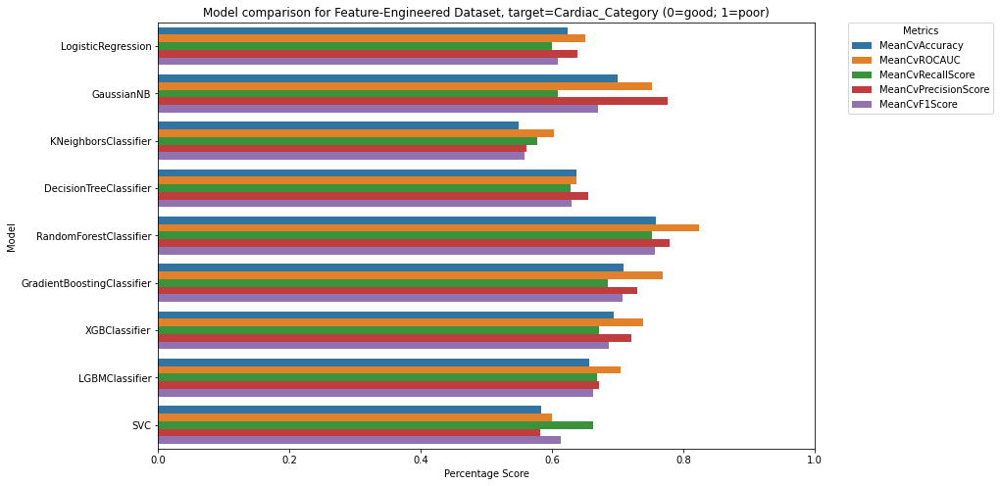

***********************************************


,Model,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,LogisticRegression,0.623007,0.651173,0.599167,0.638569,0.608993
0,GaussianNB,0.700261,0.751327,0.608333,0.775955,0.669433
0,KNeighborsClassifier,0.548824,0.602052,0.577778,0.560610,0.558594
0,DecisionTreeClassifier,0.637451,0.637361,0.628056,0.655042,0.630166
0,RandomForestClassifier,0.757647,0.823611,0.751389,0.779260,0.757085
0,GradientBoostingClassifier,0.708105,0.767716,0.685278,0.729963,0.707813
0,XGBClassifier,0.693595,0.738117,0.670833,0.721345,0.686642
0,LGBMClassifier,0.656405,0.704228,0.668611,0.670718,0.662368
0,SVC,0.582810,0.599259,0.662500,0.582186,0.613530


In [20]:
optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]
featureEngineeredDf = data_full[optimisedCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModelVer2(featureEngineeredDf,targetFeat,title=f"Model comparison for Feature-Engineered Dataset, target={targetFeat}",key="Feature-Engineered Dataset",saveFile=True,showImportance=True)

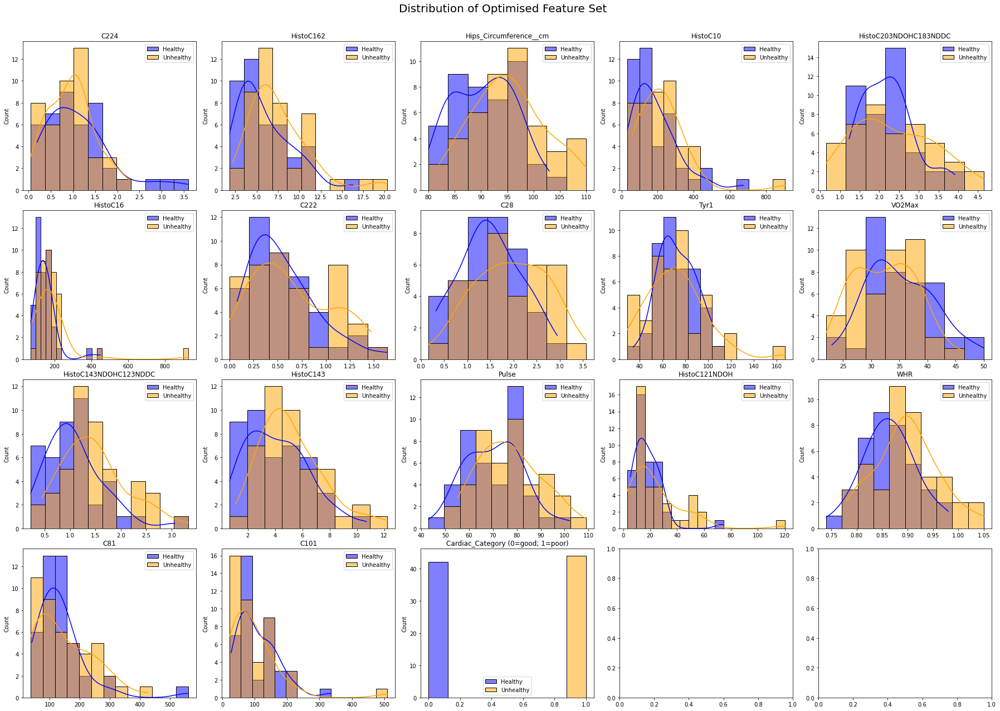

In [46]:
title = "Distribution of Optimised Feature Set"
optimisedCols = optimisedFeatureSet.columns.tolist() + ["Cardiac_Category (0=good; 1=poor)"]
featureEngineeredDf = data_full[optimisedCols]

mainDf = preprocessDf(featureEngineeredDf,verbose=False)
healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
numberOfCols = len(mainDf.columns)
PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

#bins = np.histogram_bin_edges(healthyDf, bins='auto')
width = max(mainDf.shape[1]*1.5,14)
height = max(mainDf.shape[1],7)
fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
#fig.subplots_adjust(top=width)

for idx,column in enumerate(mainDf.columns):
    #plt.figure()    
    # use bins of mainDf, dropping na values in the process         
    bins = np.histogram_bin_edges(mainDf[column].dropna().values, bins='auto')       
    sns.histplot(healthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Healthy",kde=True,color="blue",bins=bins).set(xlabel=None,title=column)
    sns.histplot(unhealthyDf[column],ax=axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW],label="Unhealthy",kde=True,color="orange",bins=bins).set(xlabel=None,title=column)
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].legend()
    #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
#plt.tight_layout()
fig.suptitle(title,fontsize=20, ha='center', va ='center')
#fig.savefig(f'Outputs/DistributionPlots/Optimised_Feature_Set_distribution.png')
plt.show()

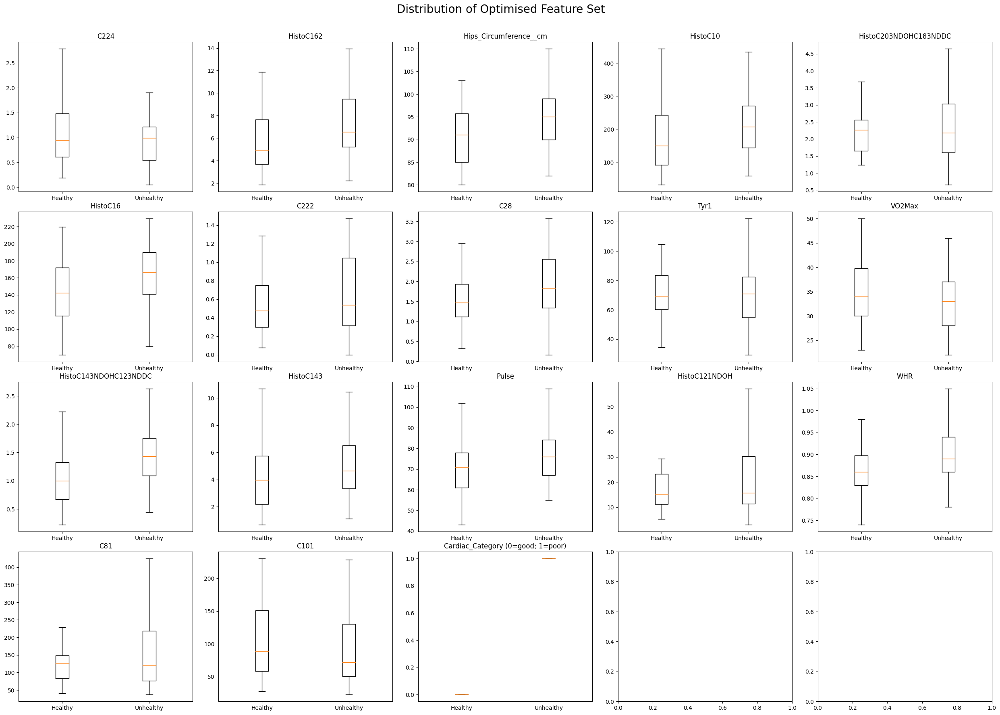

In [29]:
title = "Distribution of Optimised Feature Set"
optimisedCols = ['C224', 'HistoC162', 'Hips_Circumference__cm', 'HistoC10','HistoC203NDOHC183NDDC', 'HistoC16', 'C222', 'C28', 'Tyr1', 'VO2Max','HistoC143NDOHC123NDDC', 'HistoC143', 'Pulse', 'HistoC121NDOH', 'WHR','C81', 'C101'] + ["Cardiac_Category (0=good; 1=poor)"]
featureEngineeredDf = data_full[optimisedCols]

mainDf = preprocessDf(featureEngineeredDf,verbose=False)
healthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 0]
unhealthyDf = mainDf[mainDf["Cardiac_Category (0=good; 1=poor)"] == 1]
numberOfCols = len(mainDf.columns)
PLOTS_PER_ROW = math.ceil(np.sqrt(mainDf.shape[1]))

#bins = np.histogram_bin_edges(healthyDf, bins='auto')
width = max(mainDf.shape[1]*1.5,14)
height = max(mainDf.shape[1],7)
fig, axes = plt.subplots(math.ceil(numberOfCols/PLOTS_PER_ROW), PLOTS_PER_ROW,figsize=(25,18))
fig.tight_layout(pad=1.5,rect=[0, 0, 1, 0.95])
#fig.subplots_adjust(top=width)

for idx,column in enumerate(mainDf.columns):
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].boxplot([healthyDf[column][~np.isnan(healthyDf[column])],unhealthyDf[column][~np.isnan(unhealthyDf[column])]],sym='')
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].set_xticklabels(["Healthy", "Unhealthy"])
    axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW].set_title(column)
    #axes[idx//PLOTS_PER_ROW, idx%PLOTS_PER_ROW]
#plt.tight_layout()
fig.suptitle(title,fontsize=20, ha='center', va ='center')
fig.savefig(f'Outputs/BoxPlots/Optimised_Feature_Set_boxplot.png')
plt.show()

In [47]:
def compareFinalClasModelVer(df,target,test_size=0.25,title="Dataset",showImportance=False,confusionMatrix=False,key="",saveFile=False):
    randomStateInt = 1
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df,verbose=True)
    # Note here that imputation in this manner would lead to some data leakages into the test set
    # during the cross validation process. Data for imputation should ideally be confined to
    # the train set within each fold. 
    # However, for sake of expediency, I am just going to impute using the whole data
    imputedX = x.fillna(x.median())
    print("Initialising models...")
    #xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=1)
    #xTrain = xTrain.fillna(xTrain.median())
    #xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns
    rfc = RandomForestClassifier(random_state=randomStateInt,verbose=False)
    tpotModel = GradientBoostingClassifier(learning_rate=0.1, max_depth=4, max_features=0.1, min_samples_leaf=4, min_samples_split=11,n_estimators=100, subsample=0.7000000000000001)
    # Fix random state in exported estimator
    if hasattr(tpotModel, 'random_state'):
        setattr(tpotModel, 'random_state', randomStateInt)
    
    tpotModel2 = make_pipeline(
        RobustScaler(),
        GradientBoostingClassifier(learning_rate=0.1, max_depth=5, max_features=0.1, min_samples_leaf=4, min_samples_split=12, n_estimators=100, subsample=0.7500000000000001)
    )
    # Fix random state for all the steps in exported pipeline
    set_param_recursive(tpotModel2.steps, 'random_state', randomStateInt)
    

    models = [rfc,tpotModel,tpotModel2]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        #model = model.fit(imputedX,y)
        #yPred = model.predict(xTest)

        #accuracy = accuracy_score(yTest,yPred)

        #confusionMatrixArray = confusion_matrix(yTest, predict)
        #plt.figure()
        #plot_roc_curve(model, xTest, yTest)  
        #plt.show()
        
        #imputedX = x.fillna(x.median())
        cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=randomStateInt)

        cvAccuracyScore = cross_val_score(model,imputedX,y,cv=cv,scoring='accuracy').mean()
        cvRocAucScore = cross_val_score(model,imputedX,y,cv=cv,scoring='roc_auc').mean()
        cvRecallScore = cross_val_score(model,imputedX,y,cv=cv,scoring='recall').mean()
        cvPrecisionScore = cross_val_score(model,imputedX,y,cv=cv,scoring='precision').mean()
        cvF1Score = cross_val_score(model,imputedX,y,cv=cv,scoring='f1').mean()
        """
        cvAccuracyScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='accuracy').mean()
        cvRocAucScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='roc_auc').mean()
        cvRecallScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='recall').mean()
        cvPrecisionScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='precision').mean()
        cvF1Score = cross_val_score(model,xTest,yTest,cv=cv,scoring='f1').mean()
        """
        #error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=cv,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,cvAccuracyScore,cvRocAucScore,cvRecallScore,cvPrecisionScore,cvF1Score]],columns=["Model","MeanCvAccuracy","MeanCvROCAUC","MeanCvRecallScore","MeanCvPrecisionScore","MeanCvF1Score"])
        comparison = comparison.append(result)
        
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name + f" Top 20 Feature Importance ({key})",saveFile=True)
            except AttributeError:
                continue
    
    print(comparison)

    comparisonMelted = pd.melt(comparison,id_vars=['Model'])
    plt.figure(figsize=(12,8))

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Percentage Score')
    plt.xlim(0, 1)
    if saveFile:
        plt.savefig(f'Outputs/ModelComparisonsFigures/{title}.png',bbox_inches='tight')
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    if saveFile:
        comparison.to_csv(f"Outputs/ModelComparisonsTables/{title}.csv")
    return comparison

Comparing models for Comparison of best models for Feature-Engineered Dataset, target=Cardiac_Category (0=good; 1=poor)
Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 15 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28     13.95
WHR      5.81
C222     1.16
C101     1.16
dtype: float64
Original Shape:(86, 17)
Final Shape:(86, 17)
______________________________
Initialising models...
                        Model  MeanCvAccuracy  MeanCvROCAUC  \
0      RandomForestClassifier        0.757647      0.823611   
0  GradientBoostingClassifier        0.803856      0.859136   
0                    Pipeline        0.805098      0.851605   

   MeanCvRecallScore  MeanCvPrecisionScore  MeanCvF1Score  
0           0.751389              0.779260       0.757085  
0           0.792500              0.825851       0.801747  
0           0.796944              0.825775       0.803315  


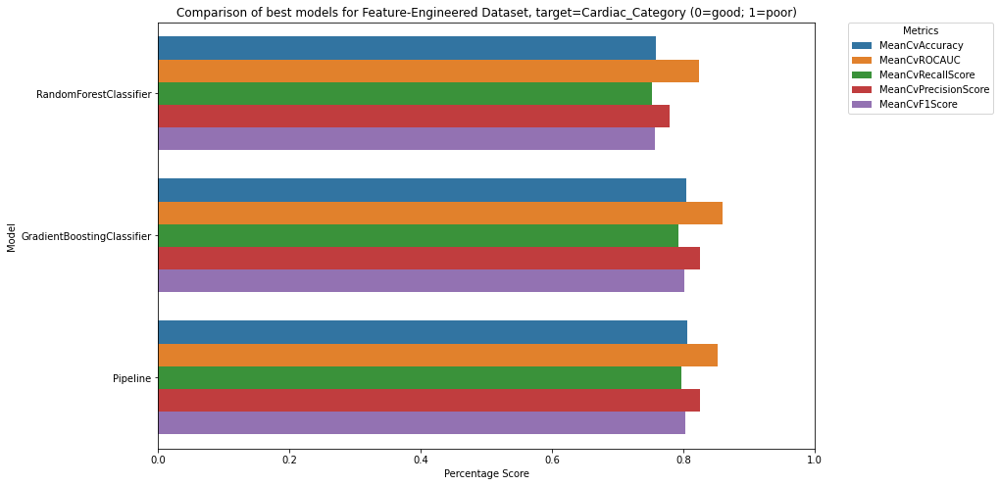

***********************************************


,Model,MeanCvAccuracy,MeanCvROCAUC,MeanCvRecallScore,MeanCvPrecisionScore,MeanCvF1Score
0,RandomForestClassifier,0.757647,0.823611,0.751389,0.779260,0.757085
0,GradientBoostingClassifier,0.803856,0.859136,0.792500,0.825851,0.801747
0,Pipeline,0.805098,0.851605,0.796944,0.825775,0.803315


In [48]:
targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareFinalClasModelVer(featureEngineeredDf,targetFeat,title=f"Comparison of best models for Feature-Engineered Dataset, target={targetFeat}",key="Feature-Engineered Dataset (RandomForest vs TPOT's Models)",saveFile=False,showImportance=True)

In [15]:
# CELLS BELOW ARE OLDER STUFF WITH WRONG/IRRELEVANT PORTIONS

In [16]:
    
def compareClasModel(df,target,test_size=0.25,title="Dataset",showImportance=False,confusionMatrix=False):
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df)
    
    print("Initialising models...")
    xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=1)
    xTrain = xTrain.fillna(xTrain.median())
    xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

    lr = LogisticRegression(solver="liblinear").fit(xTrain,yTrain)
    gnb = GaussianNB().fit(xTrain,yTrain)
    knnc = KNeighborsClassifier().fit(xTrain,yTrain)
    dtc = DecisionTreeClassifier(random_state=1).fit(xTrain,yTrain)
    rfc = RandomForestClassifier(random_state=1,verbose=False).fit(xTrain,yTrain)
    gbmc = GradientBoostingClassifier(verbose=False).fit(xTrain,yTrain)
    xgbc = XGBClassifier(use_label_encoder=False,eval_metric= "error").fit(xTrain,yTrain)
    lgbmc = LGBMClassifier().fit(xTrain,yTrain)
    sv = SVC().fit(xTrain,yTrain)

    models = [lr,gnb,knnc,dtc,rfc,gbmc,xgbc,lgbmc,sv]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","AccuracyScore","MeanR2CVScore","MeanCVError"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        predict = model.predict(xTest)
        accuracy = accuracy_score(yTest,predict)

        #confusionMatrixArray = confusion_matrix(yTest, predict)
        #plot_roc_curve(model, xTest, yTest)  
        #print(confusionMatrixArray)

        r2CV = cross_val_score(model,xTest,yTest,cv=5).mean()
        error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=5,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,accuracy,r2CV,error]],columns=["Model","AccuracyScore","MeanR2CVScore","MeanCVError"])
        comparison = comparison.append(result)
        
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name)
            except AttributeError:
                continue
    
    print(comparison)
    print("\n")
    print(f"Highest Accuracy Score: {comparison.loc[comparison['AccuracyScore'] == comparison['AccuracyScore'].max(), 'Model'].iloc[0]}. Score: {round(comparison['AccuracyScore'].max(),2)}")
    print(f"Highest CV Score: {comparison.loc[comparison['MeanR2CVScore'] == comparison['MeanR2CVScore'].max(), 'Model'].iloc[0]}. Score: {round(comparison['MeanR2CVScore'].max(),2)}")
    print(f"Lowest CV Error: {comparison.loc[comparison['MeanCVError'] == comparison['MeanCVError'].min(), 'Model'].iloc[0]}. Score: {round(comparison['MeanCVError'].min(),2)}")
    print("\n")
    comparisonMelted = pd.melt(comparison,id_vars=['Model'])

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Percentage Score')
    plt.xlim(0, 1)
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    
    return comparison
    
def compareRegModel(df,target,test_size=0.25,title="Dataset",showImportance=False):
    print(f"Comparing models for {title}")
    y = df[target]
    df = df.drop(target, axis = 1)
    x = preprocessDf(df)
    
    print("Predicting " + title)
    xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=test_size,random_state=0)
    xTrain = xTrain.fillna(xTrain.median())
    xTest = xTest.fillna(xTrain.median())
    #https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

    lr = LinearRegression().fit(xTrain,yTrain)
    pls = PLSRegression().fit(xTrain,yTrain)
    ridge = Ridge().fit(xTrain,yTrain)
    lasso = Lasso().fit(xTrain,yTrain)
    elasticnet = ElasticNet().fit(xTrain,yTrain)
    knnr = KNeighborsRegressor().fit(xTrain,yTrain)
    dtr = DecisionTreeRegressor(random_state=0).fit(xTrain,yTrain)
    baggr = BaggingRegressor(random_state=0,bootstrap_features=True,verbose=False).fit(xTrain,yTrain)
    rfr = RandomForestRegressor(random_state=0,verbose=False).fit(xTrain,yTrain)
    gbmr = GradientBoostingRegressor(verbose=False).fit(xTrain,yTrain)
    xgbr = XGBRegressor().fit(xTrain,yTrain)
    lgbmr = LGBMRegressor().fit(xTrain,yTrain)
    sv = SVR().fit(xTrain,yTrain)

    models = [lr,pls,ridge,lasso,elasticnet,knnr,dtr,baggr,rfr,gbmr,xgbr,lgbmr,sv]
    
    # initialise empty dataframe
    comparison = pd.DataFrame(columns=["Model","MeanR2CVScore","MeanR2CVError"])
    # Because dataset is small, we use k-fold cross validation

    for model in models:
        name = model.__class__.__name__
        r2CV = cross_val_score(model,xTest,yTest,cv=5,scoring="r2").mean()
        error = np.sqrt(-cross_val_score(model,xTest,yTest,cv=5,scoring="neg_mean_squared_error").mean())
        result = pd.DataFrame([[name,r2CV,error]],columns=["Model","MeanR2CVScore","MeanR2CVError"])
        comparison = comparison.append(result)
        if showImportance:
            try:
                importance = model.feature_importances_
                plot_feature_importance(importance,xTest.columns.tolist(),name)
            except AttributeError:
                continue
    
    print(comparison)
    print("\n")
    print(f"Highest R2CV Score: {comparison.loc[comparison['MeanR2CVScore'] == comparison['MeanR2CVScore'].max(), 'Model'].iloc[0]}. Score: {round(comparison['MeanR2CVScore'].max(),2)}")
    print(f"Lowest CV Error: {comparison.loc[comparison['MeanR2CVError'] == comparison['MeanR2CVError'].min(), 'Model'].iloc[0]}. Score: {round(comparison['MeanR2CVError'].min(),2)}")
    print("\n")
    comparison = comparison.drop(["MeanR2CVError"],axis = 1)
    comparisonMelted = pd.melt(comparison,id_vars=['Model'])

    #sn.set_theme(style="whitegrid")
    plt.ylabel('Returns')
    
    ax = sn.barplot(x="value", y="Model", hue="variable", data=comparisonMelted)
    plt.legend(title='Metrics',bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    ax.set(title=f"{title}",ylabel='Model',xlabel='Values')
    plt.xlim(-1,1)
    plt.show()
    #plt.xticks(rotation=90)
    print("***********************************************")
    
    return comparison
    

Comparing models for Model comparison for full data, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
Top 10 features: ['E_A_ratio', 'HistoC103', 'Arg1', 'Phe1', 'His1', 'Met1', 'Orn1', 'IleLeu1', 'Leu1', 'Val1']


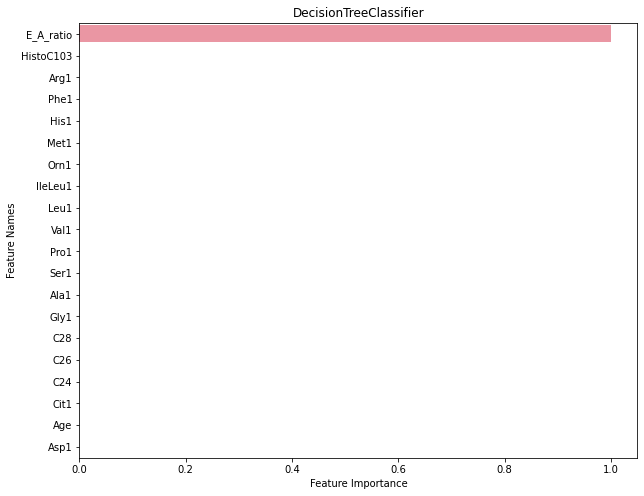

Top 10 features: ['E_A_ratio', 'MV_A_peak__m_s', 'HbA1c', 'HistoC163', 'MV_E_peak__m_s', 'HistoC14NDOHC12NDDC', 'Hips_Circumference__cm', 'C201', 'HistoC6', 'Pro1']


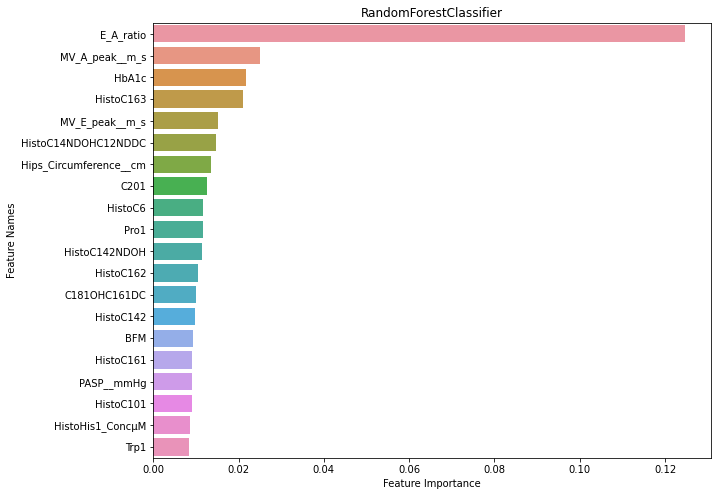

Top 10 features: ['E_A_ratio', 'C201', 'HistoC18NDOHC16NDDC', 'C141', 'HistoC22', 'C18OHC16DC', 'Dyslipidemia__Yes_1_No_0', 'Gender_Male_0_Female_1', 'Weightkg', 'C22']


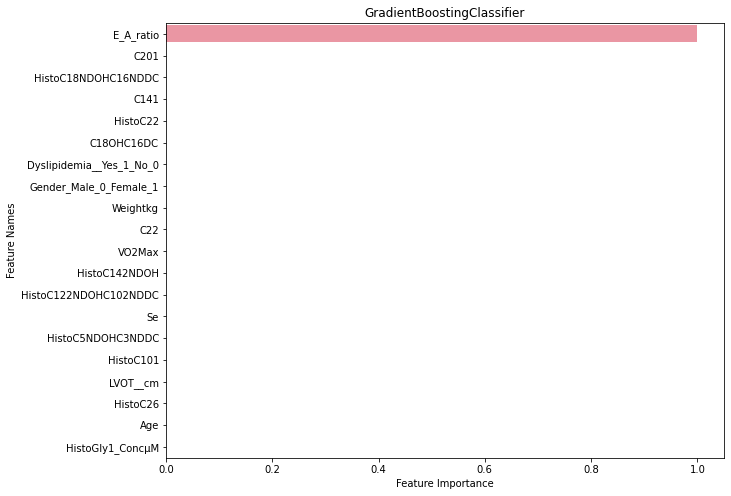

Top 10 features: ['E_A_ratio', 'HistoC103', 'Arg1', 'Phe1', 'His1', 'Met1', 'Orn1', 'IleLeu1', 'Leu1', 'Val1']


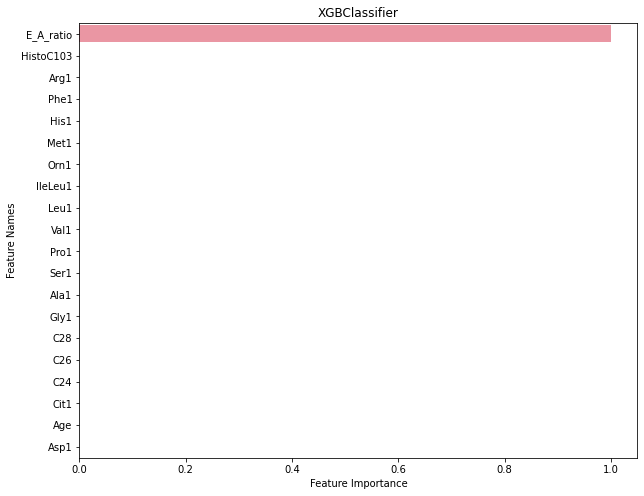

Top 10 features: ['E_A_ratio', 'LVIDD_cm', 'C28', 'MV_A_peak__m_s', 'HistoC20', 'HistoC161', 'WHR', 'Cit1', 'Hips_Circumference__cm', 'PASP__mmHg']


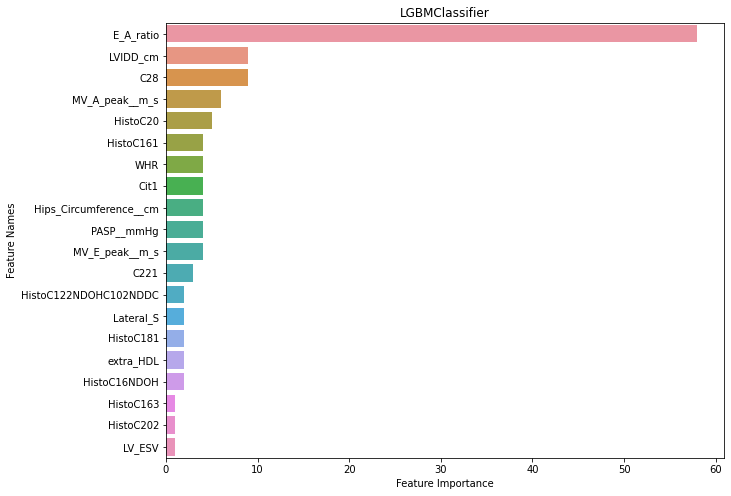

                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.454545           0.56     0.663325
0                  GaussianNB       0.590909           0.61     0.624500
0        KNeighborsClassifier       0.409091           0.31     0.830662
0      DecisionTreeClassifier       1.000000           1.00    -0.000000
0      RandomForestClassifier       0.818182           0.73     0.519615
0  GradientBoostingClassifier       1.000000           1.00    -0.000000
0               XGBClassifier       1.000000           1.00    -0.000000
0              LGBMClassifier       1.000000           0.54     0.678233
0                         SVC       0.454545           0.54     0.678233


Highest Accuracy Score: DecisionTreeClassifier. Score: 1.0
Highest CV Score: DecisionTreeClassifier. Score: 1.0
Lowest CV Error: DecisionTreeClassifier. Score: -0.0




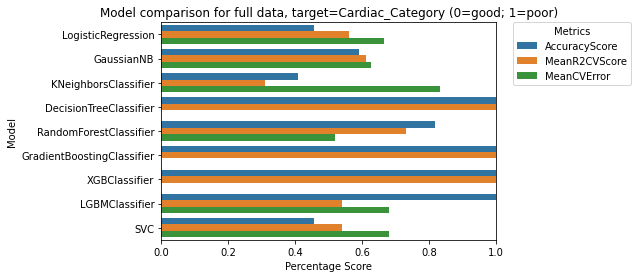

***********************************************


,Model,AccuracyScore,MeanR2CVScore,MeanCVError
0,LogisticRegression,0.454545,0.56,0.663325
0,GaussianNB,0.590909,0.61,0.624500
0,KNeighborsClassifier,0.409091,0.31,0.830662
0,DecisionTreeClassifier,1.000000,1.00,-0.000000
0,RandomForestClassifier,0.818182,0.73,0.519615
0,GradientBoostingClassifier,1.000000,1.00,-0.000000
0,XGBClassifier,1.000000,1.00,-0.000000
0,LGBMClassifier,1.000000,0.54,0.678233
0,SVC,0.454545,0.54,0.678233


In [17]:
# Cell 8
# Using full data to classify cardiac category

targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModel(data_full,targetFeat,title=f"Model comparison for full data, target={targetFeat}",showImportance = True)


Comparing models for Model comparison without E_A_ratio, target='Cardiac_Category (0=good; 1=poor)''
Initialising models...
Top 10 features: ['MV_A_peak__m_s', 'MV_E_peak__m_s', 'Weightkg', 'extra_creatinine', 'LVPWD_cm', 'LVEF', 'WHR', 'C101', 'Phe1', 'His1']


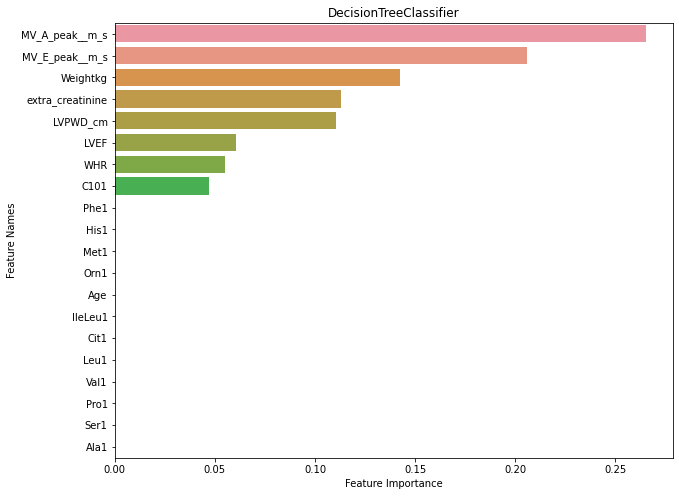

Top 10 features: ['MV_A_peak__m_s', 'MV_E_peak__m_s', 'HistoC162', 'HistoC143NDOHC123NDDC', 'HistoC12NDOHC10NDDC', 'HistoC181', 'HbA1c', 'Hips_Circumference__cm', 'VO2Max', 'Cit1']


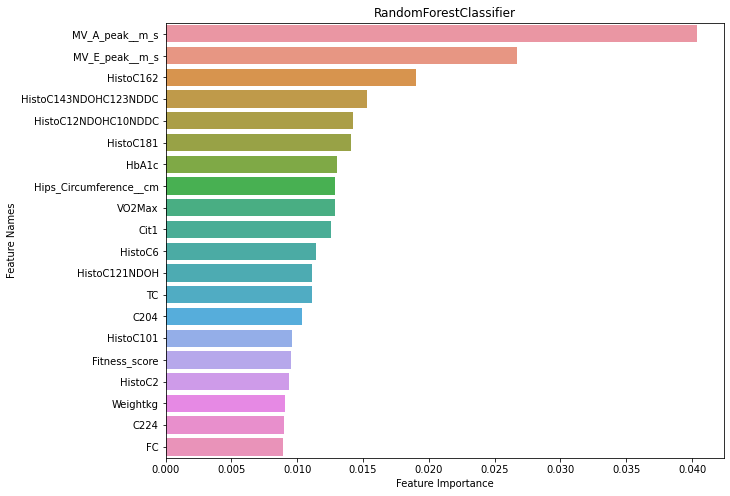

Top 10 features: ['MV_A_peak__m_s', 'MV_E_peak__m_s', 'Weightkg', 'extra_creatinine', 'VO2Max', 'LVPWD_cm', 'HistoC143', 'LVPWS_cm', 'Gripmax', 'G2L']


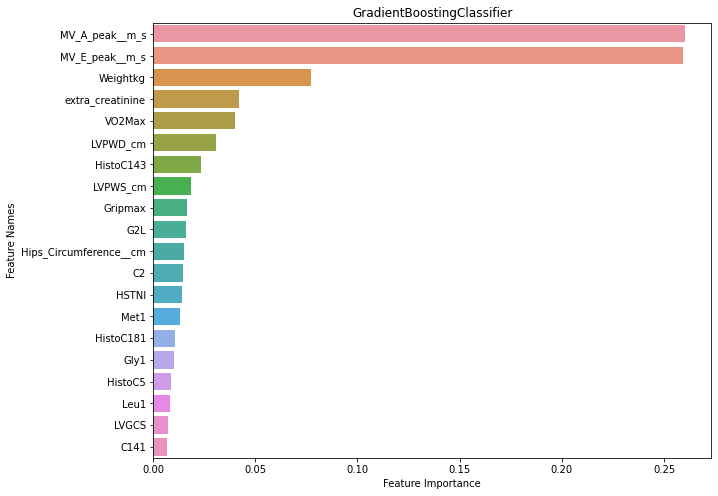

Top 10 features: ['Weightkg', 'Hips_Circumference__cm', 'HSTNI', 'HistoC162', 'IVSD__cm', 'VO2Max', 'HistoGly1_ConcµM', 'MV_A_peak__m_s', 'HistoC103', 'Met1']


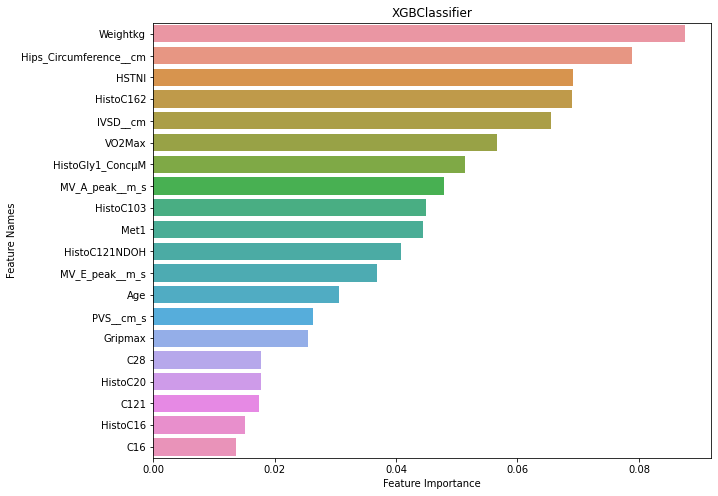

Top 10 features: ['MV_A_peak__m_s', 'MV_E_peak__m_s', 'Cit1', 'HistoC20', 'HistoC143NDOHC123NDDC', 'HistoC8', 'LV_ESV', 'TC', 'PBF', 'extra_hsCRP']


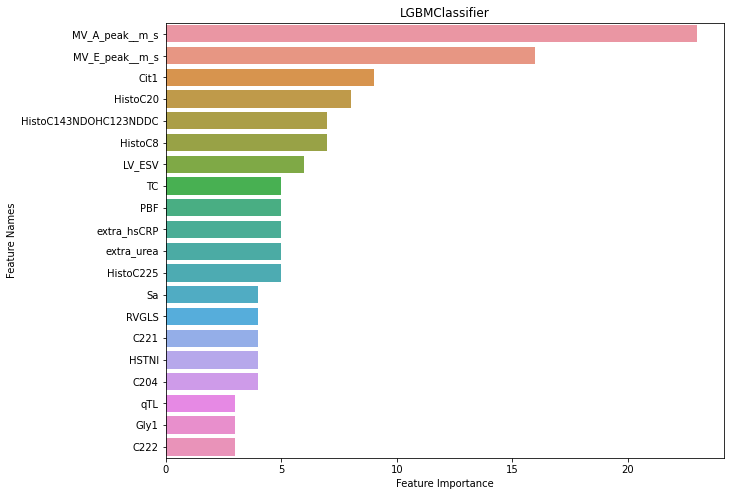

                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.409091           0.56     0.663325
0                  GaussianNB       0.545455           0.61     0.624500
0        KNeighborsClassifier       0.409091           0.31     0.830662
0      DecisionTreeClassifier       0.590909           0.68     0.565685
0      RandomForestClassifier       0.545455           0.64     0.600000
0  GradientBoostingClassifier       0.818182           0.73     0.519615
0               XGBClassifier       0.772727           0.69     0.556776
0              LGBMClassifier       0.681818           0.54     0.678233
0                         SVC       0.454545           0.54     0.678233


Highest Accuracy Score: GradientBoostingClassifier. Score: 0.82
Highest CV Score: GradientBoostingClassifier. Score: 0.73
Lowest CV Error: GradientBoostingClassifier. Score: 0.52




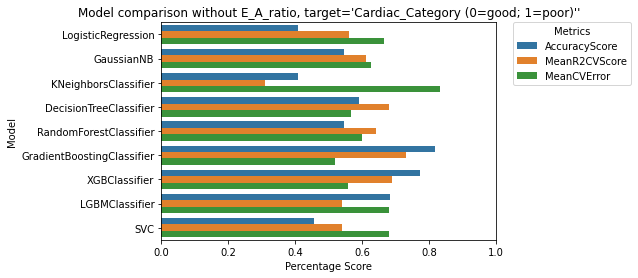

***********************************************


,Model,AccuracyScore,MeanR2CVScore,MeanCVError
0,LogisticRegression,0.409091,0.56,0.663325
0,GaussianNB,0.545455,0.61,0.624500
0,KNeighborsClassifier,0.409091,0.31,0.830662
0,DecisionTreeClassifier,0.590909,0.68,0.565685
0,RandomForestClassifier,0.545455,0.64,0.600000
0,GradientBoostingClassifier,0.818182,0.73,0.519615
0,XGBClassifier,0.772727,0.69,0.556776
0,LGBMClassifier,0.681818,0.54,0.678233
0,SVC,0.454545,0.54,0.678233


In [18]:
# Cell 10
# Use of full data EXCEPT E_A_ratio to classify cardiac cateogry. Performance worsens significantly
targetFeat = "Cardiac_Category (0=good; 1=poor)"
noEAratio = data_full.drop("E_A_ratio",axis = 1)
compareClasModel(noEAratio,targetFeat,title=f"Model comparison without E_A_ratio, target='{targetFeat}''",showImportance = True)
# Results here shows that only E_A_ratio is necessary to predict cardiac category. Other params have little relevance


In [19]:
data_trunc = data_full.drop(echoCols+cmrCols, axis=1)
data_trunc # Removal of the 2 most predictive sets of features
targetFeat = "Cardiac_Category (0=good; 1=poor)"
confusionMatrixForEachModel(data_trunc,targetFeat)

NameError: name 'confusionMatrixForEachModel' is not defined

Comparing models for Model comparison for clinParams, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.681818           0.46     0.734847
0                  GaussianNB       0.409091           0.56     0.663325
0        KNeighborsClassifier       0.636364           0.55     0.670820
0      DecisionTreeClassifier       0.454545           0.41     0.768115
0      RandomForestClassifier       0.454545           0.63     0.608276
0  GradientBoostingClassifier       0.318182           0.45     0.707107
0               XGBClassifier       0.590909           0.50     0.707107
0              LGBMClassifier       0.363636           0.54     0.678233
0                         SVC       0.590909           0.54     0.678233


Highest Accuracy Score: LogisticRegression. Score: 0.68
Highest CV Score: RandomForestClassifier. Score: 0.63
Lowest CV Error: RandomForestClassifier.

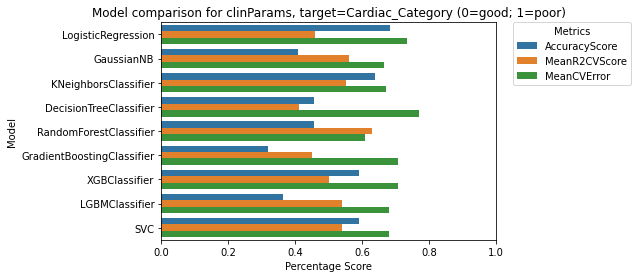

***********************************************
Comparing models for Model comparison for exercise, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.545455           0.49     0.714143
0                  GaussianNB       0.500000           0.46     0.734847
0        KNeighborsClassifier       0.636364           0.39     0.781025
0      DecisionTreeClassifier       0.590909           0.64     0.600000
0      RandomForestClassifier       0.681818           0.41     0.768115
0  GradientBoostingClassifier       0.590909           0.46     0.734847
0               XGBClassifier       0.636364           0.18     0.905539
0              LGBMClassifier       0.454545           0.54     0.678233
0                         SVC       0.454545           0.54     0.678233


Highest Accuracy Score: RandomForestClassifier. Score: 0.68
Highest CV Score: DecisionTreeClassifier. Sc

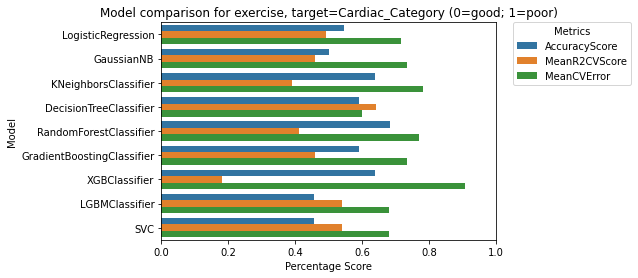

***********************************************
Comparing models for Model comparison for echo, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.681818           0.35     0.806226
0                  GaussianNB       0.772727           0.68     0.565685
0        KNeighborsClassifier       0.454545           0.55     0.670820
0      DecisionTreeClassifier       1.000000           1.00    -0.000000
0      RandomForestClassifier       1.000000           0.76     0.489898
0  GradientBoostingClassifier       1.000000           1.00    -0.000000
0               XGBClassifier       1.000000           1.00    -0.000000
0              LGBMClassifier       0.954545           0.54     0.678233
0                         SVC       0.500000           0.54     0.678233


Highest Accuracy Score: DecisionTreeClassifier. Score: 1.0
Highest CV Score: DecisionTreeClassifier. Score: 

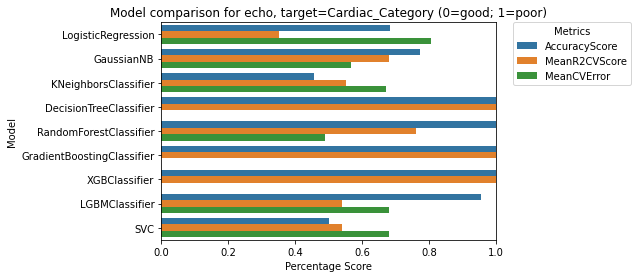

***********************************************
Comparing models for Model comparison for cmr, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.681818           0.59     0.640312
0                  GaussianNB       0.636364           0.54     0.678233
0        KNeighborsClassifier       0.545455           0.68     0.565685
0      DecisionTreeClassifier       0.727273           0.74     0.509902
0      RandomForestClassifier       0.681818           0.73     0.519615
0  GradientBoostingClassifier       0.727273           0.64     0.600000
0               XGBClassifier       0.681818           0.69     0.556776
0              LGBMClassifier       0.727273           0.54     0.678233
0                         SVC       0.636364           0.59     0.640312


Highest Accuracy Score: DecisionTreeClassifier. Score: 0.73
Highest CV Score: DecisionTreeClassifier. Score: 

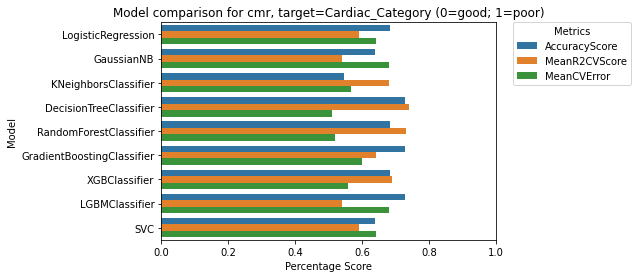

***********************************************
Comparing models for Model comparison for bloodBio, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.636364           0.77     0.479583
0                  GaussianNB       0.545455           0.64     0.600000
0        KNeighborsClassifier       0.545455           0.58     0.648074
0      DecisionTreeClassifier       0.500000           0.39     0.781025
0      RandomForestClassifier       0.545455           0.66     0.583095
0  GradientBoostingClassifier       0.454545           0.40     0.774597
0               XGBClassifier       0.363636           0.52     0.692820
0              LGBMClassifier       0.681818           0.54     0.678233
0                         SVC       0.590909           0.54     0.678233


Highest Accuracy Score: LGBMClassifier. Score: 0.68
Highest CV Score: LogisticRegression. Score: 0.77
Lo

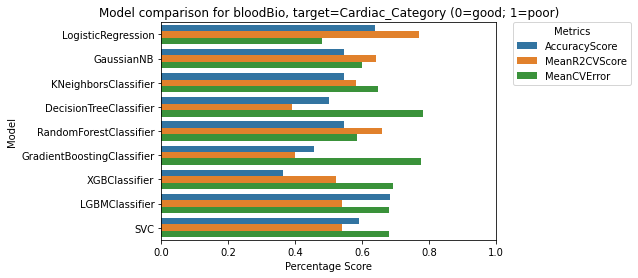

***********************************************
Comparing models for Model comparison for physFuncParams, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.636364           0.52     0.692820
0                  GaussianNB       0.409091           0.73     0.519615
0        KNeighborsClassifier       0.409091           0.73     0.519615
0      DecisionTreeClassifier       0.545455           0.53     0.685565
0      RandomForestClassifier       0.363636           0.67     0.574456
0  GradientBoostingClassifier       0.500000           0.49     0.714143
0               XGBClassifier       0.363636           0.63     0.608276
0              LGBMClassifier       0.636364           0.54     0.678233
0                         SVC       0.363636           0.54     0.678233


Highest Accuracy Score: LogisticRegression. Score: 0.64
Highest CV Score: GaussianNB. Score: 0.73


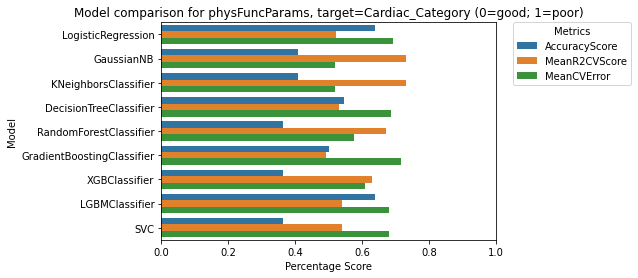

***********************************************
Comparing models for Model comparison for curMeta, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.500000           0.67     0.574456
0                  GaussianNB       0.500000           0.28     0.848528
0        KNeighborsClassifier       0.500000           0.36     0.800000
0      DecisionTreeClassifier       0.318182           0.22     0.883176
0      RandomForestClassifier       0.545455           0.23     0.877496
0  GradientBoostingClassifier       0.363636           0.22     0.883176
0               XGBClassifier       0.545455           0.37     0.793725
0              LGBMClassifier       0.500000           0.54     0.678233
0                         SVC       0.500000           0.49     0.714143


Highest Accuracy Score: RandomForestClassifier. Score: 0.55
Highest CV Score: LogisticRegression. Score: 

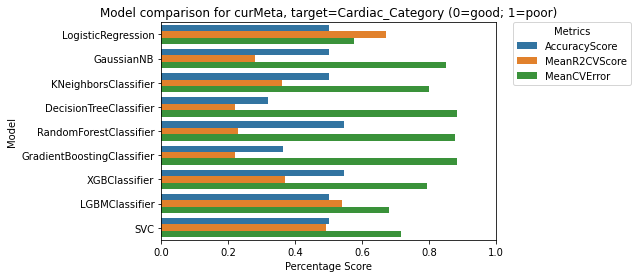

***********************************************
Comparing models for Model comparison for histMeta, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.363636           0.50     0.707107
0                  GaussianNB       0.636364           0.53     0.685565
0        KNeighborsClassifier       0.590909           0.46     0.734847
0      DecisionTreeClassifier       0.772727           0.43     0.754983
0      RandomForestClassifier       0.545455           0.62     0.616441
0  GradientBoostingClassifier       0.500000           0.43     0.754983
0               XGBClassifier       0.590909           0.53     0.685565
0              LGBMClassifier       0.545455           0.54     0.678233
0                         SVC       0.545455           0.54     0.678233


Highest Accuracy Score: DecisionTreeClassifier. Score: 0.77
Highest CV Score: RandomForestClassifier. Sc

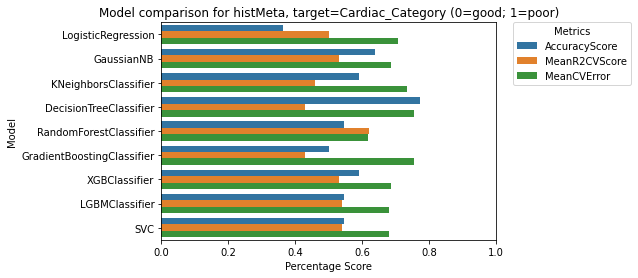

***********************************************


In [11]:
# Cell 9
warnings.filterwarnings(action='ignore', category=UserWarning)

# Use of each group of featrues to classify cardiac category

targetFeat = "Cardiac_Category (0=good; 1=poor)"
for key in cc_dfDict:
    compareClasModel(cc_dfDict[key],targetFeat,title=f"Model comparison for {key}, target={targetFeat}")

Comparing models for predicting E_A_ratio with full data
Predicting predicting E_A_ratio with full data
      feature_names  feature_importance
36   MV_A_peak__m_s            0.545294
241    HistoC16NDOH            0.196232
35   MV_E_peak__m_s            0.128819
124            C5DC            0.056258
180             C26            0.013157


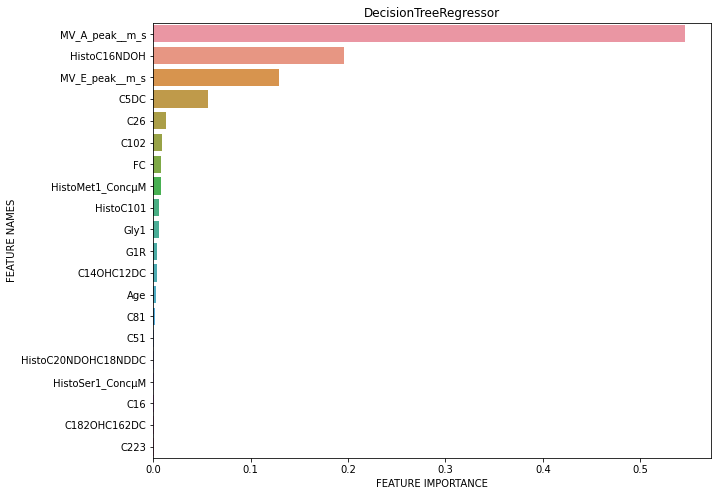

             feature_names  feature_importance
36          MV_A_peak__m_s            0.465546
35          MV_E_peak__m_s            0.104983
18                  VO2Max            0.019739
230  HistoC143NDOHC123NDDC            0.016738
63            SRe_SRaratio            0.014227


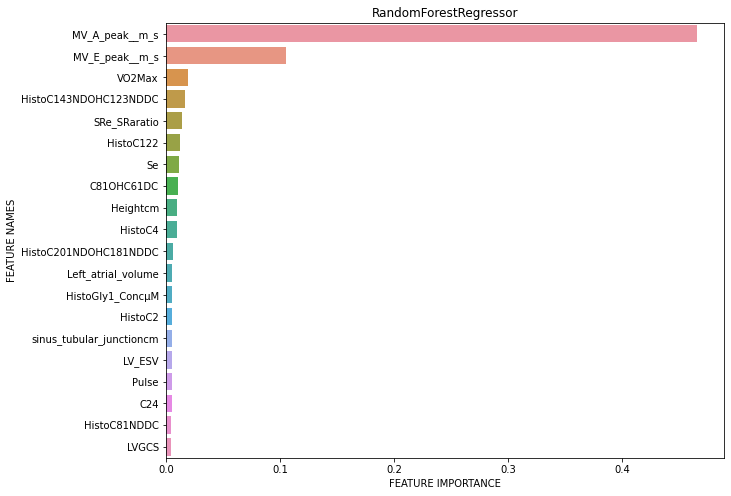

        feature_names  feature_importance
36     MV_A_peak__m_s            0.552100
35     MV_E_peak__m_s            0.216165
241      HistoC16NDOH            0.087494
125        C81OHC61DC            0.019160
280  HistoTyr1_ConcµM            0.010690


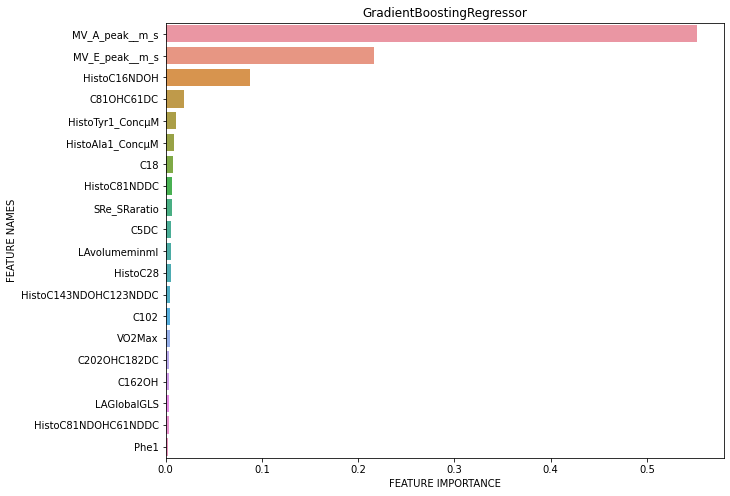

             feature_names  feature_importance
241           HistoC16NDOH            0.410457
230  HistoC143NDOHC123NDDC            0.116876
36          MV_A_peak__m_s            0.109310
77                MCP1pgmL            0.070093
37               MV_DT__ms            0.049180


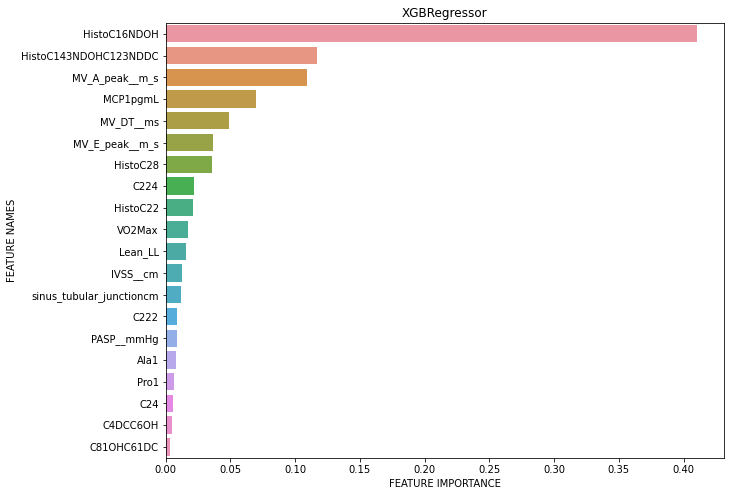

             feature_names  feature_importance
36          MV_A_peak__m_s                  23
35          MV_E_peak__m_s                  20
230  HistoC143NDOHC123NDDC                   7
132                  C81DC                   6
226              HistoC143                   6


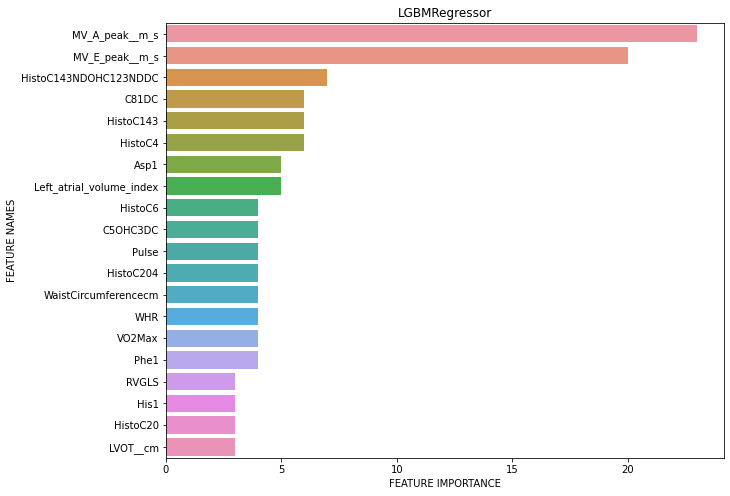

                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression     -16.447137       0.476066
0              PLSRegression      -5.725057       0.340032
0                      Ridge     -16.447044       0.476065
0                      Lasso     -26.992927       0.603711
0                 ElasticNet     -31.943195       0.630700
0        KNeighborsRegressor      -1.022298       0.350012
0      DecisionTreeRegressor     -14.612441       0.440236
0           BaggingRegressor      -1.208383       0.316846
0      RandomForestRegressor      -1.773705       0.341803
0  GradientBoostingRegressor      -1.075203       0.291730
0               XGBRegressor      -3.197770       0.409145
0              LGBMRegressor      -0.829219       0.355676
0                        SVR      -0.445836       0.349967


Highest R2CV Score: SVR. Score: -0.45
Lowest CV Error: GradientBoostingRegressor. Score: 0.29




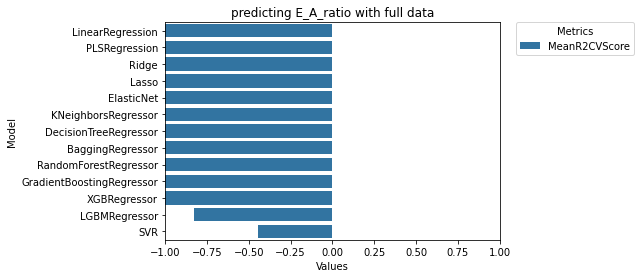

***********************************************


,Model,MeanR2CVScore
0,LinearRegression,-16.447137
0,PLSRegression,-5.725057
0,Ridge,-16.447044
0,Lasso,-26.992927
0,ElasticNet,-31.943195
0,KNeighborsRegressor,-1.022298
0,DecisionTreeRegressor,-14.612441
0,BaggingRegressor,-1.208383
0,RandomForestRegressor,-1.773705
0,GradientBoostingRegressor,-1.075203


In [15]:
# Cell 12
# Use all features tgt except cardiac category to predict E_A_ratio through regression
# Results here show that other parameters are insufficient to predict E_A_ratio 
targetFeat = "E_A_ratio"
regOnEARatio = data_full.drop("Cardiac_Category (0=good; 1=poor)",axis = 1)

compareRegModel(regOnEARatio,targetFeat,title="predicting E_A_ratio with full data",showImportance = True)


Comparing models for Cardiac category with echo
Predicting Cardiac category with echo
                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression      -8.291304       1.496730
0              PLSRegression      -0.450084       0.583698
0                      Ridge      -3.305939       1.006642
0                      Lasso      -0.524034       0.599301
0                 ElasticNet      -0.843139       0.659095
0        KNeighborsRegressor      -0.152000       0.521153
0      DecisionTreeRegressor       1.000000      -0.000000
0           BaggingRegressor       0.469333       0.350286
0      RandomForestRegressor       0.920543       0.140029
0  GradientBoostingRegressor       1.000000       0.000013
0               XGBRegressor       1.000000       0.000201
0              LGBMRegressor      -0.105284       0.505290
0                        SVR      -0.549408       0.604434


Highest R2CV Score: DecisionTreeRegressor. Score: 1.0
Lowest CV Error: DecisionTreeReg

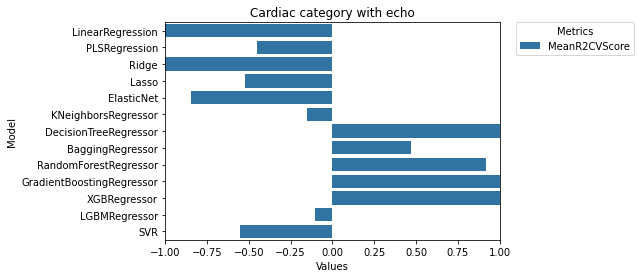

***********************************************


,Model,MeanR2CVScore
0,LinearRegression,-8.291304
0,PLSRegression,-0.450084
0,Ridge,-3.305939
0,Lasso,-0.524034
0,ElasticNet,-0.843139
0,KNeighborsRegressor,-0.152000
0,DecisionTreeRegressor,1.000000
0,BaggingRegressor,0.469333
0,RandomForestRegressor,0.920543
0,GradientBoostingRegressor,1.000000


In [14]:
# Cell 11
# Predicting cardiac cateogory with regression methods using echo params. 
# Demonstrate that regression methods are also useful in prediction
compareRegModel(cc_dfDict["echo"],"Cardiac_Category (0=good; 1=poor)",title="Cardiac category with echo",showImportance=False)

Comparing models for LVEF using physFuncParamsCols
Predicting LVEF using physFuncParamsCols
   feature_names  feature_importance
1            G1L            0.240008
14       Lean_RL            0.169822
10           BMR            0.153406
2            G2L            0.104795
4            G2R            0.103295


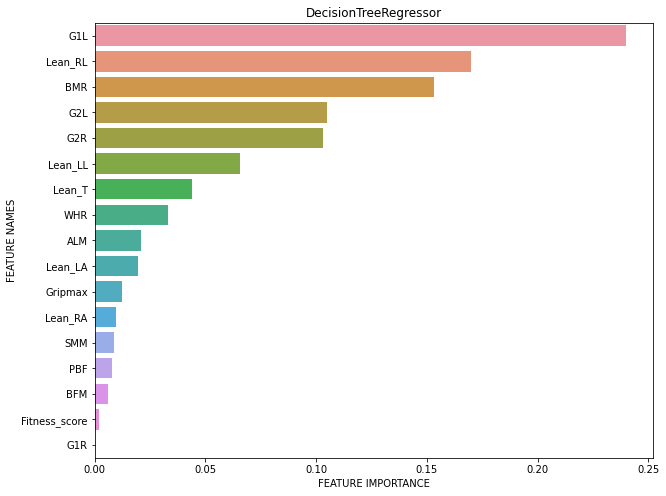

   feature_names  feature_importance
4            G2R            0.113192
9  Fitness_score            0.087380
7            PBF            0.076449
2            G2L            0.069341
6            BFM            0.068221


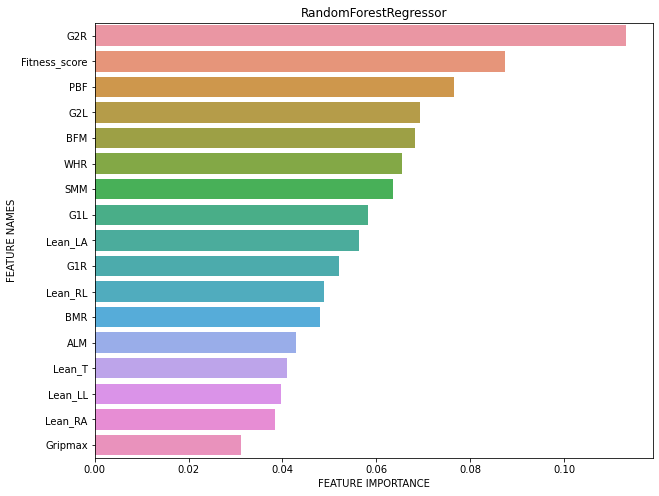

   feature_names  feature_importance
1            G1L            0.145391
5            SMM            0.099611
13       Lean_LL            0.099595
7            PBF            0.083905
2            G2L            0.079643


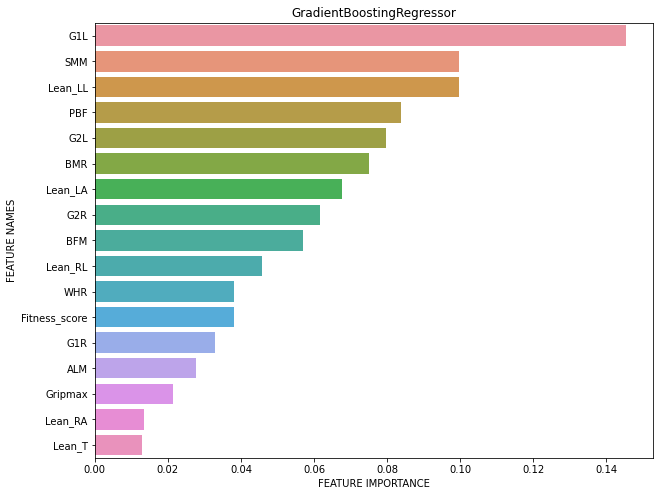

   feature_names  feature_importance
16           ALM            0.176009
15        Lean_T            0.151248
14       Lean_RL            0.132927
7            PBF            0.098546
10           BMR            0.095847


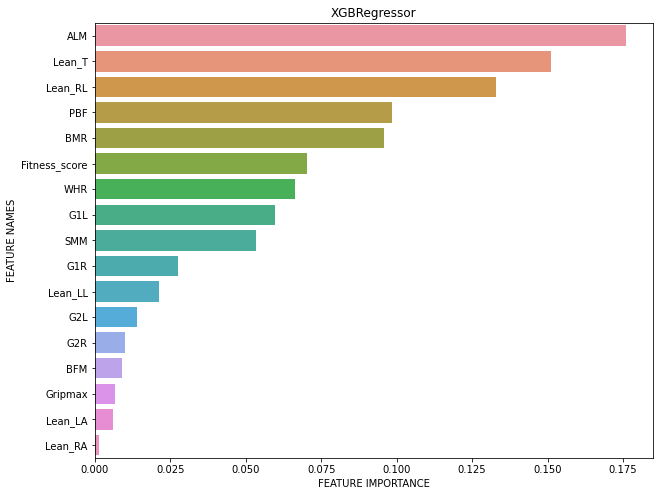

   feature_names  feature_importance
1            G1L                  25
4            G2R                  22
2            G2L                  15
7            PBF                  14
9  Fitness_score                  13


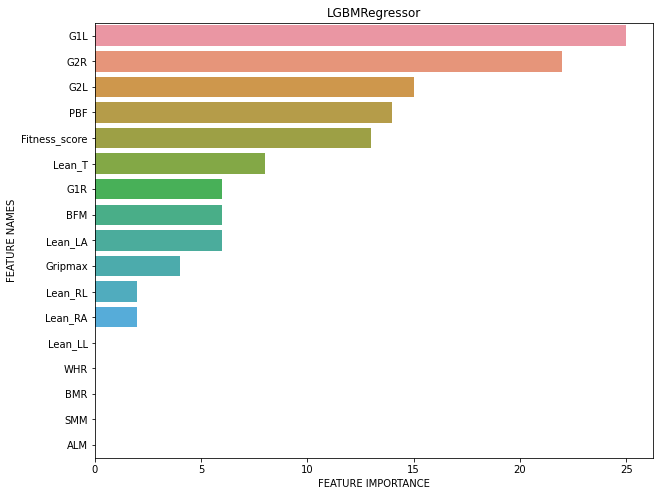

                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression    -141.643312      60.268071
0              PLSRegression      -1.165972       9.220132
0                      Ridge      -4.650870      13.442243
0                      Lasso      -4.567326      12.931992
0                 ElasticNet      -4.767279      13.340798
0        KNeighborsRegressor      -0.610478       7.814793
0      DecisionTreeRegressor      -2.483624      11.468083
0           BaggingRegressor      -0.428481       7.691354
0      RandomForestRegressor      -0.633695       7.810748
0  GradientBoostingRegressor      -1.046094       8.627741
0               XGBRegressor      -1.037528       8.603921
0              LGBMRegressor      -0.131926       7.195193
0                        SVR      -0.149191       7.348617


Highest R2CV Score: LGBMRegressor. Score: -0.13
Lowest CV Error: LGBMRegressor. Score: 7.2




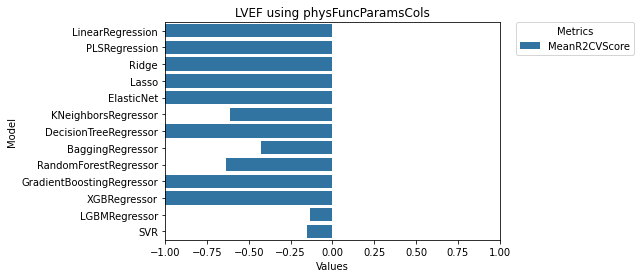

***********************************************
Comparing models for E_A_ratio using physFuncParamsCols
Predicting E_A_ratio using physFuncParamsCols
  feature_names  feature_importance
2           G2L            0.379393
8           WHR            0.335086
6           BFM            0.098398
4           G2R            0.038248
1           G1L            0.037635


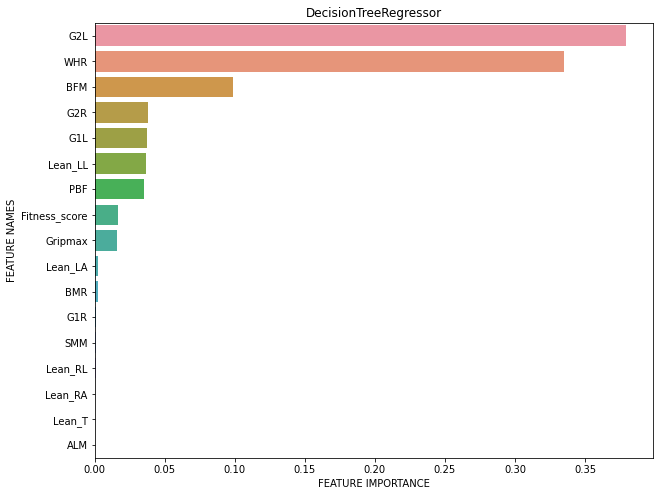

  feature_names  feature_importance
8           WHR            0.196441
7           PBF            0.125523
6           BFM            0.108209
2           G2L            0.100833
1           G1L            0.068552


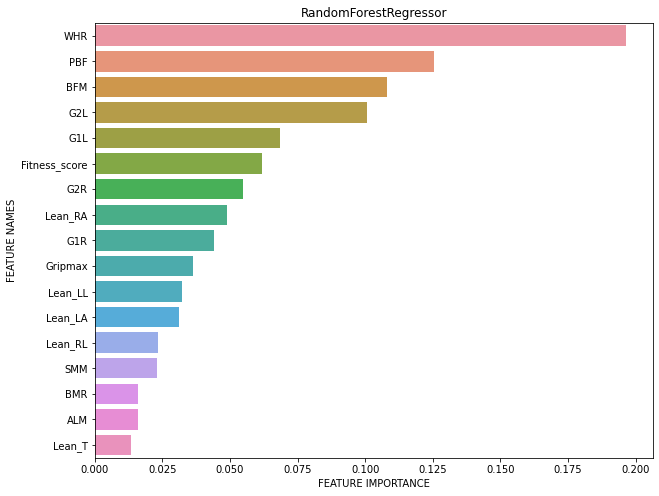

  feature_names  feature_importance
8           WHR            0.228516
2           G2L            0.215569
4           G2R            0.102338
1           G1L            0.088883
6           BFM            0.078107


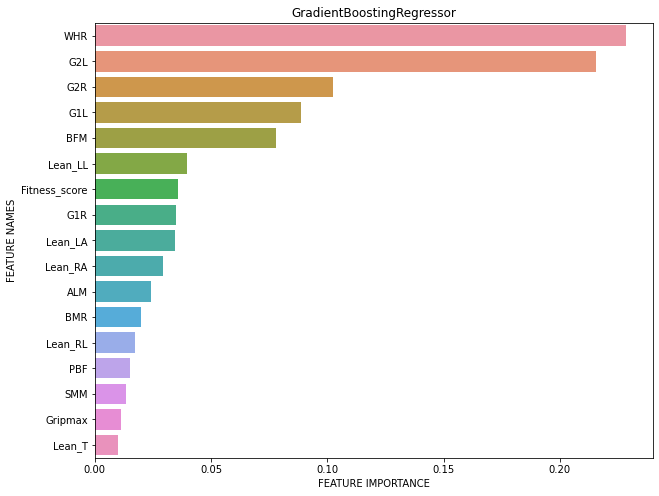

   feature_names  feature_importance
8            WHR            0.428150
2            G2L            0.127935
13       Lean_LL            0.097695
4            G2R            0.070806
12       Lean_RA            0.061096


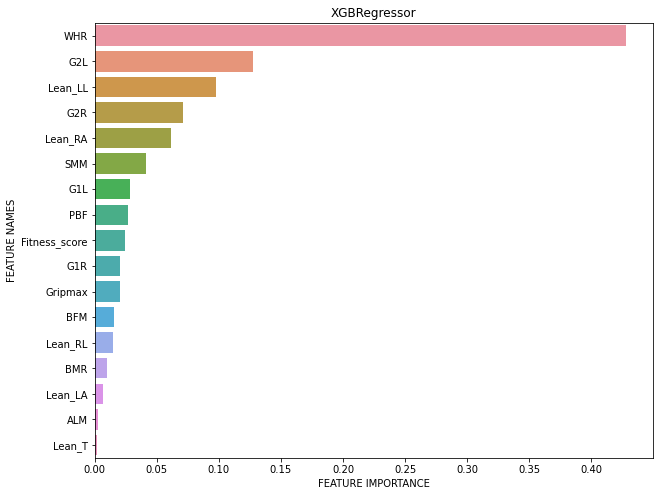

  feature_names  feature_importance
2           G2L                  23
1           G1L                  21
8           WHR                  20
4           G2R                  10
7           PBF                  10


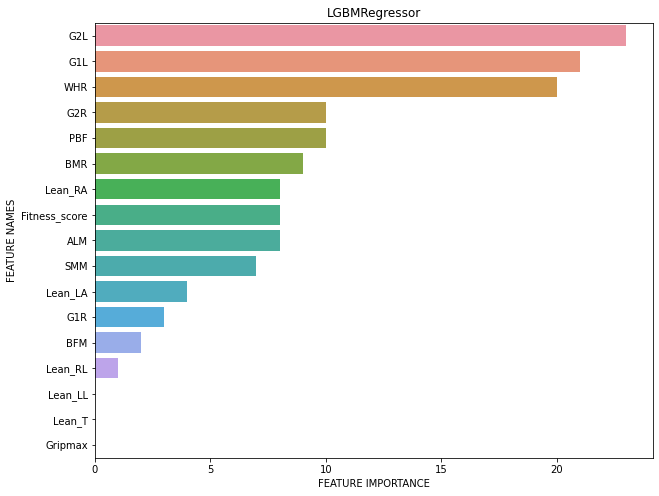

                       Model  MeanR2CVScore  MeanR2CVError
0           LinearRegression -537051.349666     121.366646
0              PLSRegression     -10.186138       0.413199
0                      Ridge     -49.669986       1.131993
0                      Lasso      -7.197342       0.362123
0                 ElasticNet      -7.915685       0.385541
0        KNeighborsRegressor     -11.374406       0.403204
0      DecisionTreeRegressor     -11.879152       0.526562
0           BaggingRegressor      -8.512666       0.407048
0      RandomForestRegressor      -9.442160       0.416582
0  GradientBoostingRegressor     -10.793473       0.471810
0               XGBRegressor     -12.384297       0.509520
0              LGBMRegressor      -0.829219       0.355676
0                        SVR      -3.724190       0.360071


Highest R2CV Score: LGBMRegressor. Score: -0.83
Lowest CV Error: LGBMRegressor. Score: 0.36




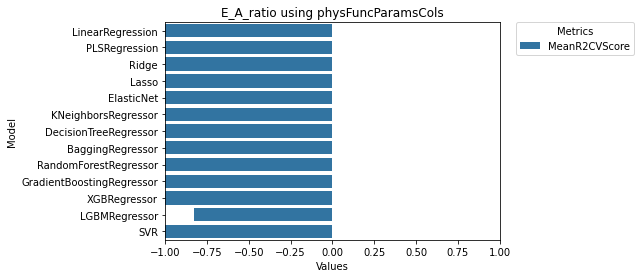

***********************************************


,Model,MeanR2CVScore
0,LinearRegression,-537051.349666
0,PLSRegression,-10.186138
0,Ridge,-49.669986
0,Lasso,-7.197342
0,ElasticNet,-7.915685
0,KNeighborsRegressor,-11.374406
0,DecisionTreeRegressor,-11.879152
0,BaggingRegressor,-8.512666
0,RandomForestRegressor,-9.442160
0,GradientBoostingRegressor,-10.793473


In [16]:
# Cell 13
# Attempting to predict LVEF and E_A_ratio using physical functional parameters through regression

#regData1 = data[physFuncParamsCols + ["LVEF"]]
#regData2 = data[physFuncParamsCols + ["E_A_ratio"]]
compareRegModel(regData1,"LVEF",title="LVEF using physFuncParamsCols", showImportance=True)
compareRegModel(regData2,"E_A_ratio",title="E_A_ratio using physFuncParamsCols", showImportance=True)


Comparing models for Model comparison for curated data, target=Cardiac_Category (0=good; 1=poor)
Initialising models...
                        Model  AccuracyScore  MeanR2CVScore  MeanCVError
0          LogisticRegression       0.545455           0.35     0.806226
0                  GaussianNB       0.500000           0.45     0.741620
0        KNeighborsClassifier       0.500000           0.50     0.707107
0      DecisionTreeClassifier       0.500000           0.26     0.860233
0      RandomForestClassifier       0.545455           0.34     0.812404
0  GradientBoostingClassifier       0.454545           0.49     0.714143
0               XGBClassifier       0.454545           0.44     0.748331
0              LGBMClassifier       0.500000           0.54     0.678233
0                         SVC       0.500000           0.54     0.678233


Highest Accuracy Score: LogisticRegression. Score: 0.55
Highest CV Score: LGBMClassifier. Score: 0.54
Lowest CV Error: LGBMClassifier. Score: 0.68



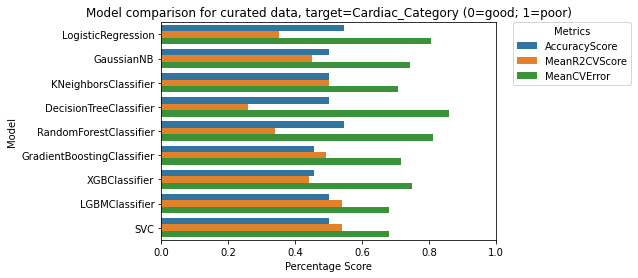

***********************************************


,Model,AccuracyScore,MeanR2CVScore,MeanCVError
0,LogisticRegression,0.545455,0.35,0.806226
0,GaussianNB,0.500000,0.45,0.741620
0,KNeighborsClassifier,0.500000,0.50,0.707107
0,DecisionTreeClassifier,0.500000,0.26,0.860233
0,RandomForestClassifier,0.545455,0.34,0.812404
0,GradientBoostingClassifier,0.454545,0.49,0.714143
0,XGBClassifier,0.454545,0.44,0.748331
0,LGBMClassifier,0.500000,0.54,0.678233
0,SVC,0.500000,0.54,0.678233


In [8]:
# Cell 15
# Manually combine most important features
mostImptCols = ["VO2Max","HistoC162","C5OHC3DC","WHR","HistoC163NDOHC143NDDC","HistoHis1_ConcµM","C222","Pulse","Hips_Circumference__cm","Cit1","qTL","HistoC16","Cardiac_Category (0=good; 1=poor)"]
curatedDf = data_full[mostImptCols]

# Scores got even worse
targetFeat = "Cardiac_Category (0=good; 1=poor)"
compareClasModel(curatedDf,targetFeat,title=f"Model comparison for curated data, target='{targetFeat}''")

In [74]:
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[selfMadeCols]

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=1,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

model = RandomForestClassifier(random_state=1,verbose=False).fit(xTrain,yTrain)

yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
xImputed = x.fillna(x.median())
cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvAccuracyScore = cvAccuracyScoreArray.mean()
#cvRocAucScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='roc_auc').mean()
#cvRecallScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='recall').mean()
#cvPrecisionScore = cross_val_score(model,xTest,yTest,cv=cv,scoring='precision').mean()
#cvF1Score = cross_val_score(model,xTest,yTest,cv=cv,scoring='f1').mean()

print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
cvAccuracyScoreArray

Preprocessing dataframe...
Converting values that are non-numeric AND non-binary to NaN...
Number of columns having more than 40 percent missing values:  0
These columns are:
 []
Columns with missing values (%):
C28      13.95
C102      6.98
WHR       5.81
HSTNI     4.65
qTL       1.16
C101      1.16
C222      1.16
dtype: float64
Original Shape:(86, 31)
Final Shape:(86, 31)
______________________________
Initialising models...
Accuracy: 0.6923076923076923
Predictions: 
[0 1 1 1 1 1 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 0 1 1]
Answers: 
[0 1 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 1 0 0 0 1 1 0]
cvAccuracyScore: 0.678169934640523


array([0.77777778, 0.64705882, 0.52941176, 0.70588235, 0.76470588,
       0.66666667, 0.52941176, 0.64705882, 0.58823529, 0.52941176,
       0.55555556, 0.70588235, 0.64705882, 0.82352941, 0.76470588,
       0.61111111, 0.82352941, 0.76470588, 0.64705882, 0.82352941,
       0.61111111, 0.88235294, 0.64705882, 0.70588235, 0.64705882,
       0.72222222, 0.94117647, 0.64705882, 0.58823529, 0.41176471,
       0.55555556, 0.64705882, 0.88235294, 0.64705882, 0.64705882,
       0.55555556, 0.64705882, 0.58823529, 0.58823529, 0.76470588,
       0.72222222, 0.70588235, 0.70588235, 0.88235294, 0.70588235,
       0.77777778, 0.58823529, 0.64705882, 0.64705882, 0.64705882])

In [57]:
mostImptCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
curatedDf = data_full[mostImptCols]


targetFeat = "Cardiac_Category (0=good; 1=poor)"
plotAOCForSVM(curatedDf,targetFeat)

KeyError: "None of [Int64Index([11, 13, 16, 18, 19, 21, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,\n            35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,\n            52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68,\n            69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,\n            85],\n           dtype='int64')] are in the [columns]"

In [25]:
# Cell 16
# Grid Search for tuning LGBM to predict E_A_Ratio using physical functional params
df = regData2
target = "E_A_ratio"
params = {"n_estimators": [50,100, 500],
          "subsample": [0.2,0.4, 0.6, 0.8, 1.0],
          "max_depth": [2, 3, 4, 5],
          "learning_rate": [0.1, 0.01, 0.02, 0.05],
          "min_child_samples": [5, 10, 20, 40]}
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df)

#print("Predicting " + title)
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.25,random_state=1)  
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
lgbmr = LGBMRegressor().fit(xTrain,yTrain)
cv = GridSearchCV(lgbmr,params,cv=5,verbose=1,n_jobs=-1,scoring="r2").fit(xTrain,yTrain)
print(cv.best_params_)
print(cv.best_score_)

Fitting 5 folds for each of 960 candidates, totalling 4800 fits
{'learning_rate': 0.01, 'max_depth': 2, 'min_child_samples': 5, 'n_estimators': 100, 'subsample': 0.2}
0.0706065044524327


In [26]:
# Cell 17
# Hyperparameter tuning for random forest using grid search

df = regData2
target = "E_A_ratio"
params = {
    'bootstrap': [True],
    'max_depth': [80,100, 120, 150],
    'max_features': [2, 3, 4, 5],
    'min_samples_leaf': [3, 4, 5, 6,7,8],
    'min_samples_split': [14,16,18,20],
    'n_estimators': [5,10,25]
}
y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df)

#print("Predicting " + title)
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.25,random_state=1)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
rf = RandomForestRegressor().fit(xTrain,yTrain)
# Instantiate the grid search model
cv = GridSearchCV(rf,params,cv = 5, n_jobs = -1, verbose = 2,scoring="r2").fit(xTrain,yTrain)

print(cv.best_params_)
print(cv.best_score_)

Fitting 5 folds for each of 1152 candidates, totalling 5760 fits
{'bootstrap': True, 'max_depth': 120, 'max_features': 4, 'min_samples_leaf': 8, 'min_samples_split': 16, 'n_estimators': 10}
0.15674596450999442


In [ ]:
# ARBITRARILY SELF MADE COLUMNS
# selfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
"""
selfMadeCols = ["WaistCircumferencecm","Hips_Circumference__cm","C28","Trp1","HistoC101","HistoC143NDOHC123NDDC","HistoC162","HistoC163","HistoC142","HistoC141","HistoC143","HistoHis1_ConcµM","HistoC225","HistoC203","HistoC182","HistoC181","Cardiac_Category (0=good; 1=poor)"]
target = "Cardiac_Category (0=good; 1=poor)"
df = data_full[selfMadeCols]

y = df[target]
df = df.drop(target, axis = 1)
x = preprocessDf(df,verbose=True)

print("Initialising models...")
xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.3,random_state=1,stratify=y)
xTrain = xTrain.fillna(xTrain.median())
xTest = xTest.fillna(xTrain.median())
#https://stackoverflow.com/questions/18689823/pandas-dataframe-replace-nan-values-with-average-of-columns

model = RandomForestClassifier(random_state=1,verbose=False).fit(xTrain,yTrain)

yPred = model.predict(xTest)
accuracy = accuracy_score(yTest,yPred)

cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=10, random_state=1)
xImputed = x.fillna(x.median())
cvAccuracyScoreArray = cross_val_score(model,xImputed,y,cv=cv,scoring='accuracy')
cvAccuracyScore = cvAccuracyScoreArray.mean()
#cvRocAucScore = cross_val_score(model,xImputed,y,cv=cv,scoring='roc_auc').mean()
#cvRecallScore = cross_val_score(model,xImputed,y,cv=cv,scoring='recall').mean()
#cvPrecisionScore = cross_val_score(model,xImputed,y,cv=cv,scoring='precision').mean()
#cvF1Score = cross_val_score(model,xImputed,y,cv=cv,scoring='f1').mean()

print(f"Accuracy: {accuracy}")
print("Predictions: ")
print(yPred)
print(f"Answers: ")
print(yTest.to_numpy())


print(f"cvAccuracyScore: {cvAccuracyScore}")
cvAccuracyScoreArray
"""

In [ ]:
compareFinalClasModelVer(featureEngineeredDf,targetFeat,title=f"Comparison of best models for Feature-Engineered Dataset, target={targetFeat}",key="Feature-Engineered Dataset (RandomForest vs TPOT's Model)",saveFile=False,showImportance=True)
